In [1]:
import warnings
warnings.simplefilter(action='ignore', category=UserWarning)

import os
import random

import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
from scipy.stats import skew, kurtosis

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import roc_auc_score, mean_squared_error
from sklearn.decomposition import PCA

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Dropout, GaussianDropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.regularizers import L1, L2

import lightgbm as lgb

import sys
sys.path.append('../input/moa-models-and-packages/site-packages')
from gauss_rank_scaler import GaussRankScaler

SEED = 721991

def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)    
    tf.random.set_seed(seed)

## **1. Introduction**

### **1.1. Mechanisms of Action**

**[("Mechanism of action", n.d.)](https://en.wikipedia.org/wiki/Mechanism_of_action)**

In pharmacology, the term **Mechanism of Action** (MoA) refers to the specific biochemical interaction through which a drug substance produces its pharmacological effect. A mechanism of action usually includes mention of the specific molecular targets to which the drug binds, such as an enzyme or receptor. Receptor sites have specific affinities for drugs based on the chemical structure of the drug, as well as the specific action that occurs there.

In this competition, the task is predicting multiple targets of the Mechanism of Action (MoA) responses of different samples. Samples are drugs profiled at different time points and doses, and there are more than 5,000 drugs in dataset. Dataset also consists of various group of features and there are more than two hundred targets of enzymes and receptors.

In [2]:
df_train = pd.read_csv('../input/lish-moa/train_features.csv')
df_test = pd.read_csv('../input/lish-moa/test_features.csv')

df_train_targets_scored = pd.read_csv('../input/lish-moa/train_targets_scored.csv')
df_train_targets_nonscored = pd.read_csv('../input/lish-moa/train_targets_nonscored.csv')
df_test_targets = pd.read_csv('../input/lish-moa/sample_submission.csv')

target_features_scored = list(df_train_targets_scored.columns[1:])
target_features_nonscored = list(df_train_targets_nonscored.columns[1:])
df_train_targets_scored[target_features_scored] = df_train_targets_scored[target_features_scored].astype(np.uint8)
df_train_targets_nonscored[target_features_nonscored] = df_train_targets_nonscored[target_features_nonscored].astype(np.uint8)
df_test_targets[target_features_scored] = df_test_targets[target_features_scored].astype(np.float32)

df_train = df_train.merge(df_train_targets_scored, on='sig_id', how='left')
df_train = df_train.merge(df_train_targets_nonscored, on='sig_id', how='left')
df_test = df_test.merge(df_test_targets, on='sig_id', how='left')

del df_train_targets_scored, df_train_targets_nonscored, df_test_targets

print(f'Training Set Shape = {df_train.shape}')
print(f'Training Set Memory Usage = {df_train.memory_usage().sum() / 1024 ** 2:.2f} MB')
print(f'Test Set Shape = {df_test.shape}')
print(f'Test Set Memory Usage = {df_test.memory_usage().sum() / 1024 ** 2:.2f} MB')

Training Set Shape = (23814, 1484)
Training Set Memory Usage = 173.15 MB
Test Set Shape = (3982, 1082)
Test Set Memory Usage = 29.77 MB


### **1.2. Features**

* `sig_id` is the unique sample id
* Features with `g-` prefix are gene expression features and there are 772 of them (from `g-0` to `g-771`)
* Features with `c-` prefix are cell viability features and there are 100 of them (from `c-0` to `c-99`)
* `cp_type` is a binary categorical feature which indicates the samples are treated with a compound or with a control perturbation (`trt_cp` or `ctl_vehicle`)
* `cp_time` is a categorical feature which indicates the treatment duration (`24`, `48` or `72` hours)
* `cp_dose` is a binary categorical feature which indicates the dose is low or high (`D1` or `D2`)

In [3]:
g_features = [feature for feature in df_train.columns if feature.startswith('g-')]
c_features = [feature for feature in df_train.columns if feature.startswith('c-')]
other_features = [feature for feature in df_train.columns if feature not in g_features and 
                                                             feature not in c_features and 
                                                             feature not in target_features_scored and
                                                             feature not in target_features_nonscored]

print(f'Number of g- Features: {len(g_features)}')
print(f'Number of c- Features: {len(c_features)}')
print(f'Number of Other Features: {len(other_features)} ({other_features})')

Number of g- Features: 772
Number of c- Features: 100
Number of Other Features: 4 (['sig_id', 'cp_type', 'cp_time', 'cp_dose'])


There are two groups of target features; scored target features and non-scored target features. Both of those groups consist of binary MoA targets but only the first group is used for the scoring, so this is a multi-label classification problem. Even though non-scored target features don't have any impact on the score, they can be useful.

In [4]:
print(f'Number of Scored Target Features: {len(target_features_scored)}')
print(f'Number of Non-scored Target Features: {len(target_features_nonscored)}')

Number of Scored Target Features: 206
Number of Non-scored Target Features: 402


## **2. Objective and Metric**

This is a multi-label binary classification problem, and metric used for the evaluation is mean columnwise log loss. For every row, a probability that the sample had a positive response for each target, has to be predicted. For $N$ rows and $M$ targets, there will be $N×M$ predictions. Submissions are scored by the log loss:

$\Large \text{log loss} = - \frac{1}{M}\sum_{m=1}^{M} \frac{1}{N} \sum_{i=1}^{N} \left[ y_{i,m} \log(\hat{y}_{i,m}) + (1 - y_{i,m}) \log(1 - \hat{y}_{i,m})\right]$

* $N$ is the number of rows ($i=1,…,N$)
* $M$ is the number of targets ($m=1,…,M$)
* $\large \hat{y}_{i,m}$ is the predicted probability of the ith row and mth target
* $\large y_{i,m}$ is the ground truth of the ith row and mth target (1 for a positive response, 0 otherwise)
* $log()$ is the natural logarithm

Submitted predicted probabilities are replaced with $max(min(p,1-10^{-15}),10^{-15})$. This means that probabilities greater than 0.999999999999999, and probabilities less than 0.000000000000001 are clipped. When all of those details are added to the equation, function defined below can be used both as a metric and loss function. It should be safer to optimize competition metric directly.

In [5]:
def mean_columnwise_logloss(y_true, y_pred):        
    y_pred = np.clip(y_pred, 1e-15, (1 - 1e-15))
    score = - np.mean(np.mean(y_true * np.log(y_pred) + (1 - y_true) * np.log(1 - y_pred), axis=1))
    return score

## **3. Target Features**

Target features are categorized into two groups; scored and non-scored target features, and features in both of those groups are binary. The competition score is based on the scored target features but non-scored group can still be used for model evaluation, data analysis and feature engineering.

It is a multi-label classification problem but one sample can be classified to multiple targets or none of the targets as well. Most of the time, samples are classified to 0 or 1 target, but a small part of the training set samples are classified to 2, 3, 4, 5 and 7 different targets at the same time. Classified targets distributions are not very similar for scored targets and non-scored targets since there is a huge discrepancy of 0 and 1 classified targets.

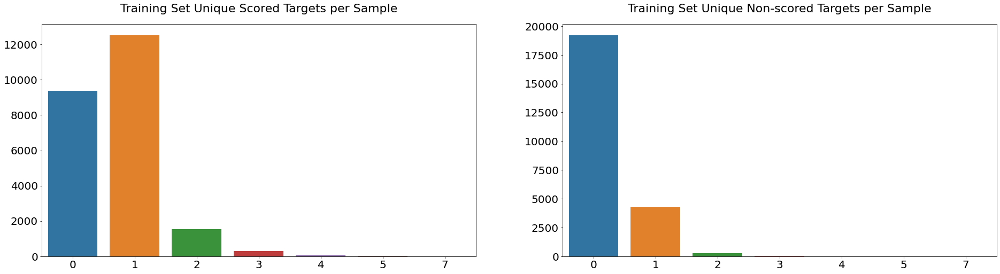

In [6]:
scored_targets_classified = df_train[target_features_scored].sum(axis=1)
nonscored_targets_classified = df_train[target_features_nonscored].sum(axis=1)

fig, axes = plt.subplots(figsize=(32, 8), ncols=2)

sns.countplot(scored_targets_classified, ax=axes[0])
sns.countplot(nonscored_targets_classified, ax=axes[1])

for i in range(2):
    axes[i].tick_params(axis='x', labelsize=20)
    axes[i].tick_params(axis='y', labelsize=20)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    
axes[0].set_title(f'Training Set Unique Scored Targets per Sample', size=22, pad=22)
axes[1].set_title(f'Training Set Unique Non-scored Targets per Sample', size=22, pad=22)

plt.show()

### **3.1. Scored Target Features**

The most commmonly classified scored targets are nfkb inhibitor, proteasome inhibitor, cyclooxygenase inhibitor, dopamine receptor antagonist, serotonin receptor antagonist and dna_inhibitor, and there are more than 400 samples classified to each of them. The most rarely classified scored targets are atp-sensitive potassium channel antagonist and erbb2 inhibitor, and there is only one sample classified to each of them. A similar classification distribution is expected in test set.

There are lots of scored targets classified with the same number of times which suggests there might be a relationship between them.

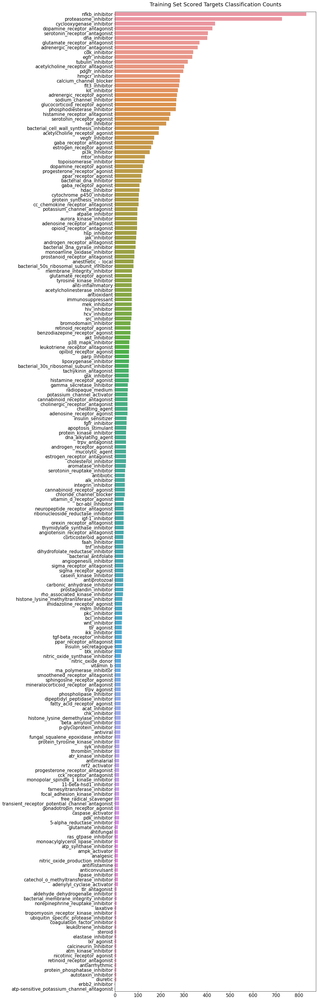

In [7]:
fig = plt.figure(figsize=(12, 60))

sns.barplot(x=df_train[target_features_scored].sum(axis=0).sort_values(ascending=False).values,
            y=df_train[target_features_scored].sum(axis=0).sort_values(ascending=False).index)

plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.xlabel('')
plt.ylabel('')
plt.title('Training Set Scored Targets Classification Counts', size=18, pad=18)

plt.show()

### **3.2. Non-scored Target Features**

The most commmonly classified non-scored targets are ace inhibitor, purinergic receptor antagonist, map kinase inhibitor, sterol demethylase inhibitor, and there are more than 70 samples classified to each of them. There are 71 non-scored targets that are classified to 0 samples. The classification counts of non-scored targets are very different than scored targets because most of the training samples are not classified to any of them.

Targets classified same number of times is more significant in non-scored targets and they are more likely to be in a relationship.

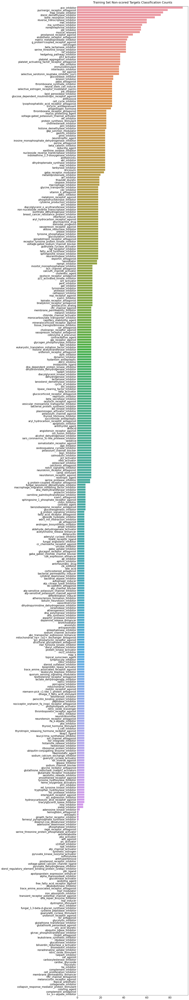

In [8]:
fig = plt.figure(figsize=(12, 110))

sns.barplot(x=df_train[target_features_nonscored].sum(axis=0).sort_values(ascending=False).values,
            y=df_train[target_features_nonscored].sum(axis=0).sort_values(ascending=False).index)

plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.xlabel('')
plt.ylabel('')
plt.title('Training Set Non-scored Targets Classification Counts', size=18, pad=18)

plt.show()

### **3.3. Target Features Correlations**

Both scored target and non-scored target correlations are very close to 0, but there are very few bright red and light red dots that are worth exploring. Those red dots may yield relationships between targets. Horizontal and vertical white lines in non-scored target correlations occur due to NaNs.

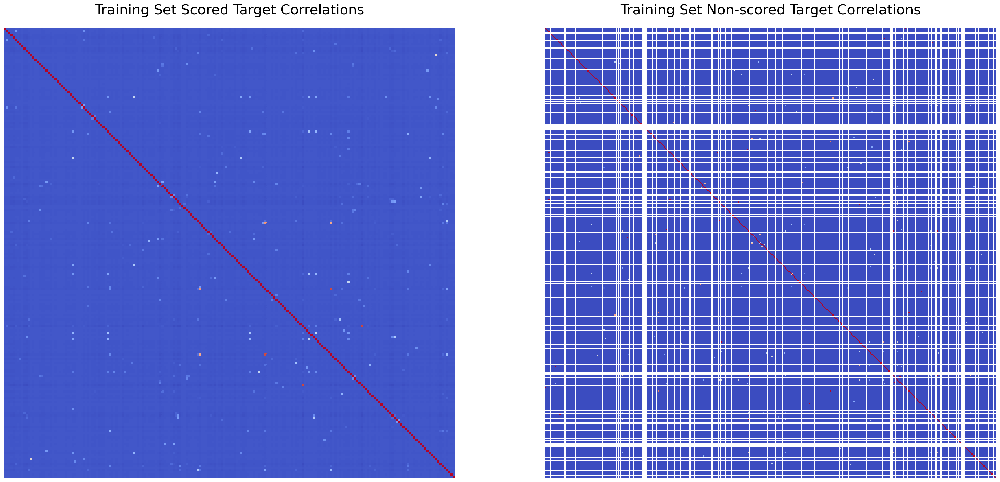

In [9]:
fig, axes = plt.subplots(figsize=(32, 15), ncols=2, dpi=150)

sns.heatmap(df_train[target_features_scored].corr(),
            annot=False,
            square=True,
            cmap='coolwarm',
            cbar=False,
            yticklabels=False,
            xticklabels=False,
            ax=axes[0])  

sns.heatmap(df_train[target_features_nonscored].corr(),
            annot=False,
            square=True,
            cmap='coolwarm',
            cbar=False,
            yticklabels=False,
            xticklabels=False,
            ax=axes[1])   

axes[0].set_title('Training Set Scored Target Correlations', size=25, pad=25)
axes[1].set_title('Training Set Non-scored Target Correlations', size=25, pad=25)

plt.show()

## **4. Categorical Features**

There are three categorical features; `cp_type`, `cp_time` and `cp_dose`. Two of them are binary features and one of them has three unique values, so the cardinality among those features, is very low.
All of the categorical features have almost identical distributions in training and public test set, and that suggests training and public test set are taken from the same sample. Samples are probably stratified on those features while splitting training and public test set, and same distributions are also expected in private test set.

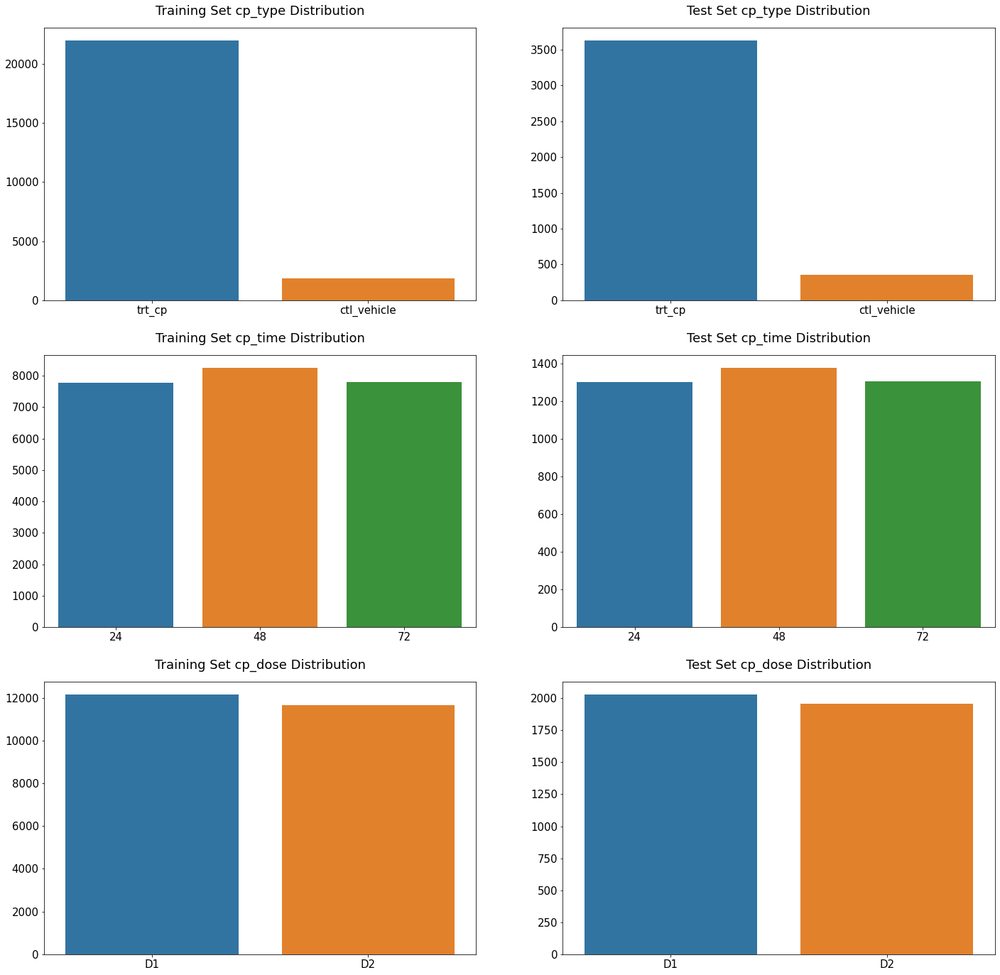

In [10]:
fig, axes = plt.subplots(figsize=(24, 24), nrows=3, ncols=2)

sns.countplot(df_train['cp_type'], ax=axes[0][0])
sns.countplot(df_test['cp_type'], ax=axes[0][1])

sns.countplot(df_train['cp_time'], ax=axes[1][0])
sns.countplot(df_test['cp_time'], ax=axes[1][1])

sns.countplot(df_train['cp_dose'], ax=axes[2][0])
sns.countplot(df_test['cp_dose'], ax=axes[2][1])

for i in range(3):
    for j in range(2):
        axes[i][j].tick_params(axis='x', labelsize=15)
        axes[i][j].tick_params(axis='y', labelsize=15)
        axes[i][j].set_xlabel('')
        axes[i][j].set_ylabel('')
        
for i, feature in enumerate(['cp_type', 'cp_time', 'cp_dose']):
    for j, dataset in enumerate(['Training', 'Test']):
        axes[i][j].set_title(f'{dataset} Set {feature} Distribution', size=18, pad=18)

plt.show()

### **4.1. cp_type**

`cp_type` is the first categorical feature in the dataset and it is a binary feature. It either means that samples are treated with a compound (`trt_cp`) or with a control perturbation (`ctl_vehicle`). Samples treated with control perturbations have no MoAs, thus all of their scored and non-scored target labels are zeros. However, all zero labeled samples are not entirely treated with a control perturbation, more than 1/3 of the compound samples are also labeled as zeros.

In [11]:
df_control = df_train[df_train['cp_type'] == 'ctl_vehicle']
df_compound = df_train[df_train['cp_type'] == 'trt_cp']

print(f'{len(df_control)}/{len(df_train)} samples are treated with a control perturbation and {len(df_control[df_control[target_features_scored].sum(axis=1) == 0])}/{len(df_control)} of those samples have all zero targets')
print(f'{len(df_compound)}/{len(df_train)} samples are treated with a compound and {len(df_compound[df_compound[target_features_scored].sum(axis=1) == 0])}/{len(df_compound)} of those samples have all zero targets')

1866/23814 samples are treated with a control perturbation and 1866/1866 of those samples have all zero targets
21948/23814 samples are treated with a compound and 7501/21948 of those samples have all zero targets


### **4.2. cp_time**

`cp_time` is the second categorical feature in the dataset and it has three unique values; `24`, `48` and `72` hours. It indicates the treatment durations of the samples. Sample counts of different `cp_time` values are very consistent and close to each other in different targets. Sample counts are either extremely close to each other or `48` is slightly higher than the others.

All targets have samples with three durations except erbb2 inhibitor and atp-sensitive potassium channel antagonist, because those two targets are only classified in one sample.

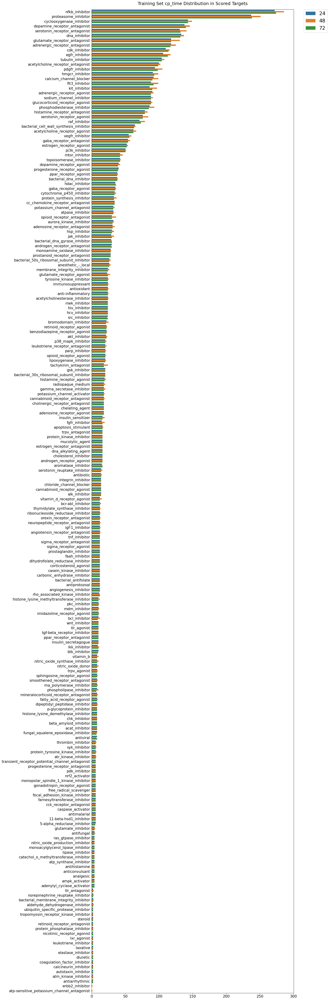

In [12]:
df_target_counts_by_cp_time = pd.DataFrame(columns=['target', 'cp_time', 'count'])

for target_feature in target_features_scored:    
    for cp_time in [24, 48, 72]:
        count = len(df_train[(df_train['cp_time'] == cp_time) & (df_train[target_feature] == 1)])
        df_target_counts_by_cp_time = df_target_counts_by_cp_time.append({'target': target_feature, 'cp_time': cp_time, 'count': count}, ignore_index=True)
        
df_target_counts_by_cp_time['total_count'] = df_target_counts_by_cp_time.groupby('target')['count'].transform('sum')
df_target_counts_by_cp_time.sort_values(by=['total_count', 'target'],ascending=False, inplace=True)

fig = plt.figure(figsize=(15, 75), dpi=100)

sns.barplot(x=df_target_counts_by_cp_time['count'],
            y=df_target_counts_by_cp_time['target'],
            hue=df_target_counts_by_cp_time['cp_time'])

plt.xlabel('')
plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, prop={'size': 20})
plt.title('Training Set cp_time Distribution in Scored Targets', size=18, pad=18)

plt.show()

del df_target_counts_by_cp_time

### **4.3. cp_dose**

`cp_dose` is the final categorical feature in the dataset and it is also a binary feature. It indicates whether the dose of the samples are either low (`D1`) or high (`D2`). Sample counts of different `cp_dose` values are very consistent and close to each other in different targets. Sample counts are even closer to each other compared to `cp_time` and lots of targets have equal sample counts for both doses.

All targets have samples with two doses except erbb2 inhibitor and atp-sensitive potassium channel antagonist, because those two targets are only classified in one sample. 

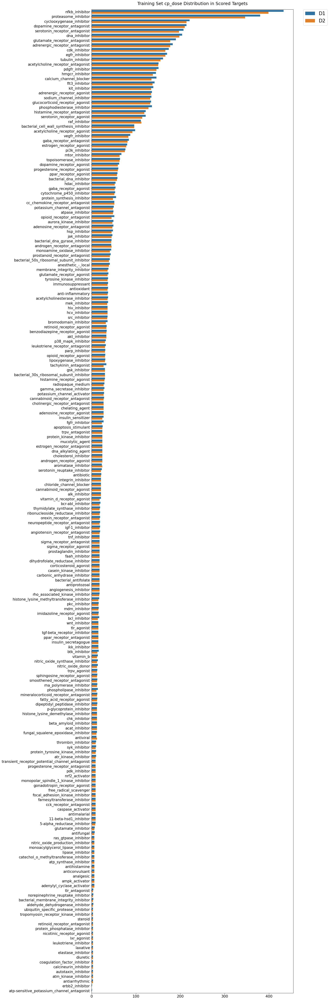

In [13]:
df_target_counts_by_cp_dose = pd.DataFrame(columns=['target', 'cp_dose', 'count'])

for target_feature in target_features_scored:    
    for cp_dose in ['D1', 'D2']:
        count = len(df_train[(df_train['cp_dose'] == cp_dose) & (df_train[target_feature] == 1)])
        df_target_counts_by_cp_dose = df_target_counts_by_cp_dose.append({'target': target_feature, 'cp_dose': cp_dose, 'count': count}, ignore_index=True)
        
df_target_counts_by_cp_dose['total_count'] = df_target_counts_by_cp_dose.groupby('target')['count'].transform('sum')
df_target_counts_by_cp_dose.sort_values(by=['total_count', 'target'],ascending=False, inplace=True)

fig = plt.figure(figsize=(15, 75), dpi=100)

sns.barplot(x=df_target_counts_by_cp_dose['count'],
            y=df_target_counts_by_cp_dose['target'],
            hue=df_target_counts_by_cp_dose['cp_dose'])

plt.xlabel('')
plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, prop={'size': 20})
plt.title('Training Set cp_dose Distribution in Scored Targets', size=18, pad=18)

plt.show()

del df_target_counts_by_cp_dose

## **5. Cell Viability**

### **5.1. Cell Viability Features**

Cell viability is a measure of the proportion of live, healthy cells within a population. Cell viability assays are used to determine the overall health of cells, optimize culture or experimental conditions, and to measure cell survival following treatment with compounds, such as during a drug screen.

Cell-viability assessment is based on PRISM technology. PRISM is a high-throughput screen for assessing cell viability in which cell lines that have each been labelled with a unique 24-nucleotide barcode are pooled and treated with the experimental condition, and surviving cells are “counted” through identification of the cognate barcode. PRISM is an acronym for Profiling Relative Inhibition Simultaneously in Mixture. 

There are 100 cell-viability features and they have c- prefix (`c-0` to `c-99`). Each cell-viability feature represents viability of one particular cell line, and all experiments are based on a set of similar cells. These are mostly cancer cells.

In [14]:
df_train[(['sig_id'] + c_features)]

,sig_id,c-0,c-1,c-2,c-3,c-4,c-5,c-6,c-7,c-8,c-9,c-10,c-11,c-12,c-13,c-14,c-15,c-16,c-17,c-18,c-19,c-20,c-21,c-22,c-23,c-24,c-25,c-26,c-27,c-28,c-29,c-30,c-31,c-32,c-33,c-34,c-35,c-36,c-37,c-38,c-39,c-40,c-41,c-42,c-43,c-44,c-45,c-46,c-47,c-48,c-49,c-50,c-51,c-52,c-53,c-54,c-55,c-56,c-57,c-58,c-59,c-60,c-61,c-62,c-63,c-64,c-65,c-66,c-67,c-68,c-69,c-70,c-71,c-72,c-73,c-74,c-75,c-76,c-77,c-78,c-79,c-80,c-81,c-82,c-83,c-84,c-85,c-86,c-87,c-88,c-89,c-90,c-91,c-92,c-93,c-94,c-95,c-96,c-97,c-98,c-99
0,id_000644bb2,-0.0600,0.1083,0.6864,0.4043,0.4213,-0.6797,0.2888,0.4323,-0.3381,0.3407,0.9084,0.6857,1.0620,0.7602,-0.1048,0.3594,0.6376,-0.2798,-0.4010,0.6842,1.1560,0.3522,-0.3971,-0.2115,-0.2687,0.5196,0.1594,0.8920,0.6485,0.6078,0.3799,-0.1727,0.3817,0.3600,0.5124,-0.1414,0.6159,0.4689,-0.0773,0.4728,-0.0143,-0.5344,0.3578,0.3248,0.8903,0.3431,1.0340,1.3070,-1.0230,0.7709,0.7180,0.0546,-0.9013,0.0471,0.3927,-0.1148,-0.0476,-0.1612,0.1493,-0.2094,0.4805,0.4965,0.3680,0.8427,0.1042,0.1403,0.1758,1.2570,-0.5979,1.2250,-0.0553,0.7351,0.5810,0.9590,0.2427,0.0495,0.4141,0.8432,0.6162,-0.7318,1.2120,0.6362,-0.4427,0.1288,1.4840,0.1799,0.5367,-0.1111,-1.0120,0.6685,0.2862,0.2584,0.8076,0.5523,-0.1912,0.6584,-0.3981,0.2139,0.3801,0.4176
1,id_000779bfc,0.0927,0.2723,0.2772,0.7776,0.3679,0.5696,0.2835,1.4080,0.3745,0.6775,0.7787,0.2074,1.1110,0.2433,0.2010,0.7094,-0.4210,-0.2274,0.4045,0.1138,0.9950,0.0087,0.4864,-0.0140,0.0164,0.1759,0.6654,0.3556,0.8175,0.0474,0.5589,0.4481,0.1888,0.3712,0.7837,0.6860,0.4123,0.1560,-0.1203,-1.2780,0.6743,0.7358,0.1334,-0.5193,0.2281,0.0158,-0.5658,0.6065,0.6259,0.4716,0.0453,0.5036,1.0750,0.2111,0.4759,0.1408,0.8763,0.4611,0.8784,-0.4291,0.4083,0.0319,0.3905,0.7099,0.2912,0.4151,-0.2840,-0.3104,-0.6373,0.2887,-0.0765,0.2539,0.4443,0.5932,0.2031,0.7639,0.5499,-0.3322,-0.0977,0.4329,-0.2782,0.7827,0.5934,0.3402,0.1499,0.4420,0.9366,0.8193,-0.4236,0.3192,-0.4265,0.7543,0.4708,0.0230,0.2957,0.4899,0.1522,0.1241,0.6077,0.7371
2,id_000a6266a,-0.1312,-1.4640,0.3394,-1.7790,0.2188,0.5826,-0.7513,0.0543,0.7182,-0.4159,0.3084,-0.0899,-0.0397,-0.5077,-0.5072,0.0100,-0.6915,0.0643,-0.8927,-0.2048,0.0773,0.5971,-0.1602,-0.2028,-0.2216,-1.1380,0.3668,-1.0620,-0.7736,0.6225,0.6274,-0.3038,0.1171,-0.0550,-0.0289,1.1740,-0.7937,-1.0610,-0.6409,0.3884,-1.0330,-0.0055,0.1212,-0.7020,-0.7065,-0.5192,-0.3181,0.1787,0.3354,0.1349,-0.3569,-0.8229,-0.2778,0.7047,-0.9726,-0.0553,-0.2143,0.0187,0.4497,0.2585,-0.5477,-0.7576,-0.0444,0.1894,-0.0014,-2.3640,-0.4682,0.1210,-0.5177,-0.0604,0.1682,-0.4436,0.4963,0.1363,0.3335,0.9760,-0.0427,-0.1235,0.0959,0.0690,-0.9416,-0.7548,-0.1109,-0.6272,0.3019,0.1172,0.1093,-0.3113,0.3019,-0.0873,-0.7250,-0.6297,0.6103,0.0223,-1.3240,-0.3174,-0.6417,-0.2187,-1.4080,0.6931
3,id_0015fd391,-0.3998,-4.5520,-2.7350,-1.9630,-2.8610,-1.2670,-2.5830,-0.5036,-3.1590,-1.8510,-2.2730,-4.6920,-1.2750,-1.4970,-0.0156,-1.9350,-1.3430,-0.5252,-2.7210,-0.2524,0.9197,-3.1220,-1.9180,-0.6761,-2.8360,-1.6890,-4.4990,-1.5190,-2.2730,-0.3250,0.1895,-2.4220,0.0670,-1.9870,-0.6482,-0.0023,-1.9930,-0.8042,-3.6160,-0.3487,-1.2560,-2.7220,-2.1970,-2.9030,-1.1030,-2.3020,-2.0030,-1.3390,-3.0160,-3.0040,-2.8880,-1.4910,-1.7960,-1.3670,-2.7830,-3.3290,0.1071,-2.5430,0.3747,-1.7540,-2.1220,-0.3752,-2.3820,-3.7350,-2.9740,-1.4930,-1.6600,-3.1660,0.2816,-0.2990,-1.1870,-0.5044,-1.7750,-1.6120,-0.9215,-1.0810,-3.0520,-3.4470,-2.7740,-1.8460,-0.5568,-3.3960,-2.9510,-1.1550,-3.2620,-1.5390,-2.4600,-0.9417,-1.5550,0.2431,-2.0990,-0.6441,-5.6300,-1.3780,-0.8632,-1.2880,-1.6210,-0.8784,-0.3876,-0.8154
4,id_001626bd3,-0.3774,0.7364,-0.1659,0.2341,1.0060,0.3204,-0.0852,-0.2284,-0.2533,-0.3174,0.9642,-0.0853,0.1559,0.1419,0.1197,0.6774,0.1332,-0.5176,0.1232,0.0827,0.6995,0.5953,1.0600,-0.4255,0.8624,1.0010,0.0840,-0.6553,-0.1093,0.0587,0.5490,0.6331,0.5227,0.2186,0.2781,0.8947,-0.0202,0.5966,0.2249,0.5671,0.6382,-0.3909,0.7040,0.1462,0.0655,-0.5605,0.5903,-0.2353,-0.1285,-0.1740,0.3559,0.0204,0.3385,-0.2290,-0.3813,-0.0856,1.1080,-0.4190,0.

### **5.2. Cell Viability and Target Interactions**

Cell viability features are plotted against only a random target feature since there are 206 targets. It can be seen that, there are positive relationships between cell viability features and target features in most of the cases. However, some of them have no relationship or negative relationship with target features. This could be related to, most of the cells are being cancer cells while some of them are not. Another pattern that can be seen in cell viability features is, positive target values are clustered around zero means in most of the cases.

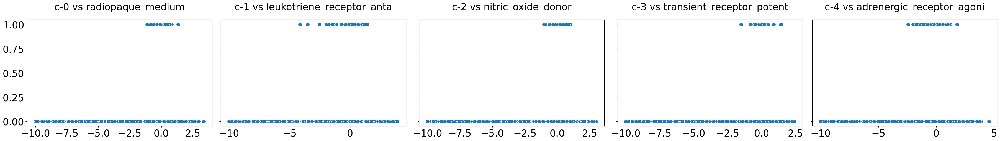

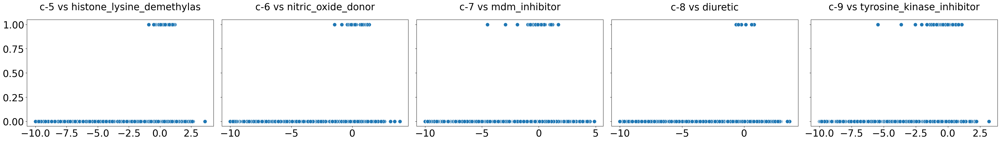

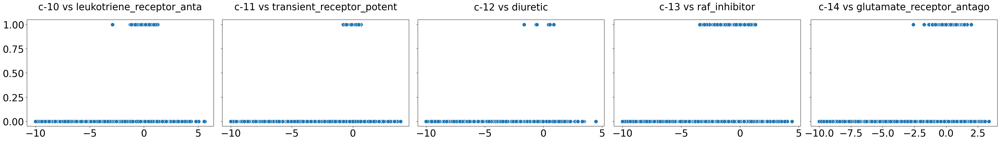

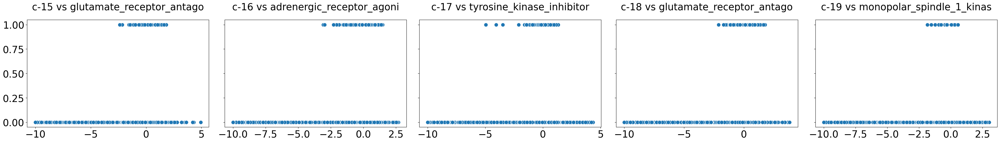

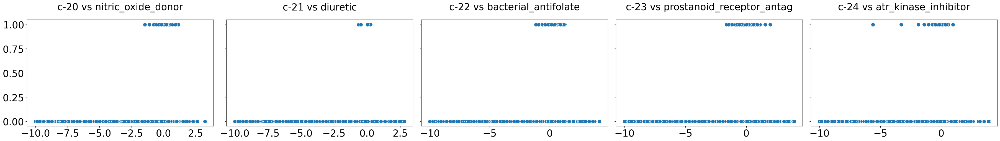

...

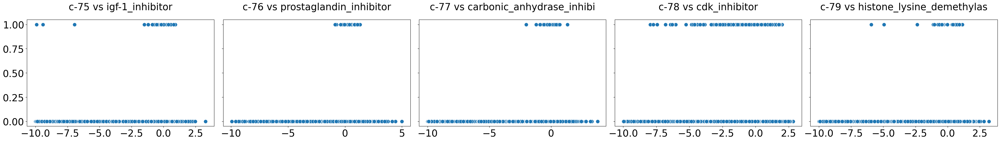

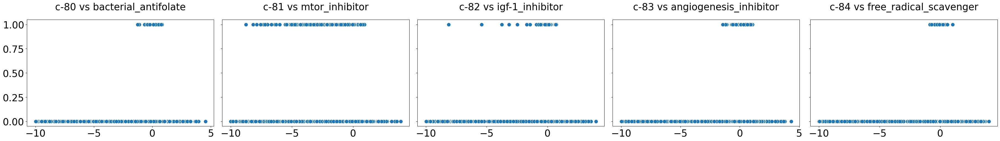

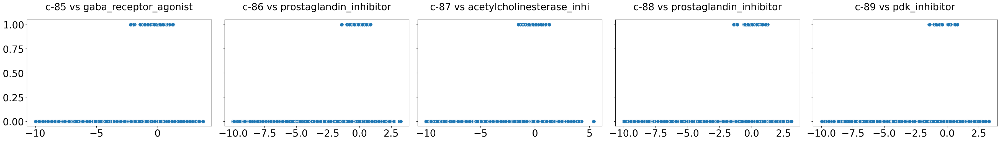

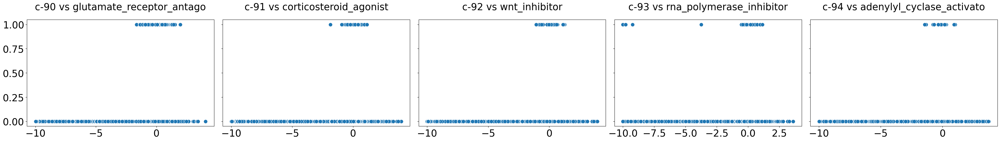

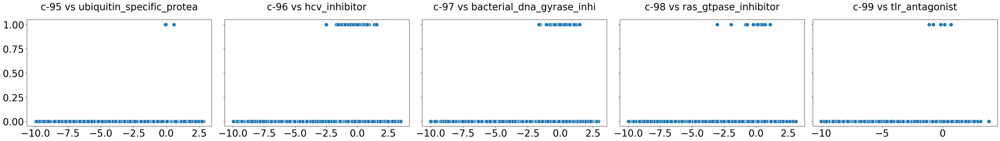

In [15]:
def scatterplot_cfeature(feature_group, seeds):
        
    fig, axes = plt.subplots(ncols=5, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 25
    label_size = 25

    for i, feature in enumerate(feature_group):
        
        np.random.seed(seeds[i])
        target = np.random.choice(target_features_scored)
        if len(target) > 25:
            target_title = target[:25]
        else:
            target_title = target
            
        sns.scatterplot(df_train[feature], df_train[target], s=100, ax=axes[i])
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        for label in axes[i].get_yticklabels():
            if i % 5 == 0:
                label.set_visible(True)
            else:
                label.set_visible(False)
                
        axes[i].set_title(f'{feature} vs {target_title}', size=title_size, pad=title_size)
    
    plt.show()
    
for i, feature_group in enumerate(np.array_split(c_features, len(c_features) // 5), 2):
    scatterplot_cfeature(feature_group, seeds=np.arange(1, 6) * i)

### **5.3. Cell Viability Feature Distributions**

Cell viability feature distributions are very similar in training and test set, that's because, quantile normalization and z-scoring steps are done at the plate level once, not separately for training and test set. A typical plate contains 1,200 signatures and those signatures can be placed in both training or test set. Plate information is not provided in the dataset.

Most common cell viability feature distribution looks like a left-skewed bell curve with mean close to 0.5. Features with most different distributions are `c-37`, `c-58`, `c-69`, `c-74` and `c-76` because of their shorter tails. They have higher overall cell viability. Minimum values in other features are clipped at -10, but it wasn't required for formerly mentioned features.

c-0 Train - Mean: -0.3552 - Median: -0.009 - Std: 1.753 - Min: -10.0 - Max: 3.365 - Skew -3.811 - Kurt 16.97 - Var 3.071
c-0 Test - Mean: -0.3562 - Median: -0.014 - Std: 1.773 - Min: -10.0 - Max: 3.251 - Skew -3.852 - Kurt 17.01 - Var 3.143

c-1 Train - Mean: -0.4554 - Median: 0.0098 - Std: 2.005 - Min: -10.0 - Max: 3.915 - Skew -3.174 - Kurt 10.74 - Var 4.02
c-1 Test - Mean: -0.4343 - Median: 0.017 - Std: 2.017 - Min: -10.0 - Max: 4.362 - Skew -3.236 - Kurt 11.06 - Var 4.069

c-2 Train - Mean: -0.4805 - Median: -0.004 - Std: 2.039 - Min: -10.0 - Max: 2.97 - Skew -3.288 - Kurt 11.38 - Var 4.159
c-2 Test - Mean: -0.4432 - Median: 0.02635 - Std: 2.042 - Min: -10.0 - Max: 5.955 - Skew -3.356 - Kurt 11.87 - Var 4.168

c-3 Train - Mean: -0.3777 - Median: -0.03905 - Std: 1.555 - Min: -10.0 - Max: 2.408 - Skew -3.329 - Kurt 13.8 - Var 2.417
c-3 Test - Mean: -0.3618 - Median: -0.0261 - Std: 1.54 - Min: -10.0 - Max: 3.41 - Skew -3.426 - Kurt 14.59 - Var 2.37

c-4 Train - Mean: -0.4936 - Median:

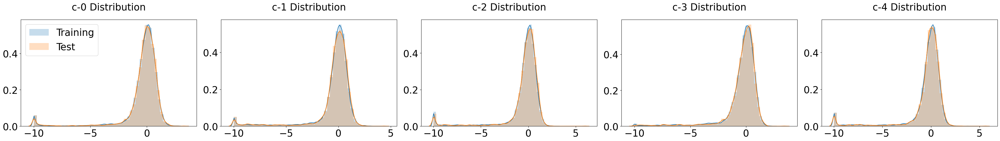

c-5 Train - Mean: -0.446 - Median: -0.0089 - Std: 1.893 - Min: -10.0 - Max: 3.614 - Skew -3.377 - Kurt 12.69 - Var 3.585
c-5 Test - Mean: -0.3929 - Median: 0.0385 - Std: 1.875 - Min: -10.0 - Max: 4.783 - Skew -3.512 - Kurt 13.71 - Var 3.515

c-6 Train - Mean: -0.5749 - Median: 0.0074 - Std: 2.234 - Min: -10.0 - Max: 3.904 - Skew -3.107 - Kurt 9.61 - Var 4.991
c-6 Test - Mean: -0.507 - Median: 0.04585 - Std: 2.209 - Min: -10.0 - Max: 4.126 - Skew -3.26 - Kurt 10.62 - Var 4.881

c-7 Train - Mean: -0.2663 - Median: 0.00635 - Std: 1.465 - Min: -10.0 - Max: 4.918 - Skew -3.24 - Kurt 14.01 - Var 2.147
c-7 Test - Mean: -0.2449 - Median: 0.00615 - Std: 1.436 - Min: -10.0 - Max: 5.457 - Skew -3.188 - Kurt 13.84 - Var 2.061

c-8 Train - Mean: -0.4513 - Median: -0.00535 - Std: 1.949 - Min: -10.0 - Max: 3.648 - Skew -3.347 - Kurt 12.19 - Var 3.798
c-8 Test - Mean: -0.4244 - Median: 0.01965 - Std: 1.951 - Min: -10.0 - Max: 4.101 - Skew -3.409 - Kurt 12.68 - Var 3.804

c-9 Train - Mean: -0.4587 - Me

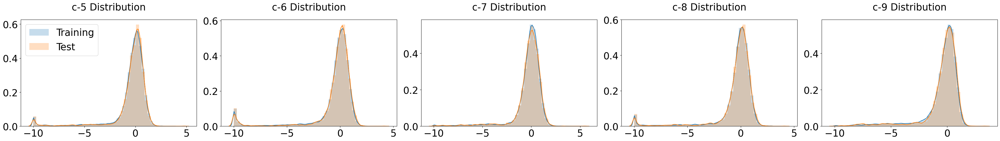

c-10 Train - Mean: -0.486 - Median: 0.00535 - Std: 2.067 - Min: -10.0 - Max: 5.642 - Skew -3.218 - Kurt 10.98 - Var 4.271
c-10 Test - Mean: -0.4085 - Median: 0.0455 - Std: 1.974 - Min: -10.0 - Max: 5.35 - Skew -3.494 - Kurt 13.19 - Var 3.895

c-11 Train - Mean: -0.4734 - Median: 0.00255 - Std: 2.059 - Min: -10.0 - Max: 3.904 - Skew -3.296 - Kurt 11.34 - Var 4.238
c-11 Test - Mean: -0.4246 - Median: 0.0326 - Std: 2.043 - Min: -10.0 - Max: 4.767 - Skew -3.422 - Kurt 12.18 - Var 4.173

c-12 Train - Mean: -0.5081 - Median: -0.0055 - Std: 2.14 - Min: -10.0 - Max: 4.472 - Skew -3.26 - Kurt 10.72 - Var 4.58
c-12 Test - Mean: -0.4845 - Median: -0.00215 - Std: 2.107 - Min: -10.0 - Max: 5.266 - Skew -3.388 - Kurt 11.62 - Var 4.439

c-13 Train - Mean: -0.5109 - Median: 0.0064 - Std: 2.171 - Min: -10.0 - Max: 4.434 - Skew -3.148 - Kurt 10.09 - Var 4.713
c-13 Test - Mean: -0.459 - Median: 0.0226 - Std: 2.139 - Min: -10.0 - Max: 5.202 - Skew -3.255 - Kurt 10.9 - Var 4.574

c-14 Train - Mean: -0.3065

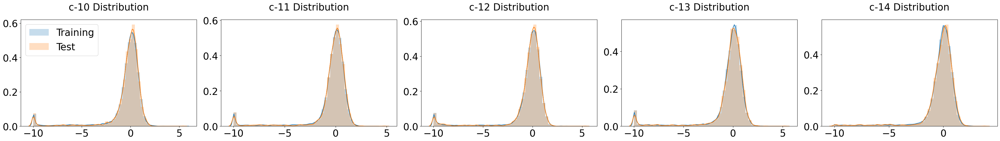

c-15 Train - Mean: -0.4523 - Median: 0.0031 - Std: 1.974 - Min: -10.0 - Max: 4.929 - Skew -3.288 - Kurt 11.72 - Var 3.897
c-15 Test - Mean: -0.4025 - Median: 0.021 - Std: 1.955 - Min: -10.0 - Max: 4.734 - Skew -3.397 - Kurt 12.52 - Var 3.822

c-16 Train - Mean: -0.3373 - Median: -0.03585 - Std: 1.595 - Min: -10.0 - Max: 2.675 - Skew -3.673 - Kurt 16.27 - Var 2.543
c-16 Test - Mean: -0.3375 - Median: -0.04415 - Std: 1.605 - Min: -10.0 - Max: 2.459 - Skew -3.697 - Kurt 16.15 - Var 2.577

c-17 Train - Mean: -0.4737 - Median: -0.0001 - Std: 2.08 - Min: -10.0 - Max: 4.342 - Skew -3.368 - Kurt 11.82 - Var 4.324
c-17 Test - Mean: -0.4505 - Median: -0.00065 - Std: 2.086 - Min: -10.0 - Max: 6.024 - Skew -3.418 - Kurt 12.23 - Var 4.352

c-18 Train - Mean: -0.6195 - Median: 0.00935 - Std: 2.295 - Min: -10.0 - Max: 3.811 - Skew -2.855 - Kurt 7.864 - Var 5.266
c-18 Test - Mean: -0.5336 - Median: 0.0271 - Std: 2.207 - Min: -10.0 - Max: 5.289 - Skew -3.039 - Kurt 9.216 - Var 4.871

c-19 Train - Mean:

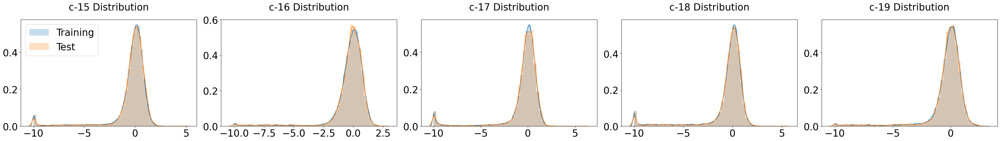

c-20 Train - Mean: -0.4542 - Median: -0.0132 - Std: 2.001 - Min: -10.0 - Max: 3.228 - Skew -3.473 - Kurt 12.67 - Var 4.005
c-20 Test - Mean: -0.418 - Median: -0.00225 - Std: 1.997 - Min: -10.0 - Max: 3.828 - Skew -3.567 - Kurt 13.26 - Var 3.987

c-21 Train - Mean: -0.4961 - Median: -0.0049 - Std: 2.023 - Min: -10.0 - Max: 2.827 - Skew -3.2 - Kurt 10.88 - Var 4.093
c-21 Test - Mean: -0.4358 - Median: 0.05405 - Std: 1.999 - Min: -10.0 - Max: 4.571 - Skew -3.313 - Kurt 11.76 - Var 3.995

c-22 Train - Mean: -0.3831 - Median: -0.01055 - Std: 1.69 - Min: -10.0 - Max: 4.134 - Skew -3.155 - Kurt 12.03 - Var 2.857
c-22 Test - Mean: -0.3114 - Median: 0.0318 - Std: 1.62 - Min: -10.0 - Max: 5.473 - Skew -3.267 - Kurt 13.25 - Var 2.622

c-23 Train - Mean: -0.2957 - Median: 0.0196 - Std: 1.537 - Min: -10.0 - Max: 3.918 - Skew -3.111 - Kurt 12.45 - Var 2.362
c-23 Test - Mean: -0.2837 - Median: 0.03085 - Std: 1.526 - Min: -10.0 - Max: 4.567 - Skew -3.176 - Kurt 13.05 - Var 2.33

c-24 Train - Mean: -0.

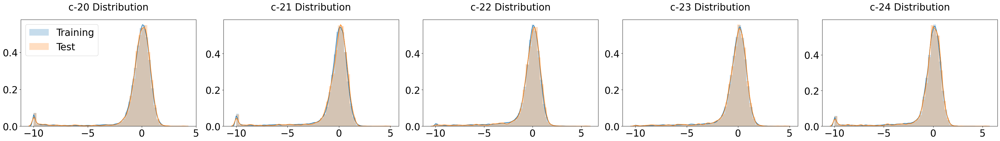

c-25 Train - Mean: -0.4497 - Median: -0.00855 - Std: 1.899 - Min: -10.0 - Max: 3.058 - Skew -3.381 - Kurt 12.69 - Var 3.606
c-25 Test - Mean: -0.3904 - Median: 0.0138 - Std: 1.835 - Min: -10.0 - Max: 4.14 - Skew -3.602 - Kurt 14.67 - Var 3.368

c-26 Train - Mean: -0.5977 - Median: 0.0065 - Std: 2.269 - Min: -10.0 - Max: 4.144 - Skew -2.923 - Kurt 8.315 - Var 5.148
c-26 Test - Mean: -0.5257 - Median: 0.03775 - Std: 2.23 - Min: -10.0 - Max: 5.94 - Skew -3.093 - Kurt 9.481 - Var 4.971

c-27 Train - Mean: -0.4319 - Median: -0.00925 - Std: 1.916 - Min: -10.0 - Max: 2.957 - Skew -3.479 - Kurt 13.22 - Var 3.673
c-27 Test - Mean: -0.3936 - Median: 0.0217 - Std: 1.956 - Min: -10.0 - Max: 5.58 - Skew -3.527 - Kurt 13.33 - Var 3.825

c-28 Train - Mean: -0.5018 - Median: -0.0224 - Std: 1.905 - Min: -10.0 - Max: 3.322 - Skew -3.207 - Kurt 11.16 - Var 3.627
c-28 Test - Mean: -0.4651 - Median: -0.0013 - Std: 1.895 - Min: -10.0 - Max: 2.941 - Skew -3.32 - Kurt 11.94 - Var 3.589

c-29 Train - Mean: -0.

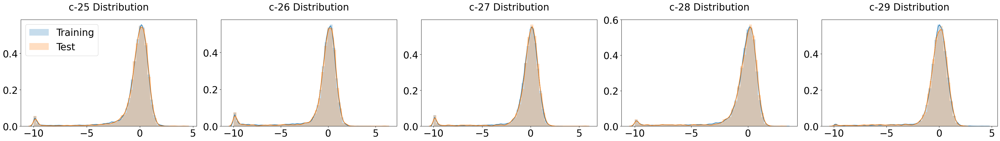

c-30 Train - Mean: -0.3855 - Median: 0.00305 - Std: 1.741 - Min: -10.0 - Max: 3.606 - Skew -3.235 - Kurt 12.01 - Var 3.032
c-30 Test - Mean: -0.3515 - Median: 0.0124 - Std: 1.725 - Min: -9.975 - Max: 3.505 - Skew -3.341 - Kurt 12.85 - Var 2.975

c-31 Train - Mean: -0.4344 - Median: -0.00215 - Std: 1.988 - Min: -10.0 - Max: 6.099 - Skew -3.473 - Kurt 12.91 - Var 3.954
c-31 Test - Mean: -0.405 - Median: 0.01555 - Std: 1.982 - Min: -10.0 - Max: 4.541 - Skew -3.615 - Kurt 13.79 - Var 3.926

c-32 Train - Mean: -0.323 - Median: 0.0005 - Std: 1.772 - Min: -10.0 - Max: 4.073 - Skew -3.753 - Kurt 16.13 - Var 3.141
c-32 Test - Mean: -0.3265 - Median: 0.0168 - Std: 1.817 - Min: -10.0 - Max: 4.169 - Skew -3.687 - Kurt 15.36 - Var 3.3

c-33 Train - Mean: -0.5457 - Median: 0.00585 - Std: 2.202 - Min: -10.0 - Max: 4.258 - Skew -3.166 - Kurt 10.03 - Var 4.847
c-33 Test - Mean: -0.4947 - Median: 0.00795 - Std: 2.162 - Min: -10.0 - Max: 5.0 - Skew -3.325 - Kurt 11.18 - Var 4.672

c-34 Train - Mean: -0.4

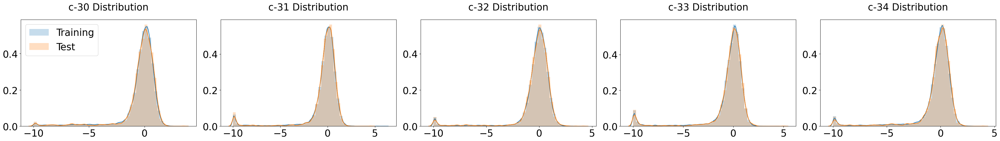

c-35 Train - Mean: -0.3505 - Median: -0.0128 - Std: 1.751 - Min: -10.0 - Max: 4.345 - Skew -3.486 - Kurt 14.19 - Var 3.067
c-35 Test - Mean: -0.3333 - Median: 0.02015 - Std: 1.753 - Min: -9.975 - Max: 5.419 - Skew -3.609 - Kurt 14.83 - Var 3.071

c-36 Train - Mean: -0.477 - Median: -0.00335 - Std: 1.965 - Min: -10.0 - Max: 2.837 - Skew -3.277 - Kurt 11.64 - Var 3.862
c-36 Test - Mean: -0.4241 - Median: 0.0263 - Std: 1.945 - Min: -10.0 - Max: 4.495 - Skew -3.395 - Kurt 12.46 - Var 3.783

c-37 Train - Mean: -0.2093 - Median: -0.004 - Std: 1.288 - Min: -9.91 - Max: 3.962 - Skew -2.941 - Kurt 12.76 - Var 1.658
c-37 Test - Mean: -0.216 - Median: -0.009 - Std: 1.288 - Min: -9.799 - Max: 4.806 - Skew -3.015 - Kurt 13.33 - Var 1.658

c-38 Train - Mean: -0.598 - Median: -0.00665 - Std: 2.297 - Min: -10.0 - Max: 3.734 - Skew -3.035 - Kurt 8.876 - Var 5.278
c-38 Test - Mean: -0.5288 - Median: 0.0114 - Std: 2.245 - Min: -10.0 - Max: 5.314 - Skew -3.189 - Kurt 9.958 - Var 5.037

c-39 Train - Mean: 

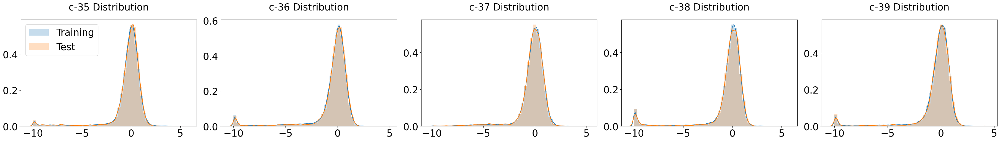

c-40 Train - Mean: -0.4787 - Median: 0.0 - Std: 1.996 - Min: -10.0 - Max: 4.165 - Skew -3.194 - Kurt 10.92 - Var 3.985
c-40 Test - Mean: -0.4575 - Median: 0.0005 - Std: 1.978 - Min: -10.0 - Max: 4.761 - Skew -3.319 - Kurt 11.77 - Var 3.912

c-41 Train - Mean: -0.4701 - Median: -0.006 - Std: 1.986 - Min: -10.0 - Max: 3.917 - Skew -3.345 - Kurt 12.07 - Var 3.944
c-41 Test - Mean: -0.4073 - Median: 0.01255 - Std: 1.914 - Min: -10.0 - Max: 4.912 - Skew -3.541 - Kurt 13.84 - Var 3.661

c-42 Train - Mean: -0.4829 - Median: 0.0057 - Std: 2.034 - Min: -10.0 - Max: 4.761 - Skew -3.218 - Kurt 10.97 - Var 4.138
c-42 Test - Mean: -0.4402 - Median: 0.02765 - Std: 2.011 - Min: -10.0 - Max: 4.957 - Skew -3.294 - Kurt 11.63 - Var 4.044

c-43 Train - Mean: -0.4522 - Median: -0.00825 - Std: 1.974 - Min: -10.0 - Max: 3.684 - Skew -3.331 - Kurt 11.99 - Var 3.896
c-43 Test - Mean: -0.4137 - Median: 0.01615 - Std: 1.95 - Min: -10.0 - Max: 4.318 - Skew -3.463 - Kurt 12.98 - Var 3.803

c-44 Train - Mean: -0.4

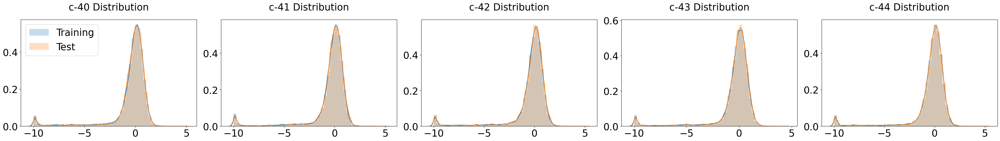

c-45 Train - Mean: -0.5089 - Median: -0.0108 - Std: 2.106 - Min: -10.0 - Max: 3.191 - Skew -3.264 - Kurt 10.9 - Var 4.437
c-45 Test - Mean: -0.4708 - Median: 0.0143 - Std: 2.097 - Min: -10.0 - Max: 5.121 - Skew -3.345 - Kurt 11.48 - Var 4.396

c-46 Train - Mean: -0.4145 - Median: -0.0029 - Std: 1.792 - Min: -10.0 - Max: 3.309 - Skew -3.333 - Kurt 12.69 - Var 3.212
c-46 Test - Mean: -0.3821 - Median: 0.0111 - Std: 1.809 - Min: -10.0 - Max: 4.077 - Skew -3.475 - Kurt 13.6 - Var 3.272

c-47 Train - Mean: -0.4603 - Median: -0.0013 - Std: 1.875 - Min: -10.0 - Max: 3.245 - Skew -3.178 - Kurt 11.15 - Var 3.515
c-47 Test - Mean: -0.4005 - Median: 0.0517 - Std: 1.872 - Min: -10.0 - Max: 4.827 - Skew -3.301 - Kurt 11.98 - Var 3.503

c-48 Train - Mean: -0.5186 - Median: -0.00385 - Std: 2.042 - Min: -10.0 - Max: 3.371 - Skew -3.036 - Kurt 9.476 - Var 4.171
c-48 Test - Mean: -0.4571 - Median: 0.0188 - Std: 1.982 - Min: -10.0 - Max: 4.89 - Skew -3.13 - Kurt 10.35 - Var 3.926

c-49 Train - Mean: -0.3

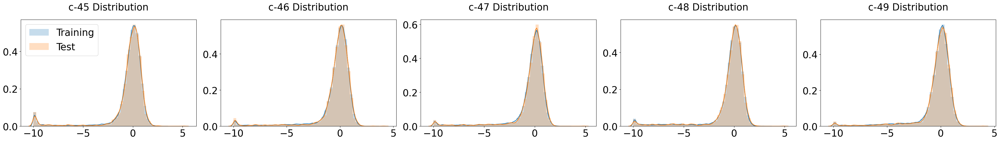

c-50 Train - Mean: -0.3931 - Median: 0.0063 - Std: 1.794 - Min: -10.0 - Max: 6.412 - Skew -3.075 - Kurt 10.77 - Var 3.219
c-50 Test - Mean: -0.3542 - Median: 0.01995 - Std: 1.752 - Min: -9.974 - Max: 3.939 - Skew -3.276 - Kurt 12.1 - Var 3.07

c-51 Train - Mean: -0.4556 - Median: -0.01405 - Std: 1.964 - Min: -10.0 - Max: 4.155 - Skew -3.262 - Kurt 11.59 - Var 3.858
c-51 Test - Mean: -0.4223 - Median: 0.00855 - Std: 1.939 - Min: -10.0 - Max: 5.242 - Skew -3.333 - Kurt 12.3 - Var 3.757

c-52 Train - Mean: -0.4656 - Median: -0.0029 - Std: 2.007 - Min: -10.0 - Max: 4.854 - Skew -3.198 - Kurt 10.97 - Var 4.029
c-52 Test - Mean: -0.4132 - Median: 0.037 - Std: 1.994 - Min: -10.0 - Max: 4.404 - Skew -3.352 - Kurt 11.9 - Var 3.976

c-53 Train - Mean: -0.3702 - Median: -0.039 - Std: 1.752 - Min: -10.0 - Max: 2.967 - Skew -3.666 - Kurt 15.52 - Var 3.071
c-53 Test - Mean: -0.3698 - Median: -0.0297 - Std: 1.762 - Min: -10.0 - Max: 5.193 - Skew -3.733 - Kurt 15.91 - Var 3.102

c-54 Train - Mean: -0.

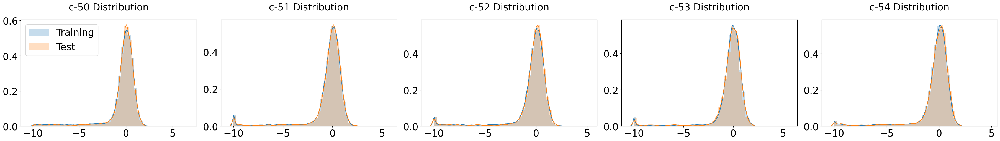

c-55 Train - Mean: -0.4907 - Median: -0.0107 - Std: 2.121 - Min: -10.0 - Max: 4.212 - Skew -3.258 - Kurt 10.96 - Var 4.499
c-55 Test - Mean: -0.4273 - Median: 0.02335 - Std: 2.071 - Min: -10.0 - Max: 5.62 - Skew -3.394 - Kurt 12.1 - Var 4.288

c-56 Train - Mean: -0.2791 - Median: -0.0149 - Std: 1.478 - Min: -10.0 - Max: 4.2 - Skew -3.549 - Kurt 16.33 - Var 2.183
c-56 Test - Mean: -0.2555 - Median: -0.0094 - Std: 1.438 - Min: -10.0 - Max: 4.942 - Skew -3.582 - Kurt 17.08 - Var 2.067

c-57 Train - Mean: -0.4565 - Median: -0.00545 - Std: 1.902 - Min: -10.0 - Max: 4.329 - Skew -3.169 - Kurt 11.12 - Var 3.616
c-57 Test - Mean: -0.4172 - Median: 0.0061 - Std: 1.87 - Min: -10.0 - Max: 4.819 - Skew -3.319 - Kurt 12.31 - Var 3.498

c-58 Train - Mean: -0.3003 - Median: -0.06115 - Std: 1.238 - Min: -8.414 - Max: 2.289 - Skew -2.685 - Kurt 9.701 - Var 1.534
c-58 Test - Mean: -0.2839 - Median: -0.03705 - Std: 1.24 - Min: -7.324 - Max: 3.392 - Skew -2.716 - Kurt 9.869 - Var 1.537

c-59 Train - Mean:

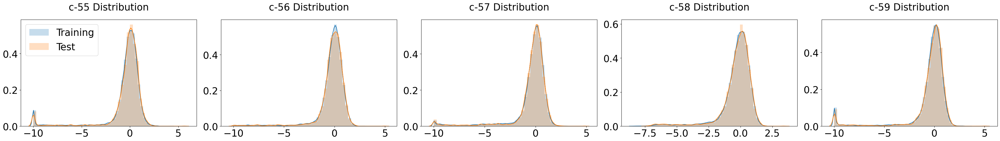

c-60 Train - Mean: -0.5174 - Median: -0.01765 - Std: 2.122 - Min: -10.0 - Max: 3.888 - Skew -3.308 - Kurt 11.37 - Var 4.504
c-60 Test - Mean: -0.4786 - Median: 0.02535 - Std: 2.139 - Min: -10.0 - Max: 4.992 - Skew -3.387 - Kurt 11.76 - Var 4.575

c-61 Train - Mean: -0.3608 - Median: -0.04155 - Std: 1.711 - Min: -10.0 - Max: 3.596 - Skew -3.764 - Kurt 16.65 - Var 2.926
c-61 Test - Mean: -0.3471 - Median: -0.02885 - Std: 1.725 - Min: -10.0 - Max: 4.553 - Skew -3.762 - Kurt 16.5 - Var 2.973

c-62 Train - Mean: -0.4358 - Median: -0.00295 - Std: 1.899 - Min: -10.0 - Max: 4.857 - Skew -3.343 - Kurt 12.37 - Var 3.606
c-62 Test - Mean: -0.4014 - Median: 0.01885 - Std: 1.906 - Min: -10.0 - Max: 4.169 - Skew -3.443 - Kurt 12.96 - Var 3.632

c-63 Train - Mean: -0.6136 - Median: -0.01265 - Std: 2.308 - Min: -10.0 - Max: 3.549 - Skew -3.013 - Kurt 8.741 - Var 5.326
c-63 Test - Mean: -0.5624 - Median: 0.02605 - Std: 2.253 - Min: -10.0 - Max: 4.393 - Skew -3.139 - Kurt 9.683 - Var 5.074

c-64 Train -

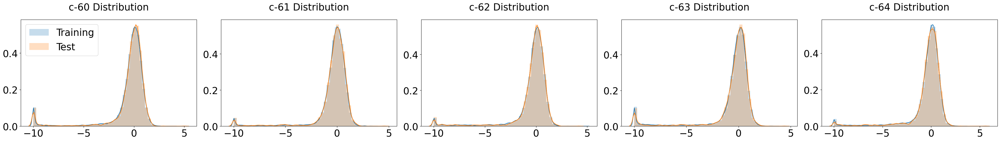

c-65 Train - Mean: -0.6197 - Median: 0.00765 - Std: 2.226 - Min: -10.0 - Max: 3.328 - Skew -2.933 - Kurt 8.537 - Var 4.953
c-65 Test - Mean: -0.55 - Median: 0.0318 - Std: 2.183 - Min: -10.0 - Max: 2.844 - Skew -3.096 - Kurt 9.619 - Var 4.763

c-66 Train - Mean: -0.4523 - Median: 0.00495 - Std: 1.991 - Min: -10.0 - Max: 4.157 - Skew -3.196 - Kurt 11.14 - Var 3.964
c-66 Test - Mean: -0.4123 - Median: 0.035 - Std: 1.98 - Min: -10.0 - Max: 4.54 - Skew -3.308 - Kurt 11.89 - Var 3.919

c-67 Train - Mean: -0.4972 - Median: 0.0 - Std: 2.064 - Min: -10.0 - Max: 3.736 - Skew -3.193 - Kurt 10.59 - Var 4.259
c-67 Test - Mean: -0.4507 - Median: 0.0193 - Std: 2.046 - Min: -10.0 - Max: 4.397 - Skew -3.315 - Kurt 11.42 - Var 4.185

c-68 Train - Mean: -0.4138 - Median: -0.0238 - Std: 1.887 - Min: -10.0 - Max: 3.582 - Skew -3.557 - Kurt 14.01 - Var 3.561
c-68 Test - Mean: -0.3831 - Median: -0.0129 - Std: 1.877 - Min: -10.0 - Max: 4.946 - Skew -3.689 - Kurt 15.14 - Var 3.522

c-69 Train - Mean: -0.277 - 

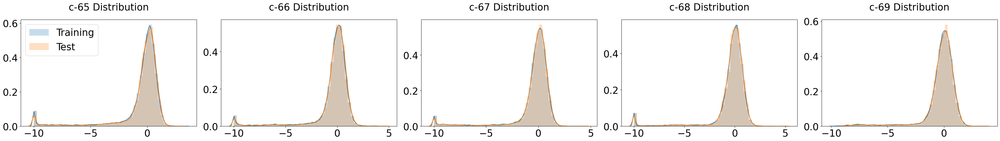

c-70 Train - Mean: -0.5478 - Median: -0.0071 - Std: 2.188 - Min: -10.0 - Max: 3.323 - Skew -3.201 - Kurt 10.37 - Var 4.786
c-70 Test - Mean: -0.4693 - Median: 0.035 - Std: 2.126 - Min: -10.0 - Max: 5.021 - Skew -3.41 - Kurt 11.95 - Var 4.517

c-71 Train - Mean: -0.3586 - Median: -0.0195 - Std: 1.731 - Min: -10.0 - Max: 5.014 - Skew -3.48 - Kurt 14.45 - Var 2.995
c-71 Test - Mean: -0.3347 - Median: -0.00625 - Std: 1.712 - Min: -10.0 - Max: 4.913 - Skew -3.607 - Kurt 15.4 - Var 2.929

c-72 Train - Mean: -0.4429 - Median: -0.0195 - Std: 1.925 - Min: -10.0 - Max: 2.898 - Skew -3.52 - Kurt 13.62 - Var 3.704
c-72 Test - Mean: -0.4216 - Median: 0.0034 - Std: 1.958 - Min: -10.0 - Max: 4.752 - Skew -3.547 - Kurt 13.64 - Var 3.834

c-73 Train - Mean: -0.4752 - Median: -0.0093 - Std: 2.022 - Min: -10.0 - Max: 4.185 - Skew -3.235 - Kurt 11.37 - Var 4.088
c-73 Test - Mean: -0.4425 - Median: -0.00385 - Std: 2.019 - Min: -10.0 - Max: 5.769 - Skew -3.286 - Kurt 11.87 - Var 4.073

c-74 Train - Mean: -0

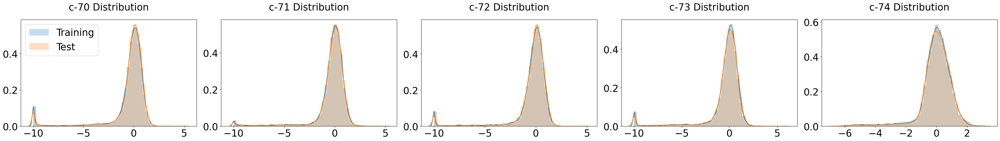

c-75 Train - Mean: -0.467 - Median: -0.0069 - Std: 2.004 - Min: -10.0 - Max: 3.276 - Skew -3.394 - Kurt 12.19 - Var 4.017
c-75 Test - Mean: -0.4228 - Median: 0.03645 - Std: 2.001 - Min: -10.0 - Max: 4.456 - Skew -3.451 - Kurt 12.58 - Var 4.004

c-76 Train - Mean: -0.277 - Median: 0.0184 - Std: 1.429 - Min: -9.938 - Max: 4.992 - Skew -2.45 - Kurt 7.488 - Var 2.043
c-76 Test - Mean: -0.2354 - Median: 0.0215 - Std: 1.385 - Min: -7.963 - Max: 4.454 - Skew -2.474 - Kurt 7.783 - Var 1.918

c-77 Train - Mean: -0.4558 - Median: -0.01465 - Std: 1.924 - Min: -10.0 - Max: 3.77 - Skew -3.305 - Kurt 11.84 - Var 3.703
c-77 Test - Mean: -0.4096 - Median: 0.01085 - Std: 1.908 - Min: -10.0 - Max: 2.428 - Skew -3.37 - Kurt 12.27 - Var 3.64

c-78 Train - Mean: -0.4129 - Median: -0.01435 - Std: 1.889 - Min: -10.0 - Max: 2.851 - Skew -3.653 - Kurt 14.68 - Var 3.567
c-78 Test - Mean: -0.3986 - Median: -0.0011 - Std: 1.925 - Min: -10.0 - Max: 5.597 - Skew -3.655 - Kurt 14.54 - Var 3.703

c-79 Train - Mean: -

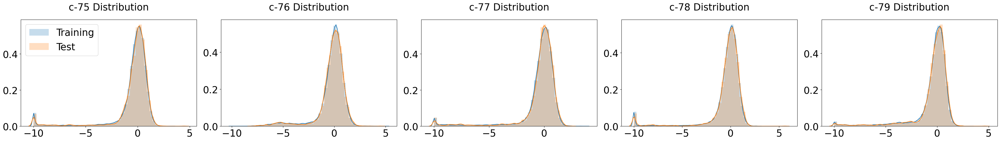

c-80 Train - Mean: -0.4725 - Median: -0.0053 - Std: 2.011 - Min: -10.0 - Max: 4.534 - Skew -3.346 - Kurt 11.96 - Var 4.046
c-80 Test - Mean: -0.448 - Median: 0.0198 - Std: 2.001 - Min: -10.0 - Max: 5.497 - Skew -3.434 - Kurt 12.57 - Var 4.005

c-81 Train - Mean: -0.5055 - Median: -0.00405 - Std: 2.091 - Min: -10.0 - Max: 3.89 - Skew -3.148 - Kurt 10.29 - Var 4.374
c-81 Test - Mean: -0.4505 - Median: 0.0001 - Std: 2.043 - Min: -10.0 - Max: 5.162 - Skew -3.312 - Kurt 11.51 - Var 4.174

c-82 Train - Mean: -0.4927 - Median: 0.0033 - Std: 2.056 - Min: -10.0 - Max: 3.994 - Skew -3.15 - Kurt 10.59 - Var 4.225
c-82 Test - Mean: -0.4324 - Median: 0.0446 - Std: 2.006 - Min: -10.0 - Max: 4.517 - Skew -3.326 - Kurt 11.97 - Var 4.022

c-83 Train - Mean: -0.4468 - Median: -0.0079 - Std: 1.987 - Min: -10.0 - Max: 4.321 - Skew -3.483 - Kurt 13.08 - Var 3.95
c-83 Test - Mean: -0.4164 - Median: 0.02435 - Std: 1.989 - Min: -10.0 - Max: 5.811 - Skew -3.544 - Kurt 13.46 - Var 3.956

c-84 Train - Mean: -0.4

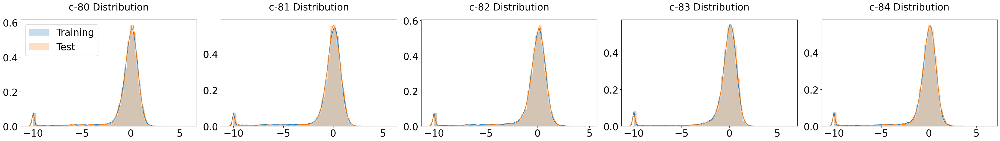

c-85 Train - Mean: -0.4093 - Median: -0.0024 - Std: 1.884 - Min: -10.0 - Max: 3.738 - Skew -3.468 - Kurt 13.4 - Var 3.549
c-85 Test - Mean: -0.3794 - Median: -0.00425 - Std: 1.887 - Min: -10.0 - Max: 4.455 - Skew -3.577 - Kurt 14.13 - Var 3.561

c-86 Train - Mean: -0.3331 - Median: 0.00785 - Std: 1.647 - Min: -10.0 - Max: 3.252 - Skew -3.322 - Kurt 13.36 - Var 2.713
c-86 Test - Mean: -0.309 - Median: 0.0333 - Std: 1.634 - Min: -10.0 - Max: 4.385 - Skew -3.459 - Kurt 14.34 - Var 2.668

c-87 Train - Mean: -0.295 - Median: -0.0056 - Std: 1.634 - Min: -10.0 - Max: 5.406 - Skew -3.69 - Kurt 16.65 - Var 2.67
c-87 Test - Mean: -0.2675 - Median: 0.012 - Std: 1.612 - Min: -10.0 - Max: 3.486 - Skew -3.8 - Kurt 17.55 - Var 2.599

c-88 Train - Mean: -0.3283 - Median: -0.0206 - Std: 1.663 - Min: -10.0 - Max: 3.11 - Skew -3.774 - Kurt 17.27 - Var 2.766
c-88 Test - Mean: -0.3206 - Median: 0.0151 - Std: 1.696 - Min: -10.0 - Max: 4.566 - Skew -3.748 - Kurt 16.78 - Var 2.875

c-89 Train - Mean: -0.4016 

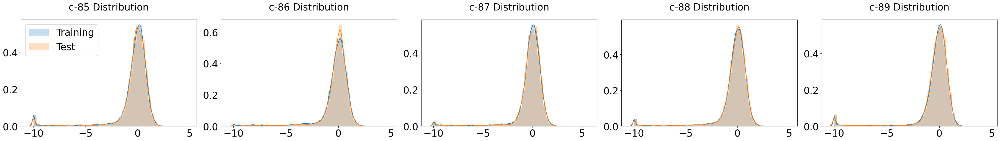

c-90 Train - Mean: -0.4692 - Median: -0.0099 - Std: 2.0 - Min: -10.0 - Max: 4.069 - Skew -3.335 - Kurt 11.81 - Var 4.002
c-90 Test - Mean: -0.43 - Median: 0.01005 - Std: 2.013 - Min: -10.0 - Max: 4.936 - Skew -3.454 - Kurt 12.47 - Var 4.052

c-91 Train - Mean: -0.4614 - Median: 0.00325 - Std: 2.042 - Min: -10.0 - Max: 3.96 - Skew -3.383 - Kurt 11.99 - Var 4.172
c-91 Test - Mean: -0.4132 - Median: 0.0109 - Std: 1.995 - Min: -10.0 - Max: 5.3 - Skew -3.546 - Kurt 13.36 - Var 3.981

c-92 Train - Mean: -0.5133 - Median: -0.0091 - Std: 2.002 - Min: -10.0 - Max: 3.927 - Skew -3.058 - Kurt 9.682 - Var 4.007
c-92 Test - Mean: -0.4758 - Median: 0.00655 - Std: 1.963 - Min: -10.0 - Max: 3.268 - Skew -3.193 - Kurt 10.57 - Var 3.854

c-93 Train - Mean: -0.5001 - Median: -0.01375 - Std: 2.107 - Min: -10.0 - Max: 3.596 - Skew -3.415 - Kurt 12.02 - Var 4.44
c-93 Test - Mean: -0.4625 - Median: 0.0175 - Std: 2.128 - Min: -10.0 - Max: 4.087 - Skew -3.484 - Kurt 12.33 - Var 4.529

c-94 Train - Mean: -0.507

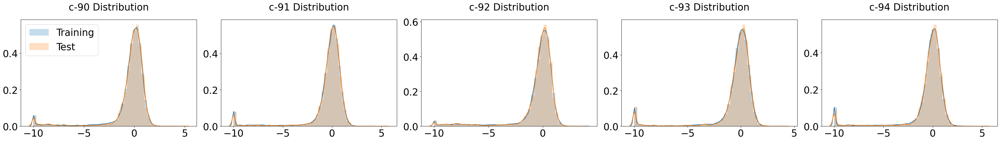

c-95 Train - Mean: -0.3537 - Median: -0.01025 - Std: 1.629 - Min: -10.0 - Max: 2.814 - Skew -3.424 - Kurt 14.32 - Var 2.654
c-95 Test - Mean: -0.3465 - Median: -0.02 - Std: 1.646 - Min: -10.0 - Max: 5.053 - Skew -3.461 - Kurt 14.61 - Var 2.708

c-96 Train - Mean: -0.4635 - Median: -0.00125 - Std: 2.06 - Min: -10.0 - Max: 3.505 - Skew -3.289 - Kurt 11.5 - Var 4.242
c-96 Test - Mean: -0.4239 - Median: 0.0438 - Std: 2.087 - Min: -10.0 - Max: 5.276 - Skew -3.357 - Kurt 11.88 - Var 4.354

c-97 Train - Mean: -0.3782 - Median: -0.0068 - Std: 1.704 - Min: -10.0 - Max: 2.924 - Skew -3.31 - Kurt 12.82 - Var 2.902
c-97 Test - Mean: -0.3164 - Median: 0.02045 - Std: 1.656 - Min: -10.0 - Max: 3.074 - Skew -3.51 - Kurt 14.56 - Var 2.74

c-98 Train - Mean: -0.4703 - Median: 0.014 - Std: 1.835 - Min: -10.0 - Max: 3.111 - Skew -2.982 - Kurt 10.14 - Var 3.366
c-98 Test - Mean: -0.4049 - Median: 0.03075 - Std: 1.791 - Min: -10.0 - Max: 3.859 - Skew -3.169 - Kurt 11.55 - Var 3.206

c-99 Train - Mean: -0.30

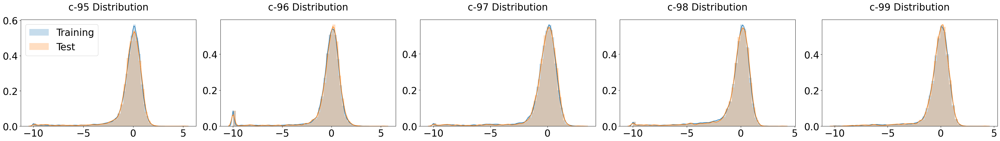

In [16]:
def distplot_cfeature(feature_group):
        
    fig, axes = plt.subplots(ncols=5, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 25
    label_size = 25

    for i, feature in enumerate(feature_group):
        sns.distplot(df_train[feature], label='Training', ax=axes[i], hist_kws={'alpha': 0.25})
        sns.distplot(df_test[feature], label='Test', ax=axes[i], hist_kws={'alpha': 0.25})
        axes[i].set_xlabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        if i % 5 == 0:
            axes[i].legend(prop={'size': 25})
            
        axes[i].set_title(f'{feature} Distribution', size=title_size, pad=title_size)
    
    plt.show()
    
for feature_group in np.array_split(c_features, len(c_features) // 5):
    
    for c_feature in feature_group: 
        train_mean = df_train[c_feature].mean()
        train_median = df_train[c_feature].median()
        train_std = df_train[c_feature].std()
        train_min = df_train[c_feature].min()
        train_max = df_train[c_feature].max()
        train_skew = skew(df_train[c_feature])
        train_kurt = kurtosis(df_train[c_feature])
        train_var = np.var(df_train[c_feature])

        test_mean = df_test[c_feature].mean()
        test_median = df_test[c_feature].median()
        test_std = df_test[c_feature].std()
        test_min = df_test[c_feature].min()
        test_max = df_test[c_feature].max()
        test_skew = skew(df_test[c_feature])
        test_kurt = kurtosis(df_test[c_feature])
        test_var = np.var(df_test[c_feature])

        print(f'{c_feature} Train - Mean: {train_mean:.4} - Median: {train_median:.4} - Std: {train_std:.4} - Min: {train_min:.4} - Max: {train_max:.4} - Skew {train_skew:.4} - Kurt {train_kurt:.4} - Var {train_var:.4}')
        print(f'{c_feature} Test - Mean: {test_mean:.4} - Median: {test_median:.4} - Std: {test_std:.4} - Min: {test_min:.4} - Max: {test_max:.4} - Skew {test_skew:.4} - Kurt {test_kurt:.4} - Var {test_var:.4}\n')

    distplot_cfeature(feature_group)


### **5.4. Cell Viability Feature Correlations**

Cell viability feature correlations are extremely high. This can be related to drug effects being similar on most cells lines. Lowest correlations (0.65) are the black lines which belong to `c-37`, `c-58`, `c-69`, `c-74` and `c-76` features due to their unusual distributions.

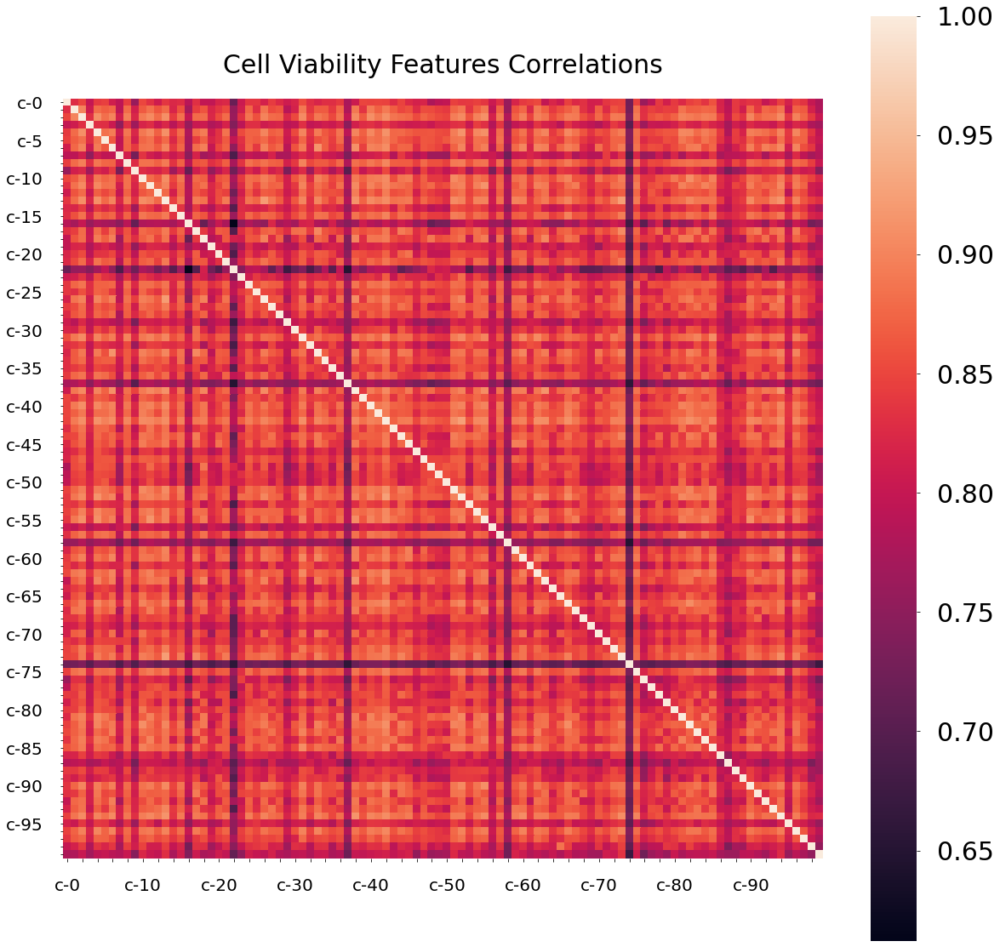

In [17]:
fig = plt.figure(figsize=(20, 20))

ax = sns.heatmap(df_train[c_features].corr(),
                 annot=False,
                 square=True)

ax.tick_params(axis='x', labelsize=20, rotation=0, pad=20)
ax.tick_params(axis='y', labelsize=20, rotation=0, pad=20)

for idx, label in enumerate(ax.get_xticklabels()):
    if idx % 5 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)
        
for idx, label in enumerate(ax.get_yticklabels()):
    if idx % 5 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)
        
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=30, pad=20)

plt.title('Cell Viability Features Correlations', size=30, pad=30)
plt.show()

## **6. Gene Expression**

### **6.1. Gene Expression Features**

Gene expression is the amount and type of proteins that are expressed in a cell at any given point in time. Gene expression level is based on a protocol similar to L1000 which is a high-throughput gene expression assay that measures the mRNA transcript abundance of 978 "landmark" genes from human cells. (The "L" in L1000 refers to the Landmark genes measured in the assay.)

There are 772 gene expression features and they have g- prefix (`g-0` to `g-771`). Each gene expression feature represents the expression of one particular gene, so there are 772 individual genes are being monitored in this assay.

In [18]:
df_train[(['sig_id'] + g_features)]

,sig_id,g-0,g-1,g-2,g-3,g-4,g-5,g-6,g-7,g-8,g-9,g-10,g-11,g-12,g-13,g-14,g-15,g-16,g-17,g-18,g-19,g-20,g-21,g-22,g-23,g-24,g-25,g-26,g-27,g-28,g-29,g-30,g-31,g-32,g-33,g-34,g-35,g-36,g-37,g-38,g-39,g-40,g-41,g-42,g-43,g-44,g-45,g-46,g-47,g-48,g-49,g-50,g-51,g-52,g-53,g-54,g-55,g-56,g-57,g-58,g-59,g-60,g-61,g-62,g-63,g-64,g-65,g-66,g-67,g-68,g-69,g-70,g-71,g-72,g-73,g-74,g-75,g-76,g-77,g-78,g-79,g-80,g-81,g-82,g-83,g-84,g-85,g-86,g-87,g-88,g-89,g-90,g-91,g-92,g-93,g-94,g-95,g-96,g-97,g-98,g-99,g-100,g-101,g-102,g-103,g-104,g-105,g-106,g-107,g-108,g-109,g-110,g-111,g-112,g-113,g-114,g-115,g-116,g-117,g-118,g-119,g-120,g-121,g-122,g-123,g-124,g-125,g-126,g-127,g-128,g-129,g-130,g-131,g-132,g-133,g-134,g-135,g-136,g-137,g-138,g-139,g-140,g-141,g-142,g-143,g-144,g-145,g-146,g-147,g-148,g-149,g-150,g-151,g-152,g-153,g-154,g-155,g-156,g-157,g-158,g-159,g-160,g-161,g-162,g-163,g-164,g-165,g-166,g-167,g-168,g-169,g-170,g-171,g-172,g-173,g-174,g-175,g-176,g-177,g-178,g-179,g-180,g-181,g-182,g-183,g-184,g-185,g-186,g-187,g-188,g-189,g-190,g-191,g-192,g-193,g-194,g-195,g-196,g-197,g-198,g-199,g-200,g-201,g-202,g-203,g-204,g-205,g-206,g-207,g-208,g-209,g-210,g-211,g-212,g-213,g-214,g-215,g-216,g-217,g-218,g-219,g-220,g-221,g-222,g-223,g-224,g-225,g-226,g-227,g-228,g-229,g-230,g-231,g-232,g-233,g-234,g-235,g-236,g-237,g-238,g-239,g-240,g-241,g-242,g-243,g-244,g-245,g-246,g-247,g-248,...,g-522,g-523,g-524,g-525,g-526,g-527,g-528,g-529,g-530,g-531,g-532,g-533,g-534,g-535,g-536,g-537,g-538,g-539,g-540,g-541,g-542,g-543,g-544,g-545,g-546,g-547,g-548,g-549,g-550,g-551,g-552,g-553,g-554,g-555,g-556,g-557,g-558,g-559,g-560,g-561,g-562,g-563,g-564,g-565,g-566,g-567,g-568,g-569,g-570,g-571,g-572,g-573,g-574,g-575,g-576,g-577,g-578,g-579,g-580,g-581,g-582,g-583,g-584,g-585,g-586,g-587,g-588,g-589,g-590,g-591,g-592,g-593,g-594,g-595,g-596,g-597,g-598,g-599,g-600,g-601,g-602,g-603,g-604,g-605,g-606,g-607,g-608,g-609,g-610,g-611,g-612,g-613,g-614,g-615,g-616,g-617,g-618,g-619,g-620,g-621,g-622,g-623,g-624,g-625,g-626,g-627,g-628,g-629,g-630,g-631,g-632,g-633,g-634,g-635,g-636,g-637,g-638,g-639,g-640,g-641,g-642,g-643,g-644,g-645,g-646,g-647,g-648,g-649,g-650,g-651,g-652,g-653,g-654,g-655,g-656,g-657,g-658,g-659,g-660,g-661,g-662,g-663,g-664,g-665,g-666,g-667,g-668,g-669,g-670,g-671,g-672,g-673,g-674,g-675,g-676,g-677,g-678,g-679,g-680,g-681,g-682,g-683,g-684,g-685,g-686,g-687,g-688,g-689,g-690,g-691,g-692,g-693,g-694,g-695,g-696,g-697,g-698,g-699,g-700,g-701,g-702,g-703,g-704,g-705,g-706,g-707,g-708,g-709,g-710,g-711,g-712,g-713,g-714,g-715,g-716,g-717,g-718,g-719,g-720,g-721,g-722,g-723,g-724,g-725,g-726,g-727,g-728,g-729,g-730,g-731,g-732,g-733,g-734,g-735,g-736,g-737,g-738,g-739,g-740,g-741,g-742,g-743,g-744,g-745,g-746,g-747,g-748,g-749,g-750,g-751,g-752,g-753,g-754,g-755,g-756,g-757,g-758,g-759,g-760,g-761,g-762,g-763,g-764,g-765,g-766,g-767,g-768,g-769,g-770,g-771
0,id_000644bb2,1.0620,0.5577,-0.2479,-0.6208,-0.1944,-1.0120,-1.0220,-0.0326,0.5548,-0.0921,1.1830,0.1530,0.5574,-0.4015,0.1789,-0.6528,-0.7969,0.6342,0.1778,-0.3694,-0.5688,-1.1360,-1.1880,0.6940,0.4393,0.2664,0.1907,0.1628,-0.2853,0.5819,0.2934,-0.5584,-0.0916,-0.3010,-0.1537,0.2198,0.2965,-0.5055,-0.5119,-0.2162,-0.0347,-0.2566,-1.1980,0.3116,-1.0330,0.2208,-0.1143,-0.0251,0.0350,0.4233,-0.1221,-0.4927,0.6119,0.4715,-0.0351,-0.1605,-0.6750,0.2263,0.5790,0.9588,0.6061,-0.1300,0.6611,-0.3136,-0.2020,0.0251,0.1670,-0.4195,0.6551,-0.7395,-0.7047,-0.5369,0.0314,-0.5239,-0.3406,-0.6332,-1.0330,-0.3763,-0.8550,0.7348,-0.2226,-0.1959,-0.0005,-2.1440,1.7320,0.0190,-0.1188,0.4050,-1.5840,-0.3011,0.2048,-1.1230,-1.5590,-1.7980,0.7017,-1.0390,0.0958,0.4527,0.5455,-0.0828,-0.5364,0.5522,-0.7768,-0.8044,-0.1181,-1.2560,0.1593,-0.6998,-1.7470,0.7120,-0.7635,-0.0290,1.2670,0.4734,-0.9902,0.4391,-0.1188,-0.0348,0.4676,1.9750,0.0545,1.2880,1.2260,0.0486,-0.8622,-1.2770,-0.1810,-0.2600,-0.5130,-0.0227,-0.2257,-0.7349,0.3116,-0.8774,0.3539,0.2833,-0.3501,-0.4372,-0.4646,-0.4940,0.5297,1.2420,-1.1870,0.43

### **6.2. Gene Expression and Target Interactions**

Random gene expression features are plotted against a random target feature because it is not possible to visualize 772x206 feature interactions. Gene expression features and targets have weaker relationships compared to cell viability features, because data points of positive target values are more spread along the x axis.

All gene expression features have one thing in common; positive target values are clustered around zero means just like cell viability features. High absolute values in gene expression features (>2 or <-2) indicate that the drug or perturbation had a significant effect on the current cell, whereas values close to zero mean means that the effect for that cell was non-measurable.

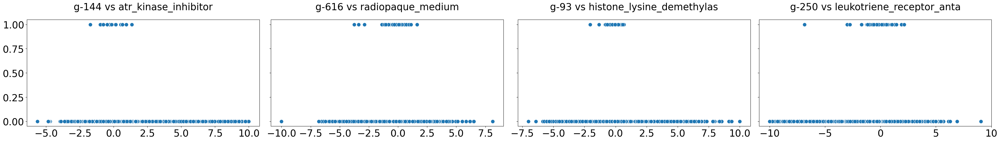

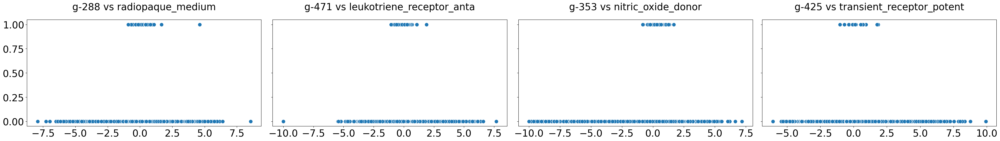

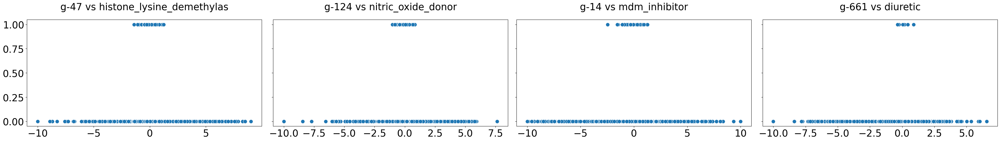

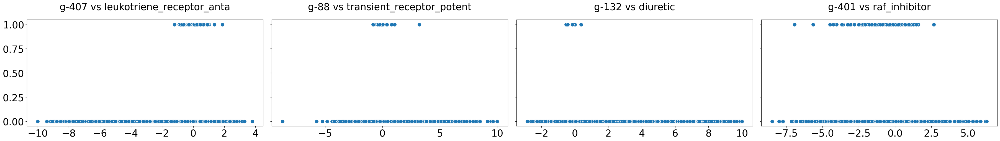

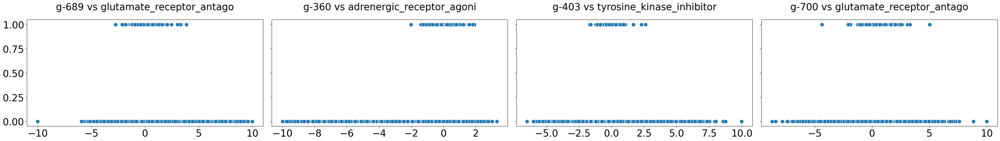

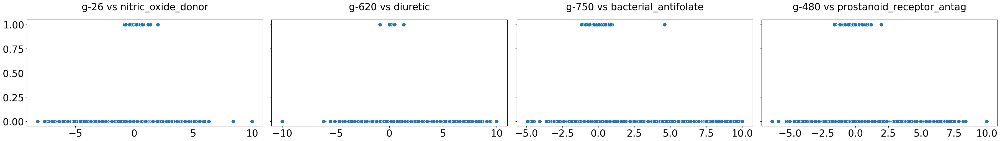

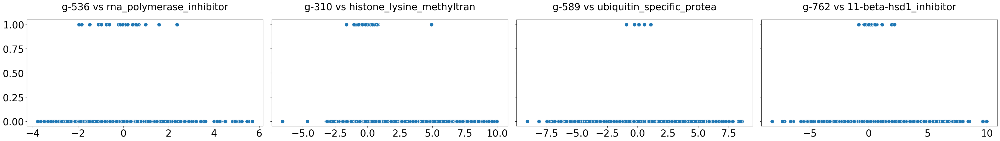

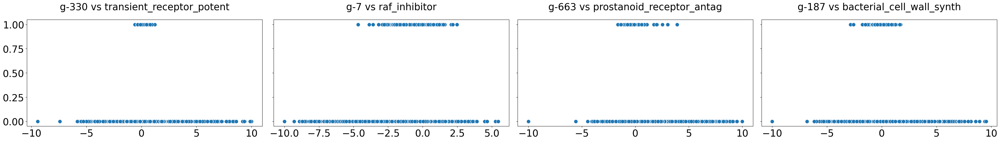

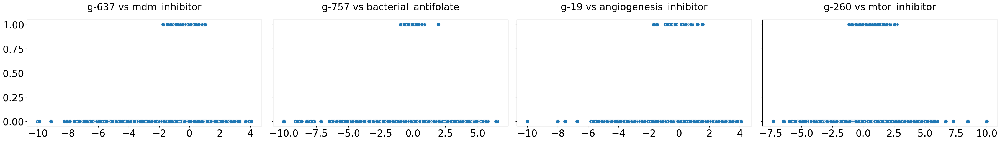

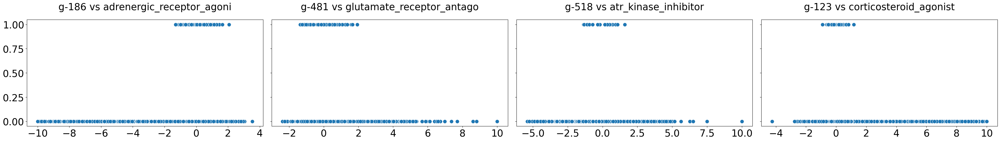

In [19]:
def scatterplot_gfeature(feature_group, seeds):
        
    fig, axes = plt.subplots(ncols=4, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 25
    label_size = 25

    for i, feature in enumerate(feature_group):
                
        np.random.seed(seeds[i])
        target = np.random.choice(target_features_scored)
        if len(target) > 25:
            target_title = target[:25]
        else:
            target_title = target
            
        sns.scatterplot(df_train[feature], df_train[target], s=100, ax=axes[i])
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        for label in axes[i].get_yticklabels():
            if i % 5 == 0:
                label.set_visible(True)
            else:
                label.set_visible(False)
                
        axes[i].set_title(f'{feature} vs {target_title}', size=title_size, pad=title_size)
    
    plt.show()
    
shuffled_g_features = np.copy(g_features)
np.random.shuffle(shuffled_g_features)
for i, feature_group in enumerate(np.array_split(shuffled_g_features, len(shuffled_g_features) // 4)[:10], 1):
    scatterplot_gfeature(feature_group, seeds=np.arange(1, 6) * i)

### **6.3. Gene Expression Feature Distributions**

Gene expression feature distributions are also very similar in training and test set, that's because, same quantile normalization and z-scoring steps used on cell viability features, are also applied to them at the plate level.

Gene expression feature distributions are more diverse than cell viability feature distributions. There are both left/right tailed and long/short tailed distributions exist.

g-454 Train - Mean: 0.05547 - Median: 0.0 - Std: 0.8487 - Min: -5.193 - Max: 10.0 - Skew 1.148 - Kurt 7.594 - Var 0.7202
g-454 Test - Mean: 0.04288 - Median: -0.0043 - Std: 0.7945 - Min: -5.778 - Max: 5.219 - Skew 0.8827 - Kurt 4.814 - Var 0.631

g-710 Train - Mean: 0.1539 - Median: 0.01895 - Std: 1.002 - Min: -6.876 - Max: 10.0 - Skew 2.538 - Kurt 14.06 - Var 1.003
g-710 Test - Mean: 0.1424 - Median: 0.01835 - Std: 0.9901 - Min: -3.307 - Max: 8.92 - Skew 2.526 - Kurt 12.76 - Var 0.9801

g-395 Train - Mean: 0.009859 - Median: 0.0047 - Std: 1.225 - Min: -9.947 - Max: 10.0 - Skew 0.297 - Kurt 9.785 - Var 1.5
g-395 Test - Mean: 0.03436 - Median: 0.0312 - Std: 1.194 - Min: -9.524 - Max: 9.782 - Skew 0.4666 - Kurt 9.33 - Var 1.425

g-323 Train - Mean: -0.05558 - Median: -0.017 - Std: 1.091 - Min: -9.372 - Max: 6.597 - Skew -0.4875 - Kurt 3.536 - Var 1.191
g-323 Test - Mean: -0.07609 - Median: -0.02295 - Std: 1.059 - Min: -6.108 - Max: 6.205 - Skew -0.7073 - Kurt 3.506 - Var 1.121



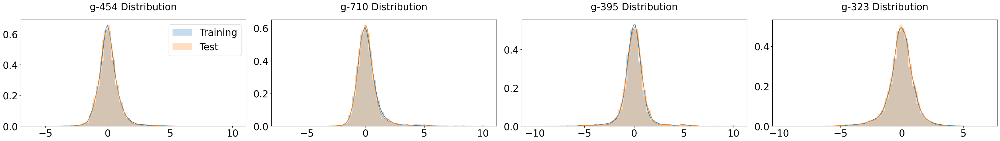

g-563 Train - Mean: -0.02049 - Median: 0.0222 - Std: 1.123 - Min: -8.517 - Max: 10.0 - Skew -0.2524 - Kurt 10.52 - Var 1.26
g-563 Test - Mean: -0.03413 - Median: 0.00625 - Std: 1.105 - Min: -7.708 - Max: 8.403 - Skew -0.3163 - Kurt 9.081 - Var 1.22

g-370 Train - Mean: -0.6484 - Median: 0.0 - Std: 1.581 - Min: -10.0 - Max: 3.247 - Skew -2.049 - Kurt 4.504 - Var 2.498
g-370 Test - Mean: -0.6403 - Median: 0.0 - Std: 1.612 - Min: -10.0 - Max: 2.076 - Skew -2.118 - Kurt 4.841 - Var 2.597

g-634 Train - Mean: 0.05858 - Median: -0.0182 - Std: 0.9795 - Min: -10.0 - Max: 6.911 - Skew 0.0862 - Kurt 6.26 - Var 0.9593
g-634 Test - Mean: 0.04951 - Median: -0.0269 - Std: 0.9752 - Min: -5.921 - Max: 5.47 - Skew 0.08357 - Kurt 6.69 - Var 0.9508

g-697 Train - Mean: 0.1147 - Median: 0.02485 - Std: 1.163 - Min: -10.0 - Max: 10.0 - Skew 2.512 - Kurt 16.24 - Var 1.352
g-697 Test - Mean: 0.1058 - Median: 0.00915 - Std: 1.068 - Min: -5.12 - Max: 10.0 - Skew 2.478 - Kurt 16.4 - Var 1.14



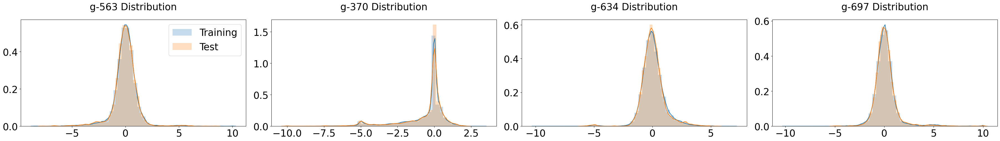

g-535 Train - Mean: 0.1417 - Median: 0.0163 - Std: 1.097 - Min: -5.314 - Max: 10.0 - Skew 2.846 - Kurt 19.1 - Var 1.203
g-535 Test - Mean: 0.1067 - Median: 0.0 - Std: 1.059 - Min: -4.58 - Max: 10.0 - Skew 2.463 - Kurt 15.87 - Var 1.121

g-760 Train - Mean: -0.4006 - Median: 0.00735 - Std: 1.913 - Min: -10.0 - Max: 4.008 - Skew -3.362 - Kurt 12.38 - Var 3.661
g-760 Test - Mean: -0.3623 - Median: 0.02825 - Std: 1.906 - Min: -10.0 - Max: 3.347 - Skew -3.452 - Kurt 13.01 - Var 3.631

g-520 Train - Mean: -0.1132 - Median: 0.0094 - Std: 1.09 - Min: -10.0 - Max: 3.874 - Skew -1.732 - Kurt 6.922 - Var 1.187
g-520 Test - Mean: -0.1162 - Median: -0.004 - Std: 1.056 - Min: -6.701 - Max: 4.115 - Skew -1.49 - Kurt 5.367 - Var 1.114

g-446 Train - Mean: -0.08307 - Median: 0.0 - Std: 0.9557 - Min: -10.0 - Max: 6.975 - Skew -1.391 - Kurt 8.06 - Var 0.9134
g-446 Test - Mean: -0.05322 - Median: 0.00935 - Std: 0.9133 - Min: -6.383 - Max: 4.429 - Skew -1.189 - Kurt 5.975 - Var 0.8339



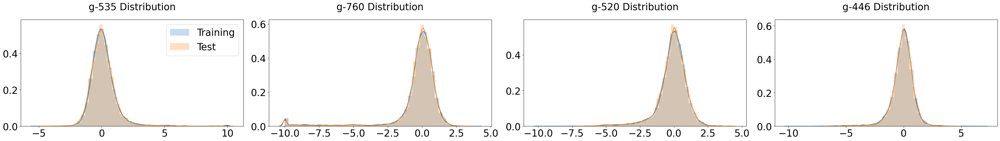

g-414 Train - Mean: -0.1739 - Median: 0.01595 - Std: 1.289 - Min: -10.0 - Max: 10.0 - Skew -1.967 - Kurt 8.786 - Var 1.661
g-414 Test - Mean: -0.1348 - Median: 0.0332 - Std: 1.18 - Min: -7.802 - Max: 8.351 - Skew -1.683 - Kurt 7.569 - Var 1.391

g-429 Train - Mean: -0.1786 - Median: -0.0221 - Std: 1.213 - Min: -10.0 - Max: 5.439 - Skew -1.883 - Kurt 7.612 - Var 1.472
g-429 Test - Mean: -0.1555 - Median: -0.0132 - Std: 1.187 - Min: -8.93 - Max: 4.98 - Skew -2.013 - Kurt 8.53 - Var 1.409

g-630 Train - Mean: -0.122 - Median: 0.00385 - Std: 1.106 - Min: -10.0 - Max: 10.0 - Skew -1.873 - Kurt 8.996 - Var 1.223
g-630 Test - Mean: -0.1117 - Median: 0.01605 - Std: 1.067 - Min: -10.0 - Max: 4.723 - Skew -2.105 - Kurt 9.632 - Var 1.138

g-528 Train - Mean: 0.09187 - Median: 0.00555 - Std: 0.9406 - Min: -9.237 - Max: 10.0 - Skew 0.8306 - Kurt 5.571 - Var 0.8846
g-528 Test - Mean: 0.05177 - Median: -0.0036 - Std: 0.9153 - Min: -5.974 - Max: 5.565 - Skew 0.5705 - Kurt 4.179 - Var 0.8375



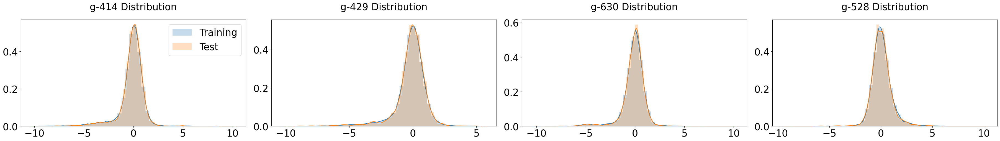

g-132 Train - Mean: 0.2049 - Median: 0.0 - Std: 1.143 - Min: -2.849 - Max: 10.0 - Skew 4.417 - Kurt 26.8 - Var 1.307
g-132 Test - Mean: 0.2092 - Median: 0.0 - Std: 1.144 - Min: -2.162 - Max: 10.0 - Skew 4.411 - Kurt 26.59 - Var 1.308

g-137 Train - Mean: -0.03139 - Median: 0.01545 - Std: 1.106 - Min: -9.757 - Max: 8.064 - Skew -0.9343 - Kurt 6.455 - Var 1.223
g-137 Test - Mean: -0.01377 - Median: 0.0302 - Std: 1.101 - Min: -6.893 - Max: 5.387 - Skew -0.937 - Kurt 5.891 - Var 1.212

g-71 Train - Mean: -0.1345 - Median: -0.0429 - Std: 0.8936 - Min: -10.0 - Max: 4.584 - Skew -1.242 - Kurt 5.689 - Var 0.7984
g-71 Test - Mean: -0.1156 - Median: -0.02165 - Std: 0.8746 - Min: -5.491 - Max: 3.477 - Skew -1.173 - Kurt 4.304 - Var 0.7648

g-472 Train - Mean: 0.06135 - Median: 0.02385 - Std: 0.871 - Min: -7.532 - Max: 10.0 - Skew 0.9077 - Kurt 6.154 - Var 0.7587
g-472 Test - Mean: 0.07663 - Median: 0.04995 - Std: 0.8577 - Min: -5.736 - Max: 10.0 - Skew 0.8445 - Kurt 8.845 - Var 0.7355



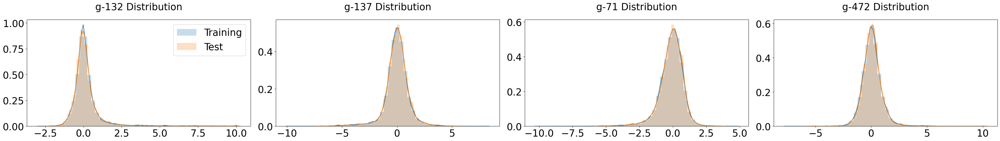

g-361 Train - Mean: 0.09731 - Median: -0.0149 - Std: 1.035 - Min: -10.0 - Max: 10.0 - Skew 1.354 - Kurt 6.352 - Var 1.072
g-361 Test - Mean: 0.07231 - Median: -0.0555 - Std: 1.06 - Min: -6.311 - Max: 7.993 - Skew 1.776 - Kurt 7.466 - Var 1.124

g-232 Train - Mean: 0.1705 - Median: 0.0007 - Std: 1.171 - Min: -5.493 - Max: 10.0 - Skew 2.925 - Kurt 14.78 - Var 1.372
g-232 Test - Mean: 0.2087 - Median: 0.00875 - Std: 1.254 - Min: -2.52 - Max: 10.0 - Skew 3.233 - Kurt 16.07 - Var 1.571

g-15 Train - Mean: -0.02443 - Median: 0.0 - Std: 0.6598 - Min: -10.0 - Max: 4.134 - Skew -0.5687 - Kurt 4.42 - Var 0.4354
g-15 Test - Mean: -0.02113 - Median: 0.0 - Std: 0.6391 - Min: -3.995 - Max: 2.872 - Skew -0.3439 - Kurt 1.537 - Var 0.4083

g-144 Train - Mean: 0.275 - Median: 0.00295 - Std: 1.459 - Min: -5.633 - Max: 10.0 - Skew 3.054 - Kurt 13.19 - Var 2.128
g-144 Test - Mean: 0.2383 - Median: -0.00745 - Std: 1.403 - Min: -3.245 - Max: 10.0 - Skew 3.117 - Kurt 13.67 - Var 1.967



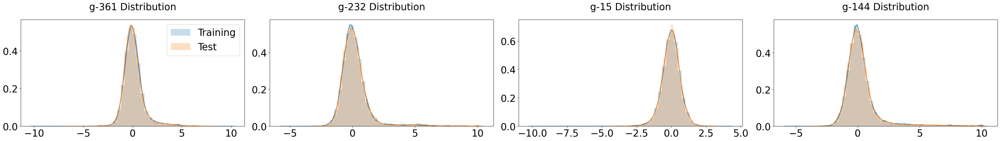

g-110 Train - Mean: -0.09174 - Median: -0.0108 - Std: 0.9037 - Min: -10.0 - Max: 4.489 - Skew -1.446 - Kurt 7.464 - Var 0.8166
g-110 Test - Mean: -0.05023 - Median: 0.0 - Std: 0.8698 - Min: -10.0 - Max: 5.045 - Skew -1.455 - Kurt 9.938 - Var 0.7563

g-448 Train - Mean: 0.02051 - Median: -0.00385 - Std: 0.9613 - Min: -10.0 - Max: 9.82 - Skew 0.2714 - Kurt 9.419 - Var 0.9241
g-448 Test - Mean: -0.008853 - Median: -0.01025 - Std: 0.9008 - Min: -6.926 - Max: 6.895 - Skew -0.07598 - Kurt 6.163 - Var 0.8113

g-0 Train - Mean: 0.2484 - Median: -0.00885 - Std: 1.393 - Min: -5.513 - Max: 10.0 - Skew 2.79 - Kurt 11.33 - Var 1.941
g-0 Test - Mean: 0.1975 - Median: -0.0607 - Std: 1.373 - Min: -5.321 - Max: 10.0 - Skew 2.946 - Kurt 12.25 - Var 1.886

g-638 Train - Mean: -0.1794 - Median: -0.0211 - Std: 1.144 - Min: -10.0 - Max: 5.519 - Skew -2.58 - Kurt 13.6 - Var 1.31
g-638 Test - Mean: -0.1998 - Median: -0.023 - Std: 1.155 - Min: -10.0 - Max: 4.278 - Skew -2.649 - Kurt 13.09 - Var 1.333



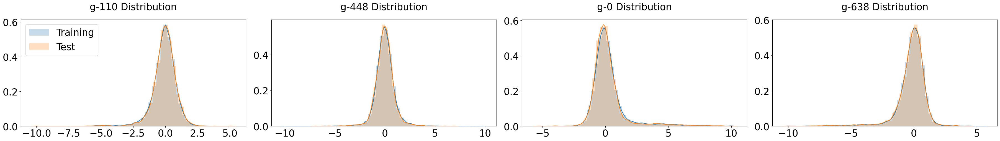

g-20 Train - Mean: -0.1119 - Median: -0.0028 - Std: 1.22 - Min: -10.0 - Max: 9.842 - Skew -1.504 - Kurt 8.553 - Var 1.487
g-20 Test - Mean: -0.1154 - Median: 0.02235 - Std: 1.169 - Min: -10.0 - Max: 6.833 - Skew -1.665 - Kurt 9.664 - Var 1.366

g-158 Train - Mean: 0.4721 - Median: -0.0245 - Std: 1.955 - Min: -5.113 - Max: 10.0 - Skew 2.754 - Kurt 8.627 - Var 3.822
g-158 Test - Mean: 0.3815 - Median: -0.048 - Std: 1.844 - Min: -5.461 - Max: 10.0 - Skew 2.857 - Kurt 9.528 - Var 3.398

g-508 Train - Mean: -0.6417 - Median: -0.05065 - Std: 1.934 - Min: -10.0 - Max: 5.268 - Skew -2.485 - Kurt 7.183 - Var 3.741
g-508 Test - Mean: -0.6213 - Median: -0.0347 - Std: 1.906 - Min: -10.0 - Max: 2.68 - Skew -2.493 - Kurt 7.258 - Var 3.63

g-147 Train - Mean: 0.3405 - Median: -0.0057 - Std: 1.637 - Min: -4.137 - Max: 10.0 - Skew 3.355 - Kurt 13.5 - Var 2.68
g-147 Test - Mean: 0.3048 - Median: -0.0221 - Std: 1.618 - Min: -4.91 - Max: 10.0 - Skew 3.51 - Kurt 14.75 - Var 2.618



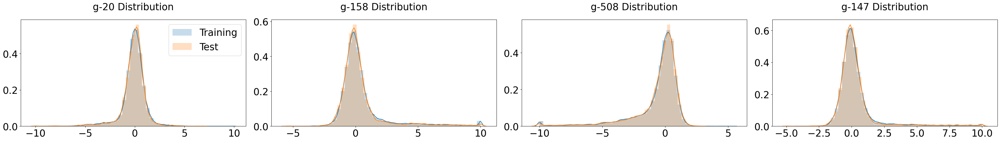

g-703 Train - Mean: -0.02907 - Median: 0.0876 - Std: 1.438 - Min: -10.0 - Max: 5.807 - Skew -1.934 - Kurt 8.882 - Var 2.068
g-703 Test - Mean: 0.008667 - Median: 0.1129 - Std: 1.383 - Min: -10.0 - Max: 5.414 - Skew -1.737 - Kurt 7.761 - Var 1.911

g-93 Train - Mean: 0.09482 - Median: 0.01635 - Std: 1.075 - Min: -7.006 - Max: 10.0 - Skew 1.025 - Kurt 7.514 - Var 1.155
g-93 Test - Mean: 0.08365 - Median: 0.0075 - Std: 1.041 - Min: -5.613 - Max: 8.993 - Skew 1.159 - Kurt 7.667 - Var 1.084

g-397 Train - Mean: 0.01903 - Median: 0.0 - Std: 0.9904 - Min: -6.995 - Max: 10.0 - Skew 0.7818 - Kurt 10.91 - Var 0.9809
g-397 Test - Mean: 0.02554 - Median: 0.00935 - Std: 0.9169 - Min: -5.539 - Max: 8.043 - Skew 0.6752 - Kurt 9.592 - Var 0.8405

g-287 Train - Mean: -0.06585 - Median: 0.01865 - Std: 1.119 - Min: -10.0 - Max: 8.208 - Skew -1.16 - Kurt 6.929 - Var 1.252
g-287 Test - Mean: -0.0737 - Median: 0.02165 - Std: 1.069 - Min: -9.288 - Max: 5.552 - Skew -1.551 - Kurt 8.576 - Var 1.143



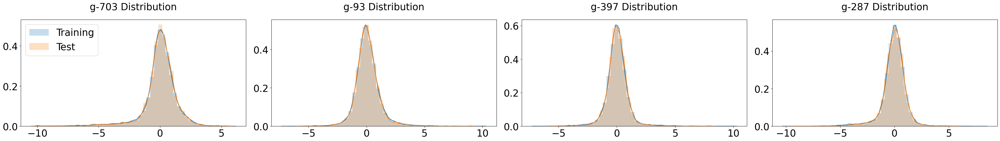

g-457 Train - Mean: 0.09774 - Median: 0.0249 - Std: 1.13 - Min: -7.896 - Max: 10.0 - Skew 1.019 - Kurt 8.261 - Var 1.278
g-457 Test - Mean: 0.1244 - Median: 0.0457 - Std: 1.114 - Min: -5.137 - Max: 10.0 - Skew 1.451 - Kurt 8.536 - Var 1.24

g-677 Train - Mean: -0.1539 - Median: -0.0207 - Std: 1.193 - Min: -10.0 - Max: 6.987 - Skew -2.176 - Kurt 12.28 - Var 1.422
g-677 Test - Mean: -0.1199 - Median: 0.007 - Std: 1.166 - Min: -10.0 - Max: 5.539 - Skew -1.914 - Kurt 10.54 - Var 1.359

g-239 Train - Mean: -0.2754 - Median: -0.08005 - Std: 1.205 - Min: -10.0 - Max: 5.511 - Skew -1.64 - Kurt 6.189 - Var 1.451
g-239 Test - Mean: -0.2502 - Median: -0.0398 - Std: 1.185 - Min: -9.13 - Max: 3.425 - Skew -1.545 - Kurt 4.913 - Var 1.404

g-120 Train - Mean: -0.0805 - Median: -0.03435 - Std: 0.9878 - Min: -8.56 - Max: 7.817 - Skew -0.4153 - Kurt 3.952 - Var 0.9757
g-120 Test - Mean: -0.1151 - Median: -0.0706 - Std: 0.9722 - Min: -5.519 - Max: 6.341 - Skew -0.3289 - Kurt 3.317 - Var 0.9449



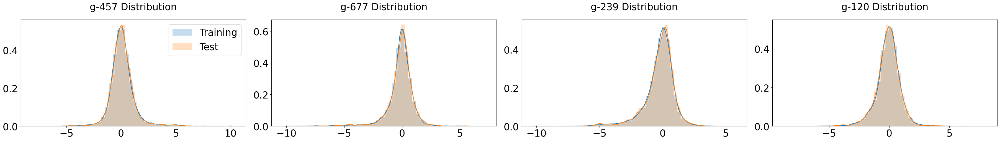

In [20]:
def distplot_gfeature(feature_group):
        
    fig, axes = plt.subplots(ncols=4, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 25
    label_size = 25

    for i, feature in enumerate(feature_group):
        sns.distplot(df_train[feature], label='Training', ax=axes[i], hist_kws={'alpha': 0.25})
        sns.distplot(df_test[feature], label='Test', ax=axes[i], hist_kws={'alpha': 0.25})
        axes[i].set_xlabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        if i % 5 == 0:
            axes[i].legend(prop={'size': 25})
            
        axes[i].set_title(f'{feature} Distribution', size=title_size, pad=title_size)
    
    plt.show()

shuffled_g_features = np.copy(g_features)
np.random.shuffle(shuffled_g_features)
for feature_group in np.array_split(shuffled_g_features, len(shuffled_g_features) // 4)[:10]:
    
    for c_feature in feature_group: 
        train_mean = df_train[c_feature].mean()
        train_median = df_train[c_feature].median()
        train_std = df_train[c_feature].std()
        train_min = df_train[c_feature].min()
        train_max = df_train[c_feature].max()
        train_skew = skew(df_train[c_feature])
        train_kurt = kurtosis(df_train[c_feature])
        train_var = np.var(df_train[c_feature])

        test_mean = df_test[c_feature].mean()
        test_median = df_test[c_feature].median()
        test_std = df_test[c_feature].std()
        test_min = df_test[c_feature].min()
        test_max = df_test[c_feature].max()
        test_skew = skew(df_test[c_feature])
        test_kurt = kurtosis(df_test[c_feature])
        test_var = np.var(df_test[c_feature])

        print(f'{c_feature} Train - Mean: {train_mean:.4} - Median: {train_median:.4} - Std: {train_std:.4} - Min: {train_min:.4} - Max: {train_max:.4} - Skew {train_skew:.4} - Kurt {train_kurt:.4} - Var {train_var:.4}')
        print(f'{c_feature} Test - Mean: {test_mean:.4} - Median: {test_median:.4} - Std: {test_std:.4} - Min: {test_min:.4} - Max: {test_max:.4} - Skew {test_skew:.4} - Kurt {test_kurt:.4} - Var {test_var:.4}\n')

    distplot_gfeature(feature_group)


### **6.4. Gene Expression Feature Correlations**

Gene expression feature correlations are more diverse compared to cell viability feature correlations. Correlation coefficients vary from -0.75 to 1, because of different distribution types.

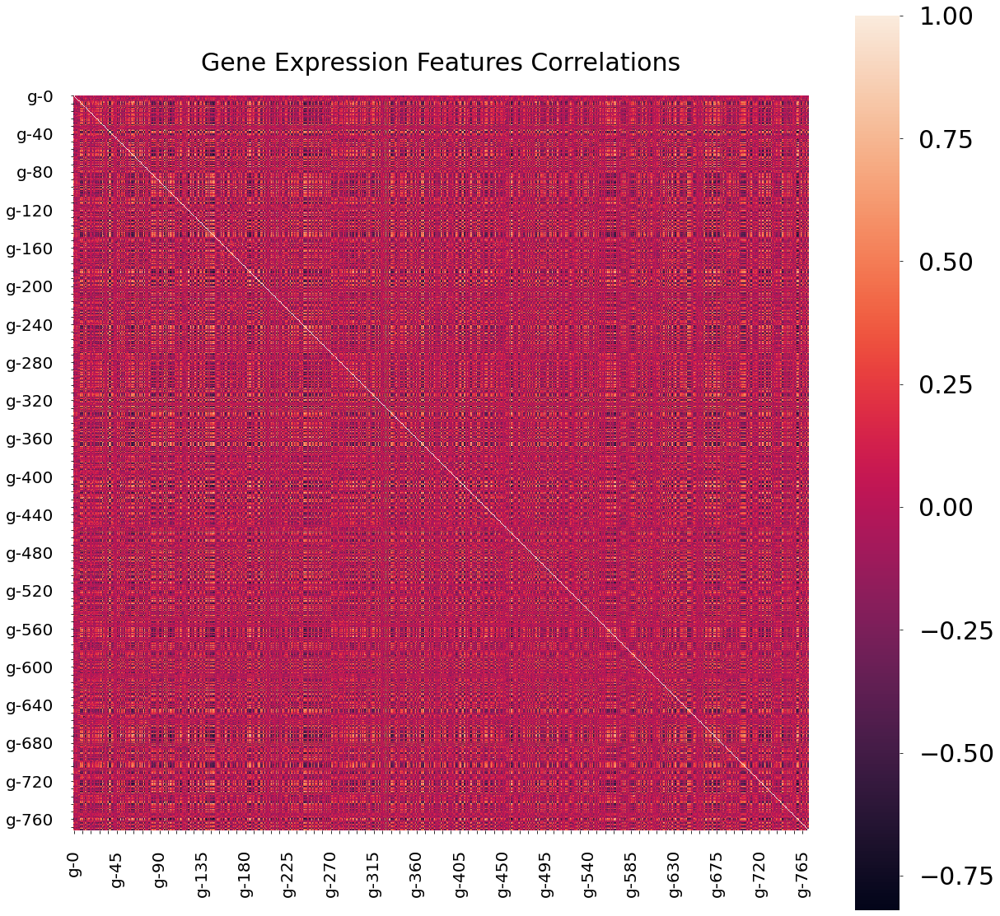

In [21]:
fig = plt.figure(figsize=(20, 20))

ax = sns.heatmap(df_train[g_features].corr(),
                 annot=False,
                 square=True)

ax.tick_params(axis='x', labelsize=20, rotation=90, pad=20)
ax.tick_params(axis='y', labelsize=20, rotation=0, pad=20)

for idx, label in enumerate(ax.get_xticklabels()):
    if idx % 5 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)
        
for idx, label in enumerate(ax.get_yticklabels()):
    if idx % 5 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)
        
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=30, pad=20)

plt.title('Gene Expression Features Correlations', size=30, pad=30)
plt.show()

## **7. Feature Selection**

### **7.1. Adversarial Validation**

Categorical features; `cp_type`, `cp_time` and `cp_dose` are omitted in adversarial validation. Only gene expression and cell viability features are used. A ROC AUC score between **0.5** and **0.55** is expected from adversarial validation model because gene expression and cell viability features are normalized before training and test sets are splitted.

In [22]:
df_train['target'] = 0
df_test['target'] = 1

X = pd.concat([df_train.loc[:, g_features + c_features], df_test.loc[:, g_features + c_features]]).reset_index(drop=True)
y = pd.concat([df_train.loc[:, 'target'], df_test.loc[:, 'target']]).reset_index(drop=True)

Adversarial validation model yields **0.5275** ROC AUC score which suggests that training and public test set are similar. Features at the top of importance plot have higher gain, because they have different means in training and public test set due to distribution tail extremities. This could be related to small sample size of public test set, and it's not necessarily have to be expected in private test set.

Running LightGBM Adversarial Validation Model
---------------------------------------------

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.946739	valid_1's auc: 0.4858
Early stopping, best iteration is:
[1]	training's auc: 0.553633	valid_1's auc: 0.504964

Fold 1 - ROC AUC Score 0.504964

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.949726	valid_1's auc: 0.514462
Early stopping, best iteration is:
[29]	training's auc: 0.897961	valid_1's auc: 0.519444

Fold 2 - ROC AUC Score 0.519444

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.944923	valid_1's auc: 0.509793
Early stopping, best iteration is:
[3]	training's auc: 0.639352	valid_1's auc: 0.516931

Fold 3 - ROC AUC Score 0.516931

Training until validation scores don't improve for 50 rounds
[50]	training's auc: 0.949341	valid_1's auc: 0.520363
Early stopping, best iteration is:
[12]	training's auc: 0.787275	valid_1's auc: 0.

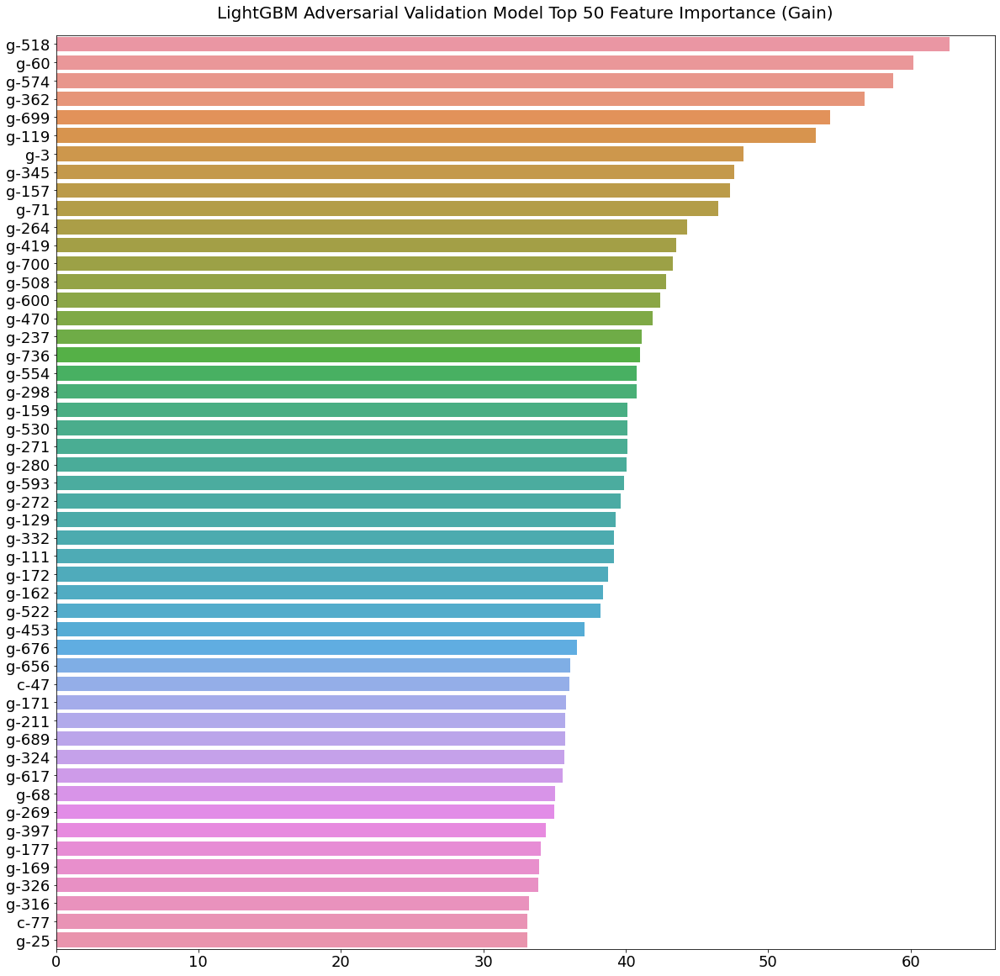

In [23]:
K = 5
skf = StratifiedKFold(n_splits=K, shuffle=True, random_state=SEED)

scores = []
oof_predictions = pd.DataFrame(np.zeros((X.shape[0], 1)), columns=['target'])
feature_importance = pd.DataFrame(np.zeros((X.shape[1], K)), columns=[f'Fold_{i}_Importance' for i in range(1, K + 1)], index=X.columns)

parameters = {
    'num_iterations': 500,
    'early_stopping_round': 50,
    'num_leaves': 2 ** 5, 
    'learning_rate': 0.05,
    'bagging_fraction': 0.9,
    'bagging_freq': 1,
    'feature_fraction': 0.9,
    'feature_fraction_bynode': 0.9,
    'lambda_l1': 0,
    'lambda_l2': 0,
    'max_depth': -1,
    'objective': 'binary',
    'seed': SEED,
    'feature_fraction_seed': SEED,
    'bagging_seed': SEED,
    'drop_seed': SEED,
    'data_random_seed': SEED,
    'boosting_type': 'gbdt',
    'verbose': 1,
    'metric': 'auc',
    'n_jobs': -1,   
}

print('Running LightGBM Adversarial Validation Model\n' + ('-' * 45) + '\n')

for fold, (trn_idx, val_idx) in enumerate(skf.split(X, y), 1):

    trn_data = lgb.Dataset(X.iloc[trn_idx, :], label=y.iloc[trn_idx])
    val_data = lgb.Dataset(X.iloc[val_idx, :], label=y.iloc[val_idx])      
    model = lgb.train(parameters, trn_data, valid_sets=[trn_data, val_data], verbose_eval=50)
    feature_importance.iloc[:, fold - 1] = model.feature_importance(importance_type='gain')

    predictions = model.predict(X.iloc[val_idx, :], num_iteration=model.best_iteration)
    oof_predictions.loc[val_idx, 'target'] = predictions
    
    score = roc_auc_score(y.iloc[val_idx], predictions)
    scores.append(score)            
    print(f'\nFold {fold} - ROC AUC Score {score:.6}\n')
    
oof_score = roc_auc_score(y, oof_predictions)
print(f'\n{"-" * 30}\nLightGBM Adversarial Validation Model Mean ROC AUC Score {np.mean(scores):.6} [STD:{np.std(scores):.6}]')
print(f'LightGBM Adversarial Validation Model OOF ROC AUC Score: {oof_score:.6}\n{"-" * 30}')


plt.figure(figsize=(20, 20))
feature_importance['Mean_Importance'] = feature_importance.sum(axis=1) / K
feature_importance.sort_values(by='Mean_Importance', inplace=True, ascending=False)
sns.barplot(x='Mean_Importance', y=feature_importance.index[:50], data=feature_importance[:50])

plt.xlabel('')
plt.tick_params(axis='x', labelsize=18)
plt.tick_params(axis='y', labelsize=18)
plt.title('LightGBM Adversarial Validation Model Top 50 Feature Importance (Gain)', size=20, pad=20)

plt.show()

del X, y, oof_predictions, feature_importance, parameters, scores, oof_score

### **7.2. Variance Threshold**

Another approach for feature selection is eliminating features that have lower variance than a predefined threshold. Variance is the average of the squared differences from the mean, so it measures how far the data points are spread out from the mean. If the variance is low or close to zero, then a feature is approximately constant and will not improve the performances of the models. In that case, it should be removed.

Variances of continuous features are calculated for training and test set together, because they could yield different results if they are calculated separately. There are lots of low variance features that can be seen from below, but they are not close to zero.

In [24]:
df_all = pd.concat([df_train[c_features + g_features], df_test[c_features + g_features]], axis=0, ignore_index=True).astype(np.float32)

variances = {}

for feature in df_all.columns:
    variances[feature] = df_all[feature].var()
    
del df_all

df_variances = pd.DataFrame.from_dict(variances, orient='index', columns=['Variance'])
df_variances['Variance'] = df_variances['Variance'].astype(np.float32)
df_variances.sort_values(by='Variance', ascending=True, inplace=True)
df_variances.head(10)

,Variance
g-219,0.335910
g-307,0.358423
g-104,0.383023
g-550,0.387926
g-331,0.400056
g-15,0.431510
g-481,0.431620
g-435,0.435874
g-536,0.464250
g-611,0.482230


Feature distributions are visualized from low to high variance. Features with variance between 0.3 and 0.4 can be removed since they contain the least information. For other ranges, feature removal should be done with trial and error based on model performances.

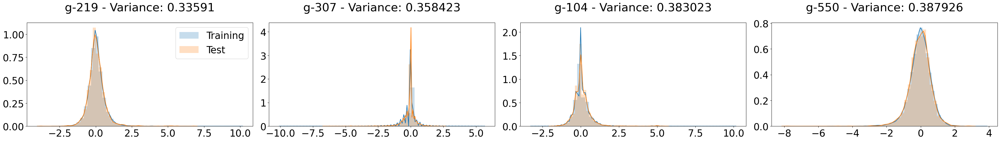

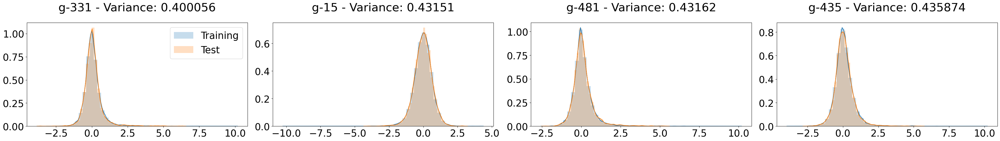

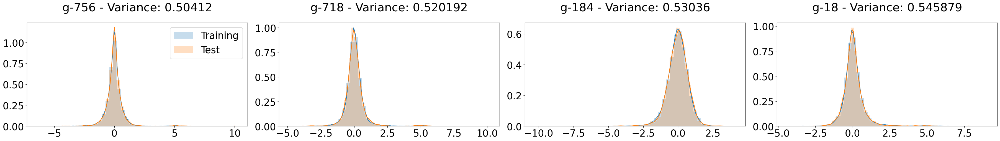

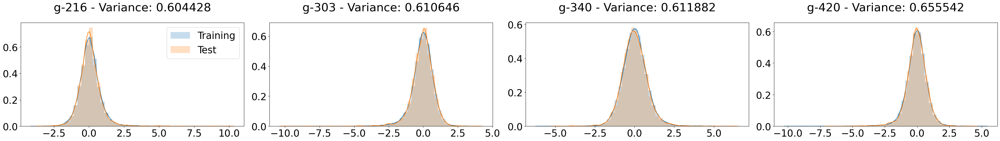

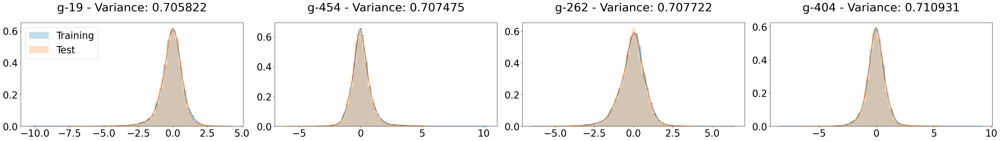

...

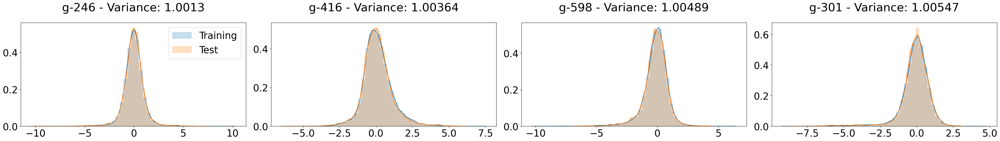

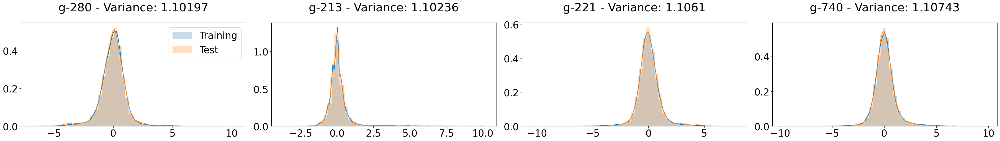

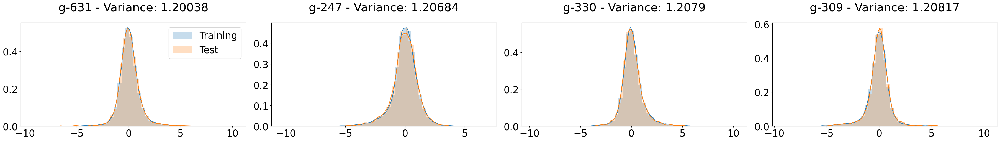

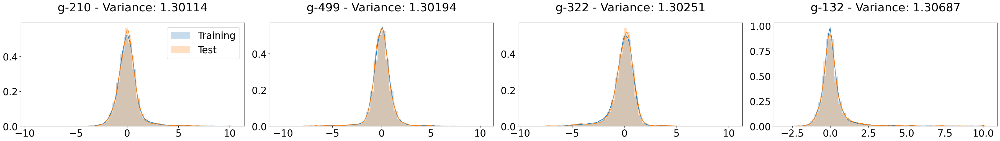

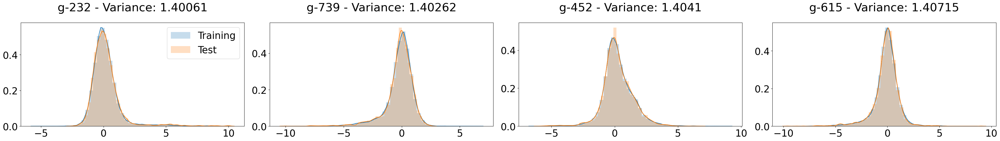

In [25]:
def distplot_variances(feature_group):
        
    fig, axes = plt.subplots(ncols=4, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 30
    label_size = 25

    for i, feature in enumerate(feature_group):
        sns.distplot(df_train[feature], label='Training', ax=axes[i], hist_kws={'alpha': 0.25})
        sns.distplot(df_test[feature], label='Test', ax=axes[i], hist_kws={'alpha': 0.25})
        axes[i].set_xlabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        if i % 4 == 0:
            axes[i].legend(prop={'size': 25})
            
        axes[i].set_title(f'{feature} - Variance: {df_variances.loc[feature, "Variance"]:.6}', size=title_size, pad=title_size)
    
    plt.show()
    
for i in np.arange(0.3, 1.5, 0.1):
    feature_group = list(df_variances.loc[(df_variances['Variance'] >= i) & (df_variances['Variance'] < (i + 0.1)), 'Variance'].index)[:4]
    distplot_variances(feature_group)

## **8. Feature Scaling**

It can seen from the prior visualizations that continuous features are between different ranges. Feature scaling can both improve model performance and speed up convergence at the same time. In order to observe scaling effects of different scalers, 25 cell viability and 25 gene expression features are randomly selected and scaled with `StandardScaler`, `MinMaxScaler`, and `GaussRankScaler`.

In [26]:
df_all = pd.concat([df_train[c_features + g_features], df_test[c_features + g_features]], axis=0, ignore_index=True).astype(np.float32)

np.random.seed(SEED)
scale_features = list(np.random.choice(c_features, 25, replace=False)) + list(np.random.choice(g_features, 25, replace=False))

df_scaled = df_all.loc[:, scale_features]
del df_all

mms = MinMaxScaler()
ss = StandardScaler()
grs = GaussRankScaler()

for feature in scale_features:
    df_scaled[f'{feature}_mms'] = mms.fit_transform(df_scaled[feature].values.reshape(-1, 1))
    df_scaled[f'{feature}_ss'] = ss.fit_transform(df_scaled[feature].values.reshape(-1, 1))
    df_scaled[f'{feature}_grs'] = grs.fit_transform(df_scaled[feature].values.reshape(-1, 1))

df_scaled = df_scaled.astype(np.float32)
df_scaled.head(10)

,c-6,c-20,c-54,c-39,c-34,c-77,c-50,c-5,c-28,c-72,c-55,c-22,c-24,c-44,c-23,c-99,c-75,c-67,c-10,c-94,c-7,c-0,c-33,c-41,c-76,g-692,g-383,g-108,g-355,g-384,g-542,g-9,g-510,g-162,g-627,g-492,g-262,g-393,g-695,g-697,g-678,g-278,g-410,g-204,g-88,g-87,g-517,g-289,g-284,g-630,c-6_mms,c-6_ss,c-6_grs,c-20_mms,c-20_ss,c-20_grs,c-54_mms,c-54_ss,c-54_grs,c-39_mms,c-39_ss,c-39_grs,c-34_mms,c-34_ss,c-34_grs,c-77_mms,c-77_ss,c-77_grs,c-50_mms,c-50_ss,c-50_grs,c-5_mms,c-5_ss,c-5_grs,c-28_mms,c-28_ss,c-28_grs,c-72_mms,c-72_ss,c-72_grs,c-55_mms,c-55_ss,c-55_grs,c-22_mms,c-22_ss,c-22_grs,c-24_mms,c-24_ss,c-24_grs,c-44_mms,c-44_ss,c-44_grs,c-23_mms,c-23_ss,c-23_grs,c-99_mms,c-99_ss,c-99_grs,c-75_mms,c-75_ss,c-75_grs,c-67_mms,c-67_ss,c-67_grs,c-10_mms,c-10_ss,c-10_grs,c-94_mms,c-94_ss,c-94_grs,c-7_mms,c-7_ss,c-7_grs,c-0_mms,c-0_ss,c-0_grs,c-33_mms,c-33_ss,c-33_grs,c-41_mms,c-41_ss,c-41_grs,c-76_mms,c-76_ss,c-76_grs,g-692_mms,g-692_ss,g-692_grs,g-383_mms,g-383_ss,g-383_grs,g-108_mms,g-108_ss,g-108_grs,g-355_mms,g-355_ss,g-355_grs,g-384_mms,g-384_ss,g-384_grs,g-542_mms,g-542_ss,g-542_grs,g-9_mms,g-9_ss,g-9_grs,g-510_mms,g-510_ss,g-510_grs,g-162_mms,g-162_ss,g-162_grs,g-627_mms,g-627_ss,g-627_grs,g-492_mms,g-492_ss,g-492_grs,g-262_mms,g-262_ss,g-262_grs,g-393_mms,g-393_ss,g-393_grs,g-695_mms,g-695_ss,g-695_grs,g-697_mms,g-697_ss,g-697_grs,g-678_mms,g-678_ss,g-678_grs,g-278_mms,g-278_ss,g-278_grs,g-410_mms,g-410_ss,g-410_grs,g-204_mms,g-204_ss,g-204_grs,g-88_mms,g-88_ss,g-88_grs,g-87_mms,g-87_ss,g-87_grs,g-517_mms,g-517_ss,g-517_grs,g-289_mms,g-289_ss,g-289_grs,g-284_mms,g-284_ss,g-284_grs,g-630_mms,g-630_ss,g-630_grs
0,0.2888,1.1560,0.3927,0.4728,0.5124,0.8432,0.7180,-0.6797,0.6485,0.5810,-0.1148,-0.3971,-0.2687,0.8903,-0.2115,0.4176,0.0495,1.2570,0.9084,-0.1912,0.4323,-0.0600,0.3600,-0.5344,0.4141,-0.2848,-0.2065,-1.7470,-0.4622,0.3192,0.9369,-0.0921,-0.0841,-1.0170,0.4572,-0.7898,1.0590,0.4300,1.5650,0.5303,0.1794,-0.0273,-0.5152,-0.2268,-1.5840,0.4050,-0.0514,0.0819,-0.1318,0.8406,0.728359,0.382814,0.307884,0.806769,0.802200,1.335891,0.717530,0.437487,0.420069,0.742068,0.472032,0.496339,0.753523,0.491677,0.532498,0.787451,0.672448,0.970352,0.653059,0.618208,0.768610,0.630474,-0.127601,-0.492426,0.799317,0.601653,0.742762,0.717259,0.529079,0.618100,0.632855,0.173507,-0.064248,0.620623,-0.014425,-0.259813,0.637366,0.085553,-0.181268,0.726068,0.682226,1.017891,0.671964,0.053700,-0.134975,0.736278,0.510189,0.456543,0.695178,0.254593,0.091736,0.781899,0.847752,1.374179,0.697379,0.673552,1.037865,0.641517,0.144522,-0.124652,0.674924,0.476039,0.445766,0.743734,0.168221,-0.006854,0.690667,0.409122,0.381119,0.634764,-0.037084,-0.387486,0.693376,0.481421,0.420299,0.537078,-0.464767,-0.293503,0.592361,-0.166004,-0.164710,0.418715,-1.456838,-1.019140,0.351533,-0.555369,-0.452985,0.633391,0.384732,0.299347,0.634334,1.134890,0.974099,0.558219,-0.198349,-0.131099,0.666167,-0.026773,-0.055148,0.419271,-0.952737,-0.998169,0.428061,0.460748,0.402498,0.336869,-0.703387,-0.759242,0.586008,1.348945,1.127111,0.283146,0.199400,0.303780,0.460436,1.189412,0.911017,0.526515,0.362644,0.436792,0.647874,0.276805,0.206749,0.251750,-0.181143,-0.080226,0.624082,-0.208986,-0.366695,0.529455,-0.029548,-0.153432,0.381593,-1.686394,-1.387180,0.574483,0.563243,0.404149,0.441844,-0.151513,-0.067843,0.314859,-0.085205,0.006804,0.530891,-0.033193,-0.081763,0.542030,0.873602,0.869056
1,0.2835,0.9950,0.4759,-1.2780,0.7837,-0.3322,0.0453,0.5696,0.8175,0.4443,0.1408,0.4864,0.0164,0.2281,-0.0140,0.7371,0.7639,-0.3104,0.7787,0.2957,1.4080,0.0927,0.3712,0.7358,0.5499,-0.4867,0.7329,0.2319,-1.5620,-0.4685,0.6003,0.8507,0.9155,-0.5056,-0.1857,0.8337,-0.2398,0.1015,0.6669,-0.4833,0.2062,0.2148,0.8483,0.8914,0.2558,0.1383,0.1950,-0.2131,-0.8289,-0.0211,0.727984,0.380438,0.302648,0.795126,0.721729,1.231863,0.723274,0.482888,0.507135,0.618012,-0.480944,-0.817609,0.772970,0.629647,0.859119,0.702091,0.060886,-0.218626,0.612070,0.242043,0.096131,0.714983,0.533103,0.608718,0.812003,0.690450,0.982235,0.707

Different scalers scale features into different ranges. Min max scaled data are between 0 and 1, while standard scaled data and gaussian rank scaled data are zero centric. Zero centric data perform better in algorithms like PCA, on the other hand min max scaled data may perform better in neural networks.

Min max scaler and standard scaler are heavily affected by outliers, however gaussian rank scaler yields more robust results. Gaussian rank scaled data have symmetrical tails unlike others. 

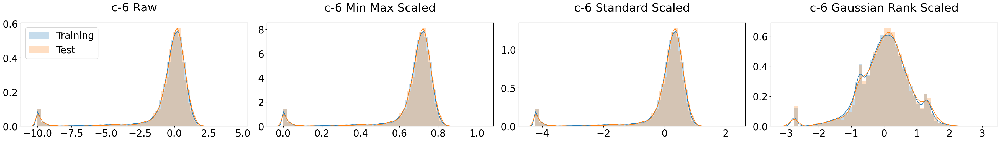

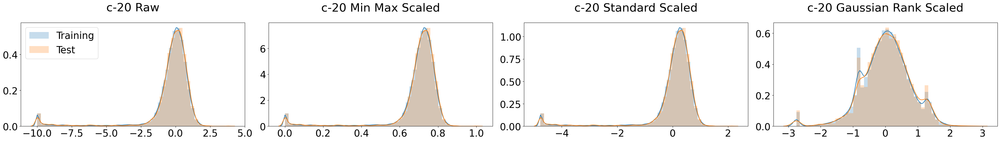

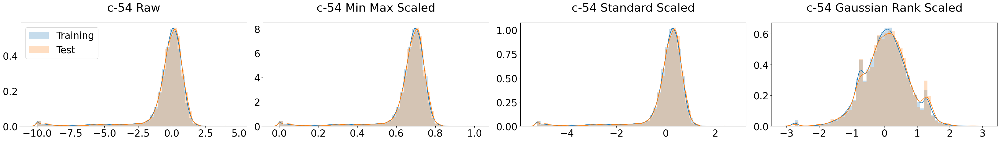

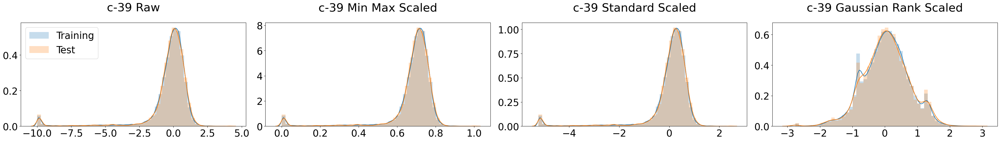

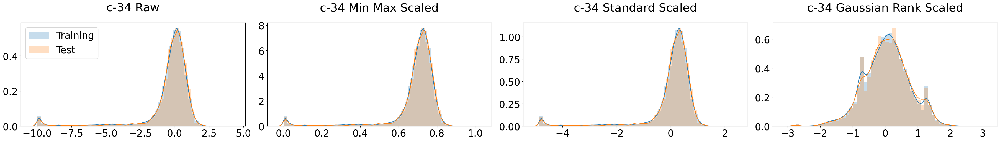

...

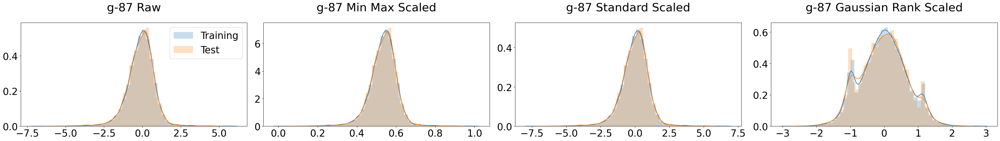

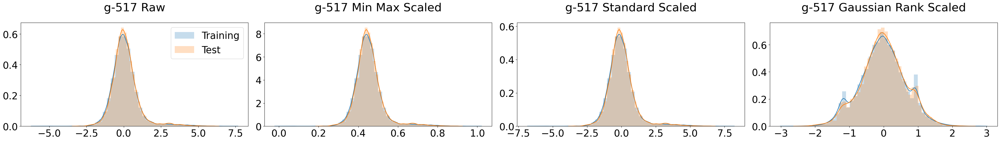

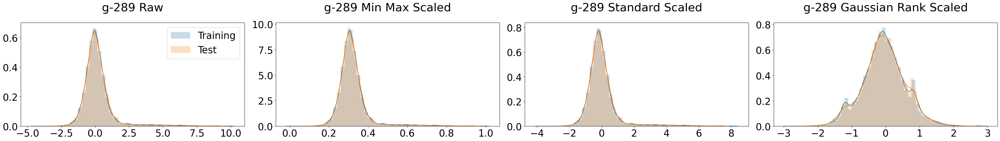

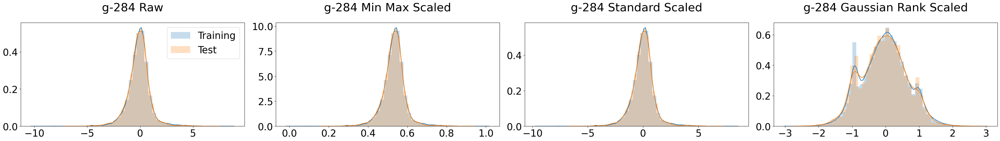

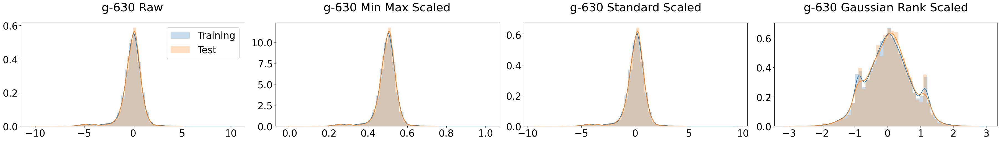

In [27]:
def distplot_scaled_features(feature):
        
    fig, axes = plt.subplots(ncols=4, figsize=(36, 5), dpi=100, constrained_layout=True)
    title_size = 30
    label_size = 25
    
    sns.distplot(df_scaled.loc[:len(df_train), feature], label='Training', ax=axes[0], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[len(df_train):, feature], label='Test', ax=axes[0], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[:len(df_train), f'{feature}_mms'], label='Training', ax=axes[1], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[len(df_train):, f'{feature}_mms'], label='Test', ax=axes[1], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[:len(df_train), f'{feature}_ss'], label='Training', ax=axes[2], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[len(df_train):, f'{feature}_ss'], label='Test', ax=axes[2], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[:len(df_train), f'{feature}_grs'], label='Training', ax=axes[3], hist_kws={'alpha': 0.25})
    sns.distplot(df_scaled.loc[len(df_train):, f'{feature}_grs'], label='Test', ax=axes[3], hist_kws={'alpha': 0.25})

    for i in range(4):

        axes[i].set_xlabel('')
        axes[i].tick_params(axis='x', labelsize=label_size)
        axes[i].tick_params(axis='y', labelsize=label_size)
        
        if i % 4 == 0:
            axes[i].legend(prop={'size': 25})
            
    axes[0].set_title(f'{feature} Raw', size=title_size, pad=title_size)
    axes[1].set_title(f'{feature} Min Max Scaled', size=title_size, pad=title_size)
    axes[2].set_title(f'{feature} Standard Scaled', size=title_size, pad=title_size)
    axes[3].set_title(f'{feature} Gaussian Rank Scaled', size=title_size, pad=title_size)
    
    plt.show()
    
for feature in scale_features:
    distplot_scaled_features(feature)

## **9. Dimensionality Reduction**

Two common dimensionality reduction techniques are PCA and auto-encoders. Those techniques are sensitive to scale, so it is important to standardize the data and make it unitless. For this purpose, cell viability and gene expression features are standardized with standard scaler. For evaluating information loss in different dimensionality reduction techniques, latent space dimensions are set to half of cell viability and gene expression dimensions.

In [28]:
df_cell_viability = pd.concat([df_train.loc[:, c_features], df_test.loc[:, c_features]], axis=0, ignore_index=True)
df_cell_viability.loc[:, :] = np.float32(StandardScaler().fit_transform(df_cell_viability))

df_gene_expression = pd.concat([df_train.loc[:, g_features], df_test.loc[:, g_features]], axis=0, ignore_index=True)
df_gene_expression.loc[:, :] = np.float32(StandardScaler().fit_transform(df_gene_expression))

CELL_N_DIMS = len(c_features) // 2
GENE_N_DIMS = len(g_features) // 2

### **9.1. PCA**

PCA is a linear transformation that projects the data into another space, where vectors of projections are defined by variance of the data. PCA results can be evaluated with reconstruction error and cumulative percent variance.

Ideally latent variables should explain around 75% of the total variance. For cell viability features, CPV curve resembles to linear growth. First 10 components contain approximately 89% of the variance, while 50 components are needed to explain close to 100% of the variance. For gene expression features, CPV curve is closer to logarithmic growth. First 10 components contain approximately 50% of the variance, while 400 components are needed to describe close to 100% of the variance. Optimal dimensions can be found for cell viability and gene expressions by evaluating CPV curves.

PCA Cell Viability Reconstruction Error 0.0428273 - Explained Variance: 95.7053%
PCA Gene Expression Reconstruction Error 0.100579 - Explained Variance: 89.8983%


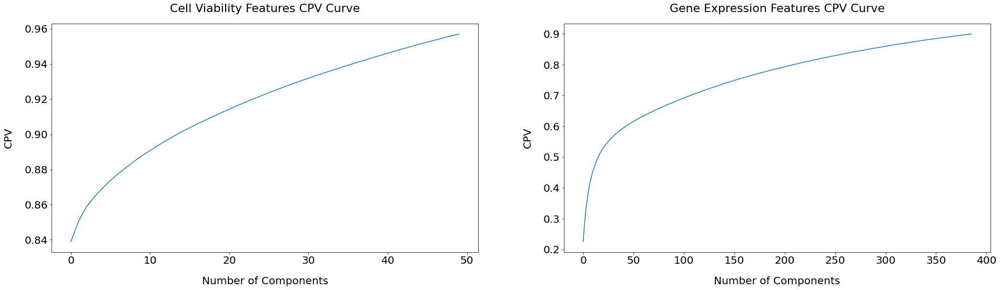

In [29]:
seed_everything(SEED)

fig, axes = plt.subplots(figsize=(32, 8), ncols=2)

pca = PCA(n_components=CELL_N_DIMS)
pca.fit(df_cell_viability)
pca_cell_viability_error = mean_squared_error(df_cell_viability, pca.inverse_transform(pca.transform(df_cell_viability)))
cell_viability_explained_variance = np.sum(pca.explained_variance_) / len(c_features) * 100
print(f'PCA Cell Viability Reconstruction Error {pca_cell_viability_error:.6} - Explained Variance: {cell_viability_explained_variance:.6}%')

axes[0].plot(np.cumsum(pca.explained_variance_ratio_))
axes[0].set_xlabel('Number of Components', size=20, labelpad=20)
axes[0].set_ylabel('CPV', size=20, labelpad=20)
axes[0].set_title(f'Cell Viability Features CPV Curve', size=22, pad=22)

pca = PCA(n_components=GENE_N_DIMS)
pca.fit(df_gene_expression)
pca_gene_expression_error = mean_squared_error(df_gene_expression, pca.inverse_transform(pca.transform(df_gene_expression)))
gene_expression_explained_variance = np.sum(pca.explained_variance_) / len(g_features) * 100
print(f'PCA Gene Expression Reconstruction Error {pca_gene_expression_error:.6} - Explained Variance: {gene_expression_explained_variance:.6}%')

axes[1].plot(np.cumsum(pca.explained_variance_ratio_))
axes[1].set_xlabel('Number of Components', size=20, labelpad=20)
axes[1].set_ylabel('CPV', size=20, labelpad=20)
axes[1].set_title('Gene Expression Features CPV Curve', size=22, pad=22)

for i in range(2):
    axes[i].tick_params(axis='x', labelsize=20)
    axes[i].tick_params(axis='y', labelsize=20)
    
plt.show()

### **9.2. Auto-encoder**

Auto-encoders are neural networks used for reducing data into a low dimensional latent space. Most important features lie in this low dimensional latent space because they are capable of reconstructing it. Auto-encoders are slower and computationally expensive compared to PCA, and they are also prone to overfitting.

For cell viability features, reconstruction error is close to PCA reconstruction error, but there are lots of spikes on learning curve. Features created in the cell viability latent space might be useful for supervised learning models.

Auto-encoder Cell Viability Reconstruction Error 0.061038


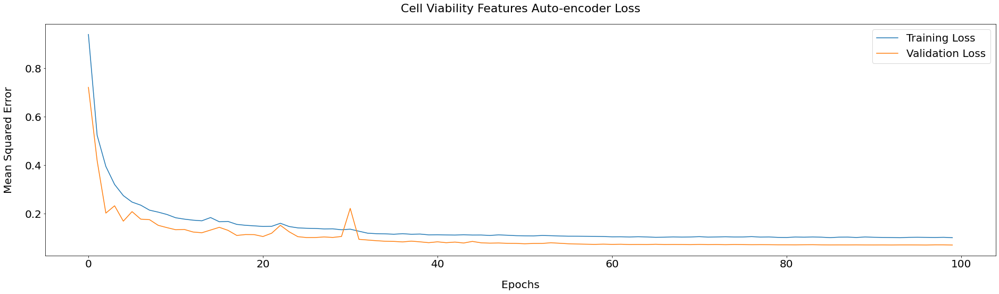

In [30]:
class CellViabilityAutoencoder(Model):
    
    def __init__(self, n_inputs, encoding_dim):
        
        super(CellViabilityAutoencoder, self).__init__()
        self.encoder = Sequential([
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 9, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 8, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(encoding_dim, activation='swish'),
        ])
        self.decoder = Sequential([
            Dense(2 ** 8, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 9, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(n_inputs)
        ])
        
    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

seed_everything(SEED)

cell_viability_ae = CellViabilityAutoencoder(len(c_features), CELL_N_DIMS)
cell_viability_ae.compile(optimizer=Adam(learning_rate=0.0005), loss='mse')
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00001, verbose=0)
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.00001, patience=100, restore_best_weights=True, verbose=0)

history = cell_viability_ae.fit(df_cell_viability,
                                df_cell_viability,
                                batch_size=128,
                                verbose=0,
                                validation_data=(df_cell_viability, df_cell_viability),
                                epochs=100,
                                shuffle=True,
                                callbacks=[reduce_lr, early_stopping])

cell_viability_encoded = cell_viability_ae.encoder(df_cell_viability.values).numpy()
cell_viability_decoded = cell_viability_ae.decoder(cell_viability_encoded).numpy()
cell_viability_error = mean_squared_error(df_cell_viability.values, cell_viability_decoded)
print(f'Auto-encoder Cell Viability Reconstruction Error {cell_viability_error:.6}')

plt.figure(figsize=(32, 8))

plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')

plt.xlabel('Epochs', size=20, labelpad=20)
plt.ylabel('Mean Squared Error', size=20, labelpad=20)
plt.tick_params(axis='x', labelsize=20)
plt.tick_params(axis='y', labelsize=20)
plt.legend(prop={'size': 20})
plt.title('Cell Viability Features Auto-encoder Loss', size=22, pad=22)

plt.show()

For gene expression features, reconstruction error is worse than PCA reconstruction error, but features created in the gene expression latent space might be still useful for supervised learning models.

Auto-encoder Gene Expression Reconstruction Error 0.245906


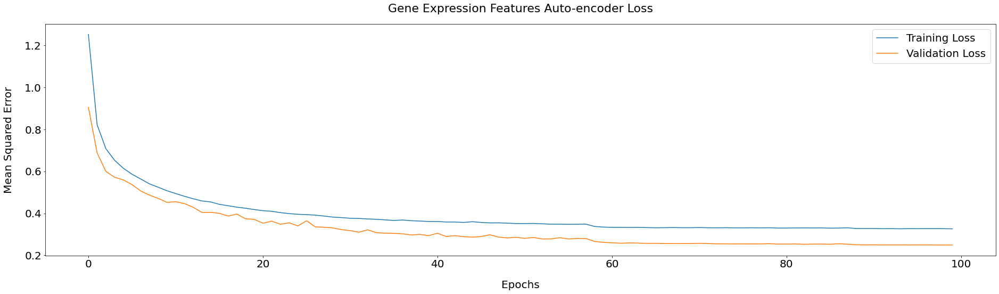

In [31]:
class GeneExpressionAutoencoder(Model):
    
    def __init__(self, n_inputs, encoding_dim):
        
        super(GeneExpressionAutoencoder, self).__init__()
        self.encoder = Sequential([
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 9, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 8, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(encoding_dim, activation='swish'),
        ])
        self.decoder = Sequential([
            Dense(2 ** 8, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(2 ** 9, activation='swish', activity_regularizer=L2(0.001)),
            BatchNormalization(),
            Dropout(0.1),
            Dense(n_inputs)
        ])
        
    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

seed_everything(SEED)

gene_expression_ae = GeneExpressionAutoencoder(len(g_features), GENE_N_DIMS)
gene_expression_ae.compile(optimizer=Adam(learning_rate=0.0005), loss='mse')
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00001, verbose=0)
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.00001, patience=100, restore_best_weights=True, verbose=0)

history = gene_expression_ae.fit(df_gene_expression,
                                 df_gene_expression,
                                 batch_size=128,
                                 verbose=0,
                                 validation_data=(df_gene_expression, df_gene_expression),
                                 epochs=100,
                                 shuffle=True,
                                 callbacks=[reduce_lr, early_stopping])

gene_expression_encoded = gene_expression_ae.encoder(df_gene_expression.values).numpy()
gene_expression_decoded = gene_expression_ae.decoder(gene_expression_encoded).numpy()
gene_expression_error = mean_squared_error(df_gene_expression.values, gene_expression_decoded)
print(f'Auto-encoder Gene Expression Reconstruction Error {gene_expression_error:.6}')

plt.figure(figsize=(32, 8))

plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')

plt.xlabel('Epochs', size=20, labelpad=20)
plt.ylabel('Mean Squared Error', size=20, labelpad=20)
plt.tick_params(axis='x', labelsize=20)
plt.tick_params(axis='y', labelsize=20)
plt.legend(prop={'size': 20})
plt.title('Gene Expression Features Auto-encoder Loss', size=22, pad=22)

plt.show()

## **10. Drugs**

Training set drug ids are added to the competition dataset by today. `train_drug.csv` contains anonymous drug ids of every signature id in training set. There are **3289** unique drugs while there are **23814** unique signatures. This means some drugs are used more than 6 times (2 different doses x 3 different durations). This data can be useful for cross-validations and outlier detection.

In [32]:
df_train_drug = pd.read_csv('../input/lish-moa/train_drug.csv')
print(f'Training Drugs Shape = {df_train_drug.shape} - Unique Drugs {df_train_drug["drug_id"].nunique()}')
print(f'Training Drugs Memory Usage = {df_train_drug.memory_usage().sum() / 1024 ** 2:.2f} MB')

df_train = df_train.merge(df_train_drug, how='left', on='sig_id')
cols = list(df_train.columns)
cols = [cols[-1]] + cols[:-1]
df_train = df_train[cols]

df_train_drug.head(10)

Training Drugs Shape = (23814, 2) - Unique Drugs 3289
Training Drugs Memory Usage = 0.36 MB


,sig_id,drug_id
0,id_000644bb2,b68db1d53
1,id_000779bfc,df89a8e5a
2,id_000a6266a,18bb41b2c
3,id_0015fd391,8c7f86626
4,id_001626bd3,7cbed3131
5,id_001762a82,e06749542
6,id_001bd861f,746ca1f5a
7,id_0020d0484,8b87a7a83
8,id_00224bf20,952b76dfc
9,id_0023f063e,de7583071


Drug frequencies were expected to be diverse but somewhat balanced. It looks like that's the case, but there are so many unique drugs. Most common drug is `cacb2b860`, and it has 1866 occurences. Other most common drugs are `87d714366`, `9f80f3f77`, `8b87a7a83`, `5628cb3ee`, `d08af5d4b`, `292ab2c28`, `d50f18348`, and `d1b47f29d` in this order. 

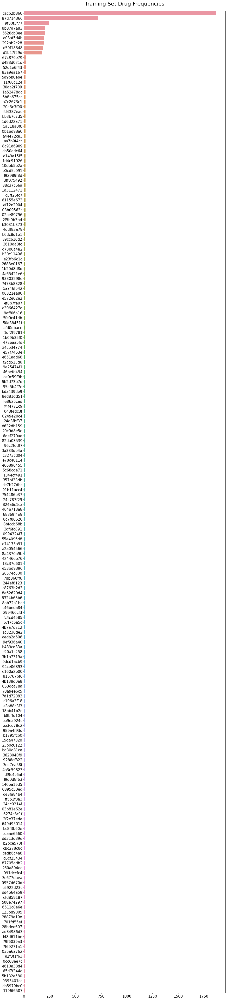

In [33]:
df_drug_frequencies = df_train['drug_id'].value_counts()

fig = plt.figure(figsize=(15, 75))

sns.barplot(x=df_drug_frequencies.head(200).values,
            y=df_drug_frequencies.head(200).index)

plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.xlabel('')
plt.ylabel('')
plt.title('Training Set Drug Frequencies', size=22, pad=22)

plt.show()

del df_drug_frequencies

There are very few unique drug occurences. Most common one is 6 because there are 2 different doses and 3 different durations to begin with. 2774 out of 3289 unique drugs are in this group. 196 unique drugs are seen 7 times and 129 drugs are seen only one time.

1866 is the drug (`cacb2b860`) with the highest amount of occurence and it is only seen in control group (`ctl_vehicle`). This explains the unusual number of occurences for this one. This drug can be omitted from cross-validation schemes. Other large values are also very unusual and they are not in the control group.

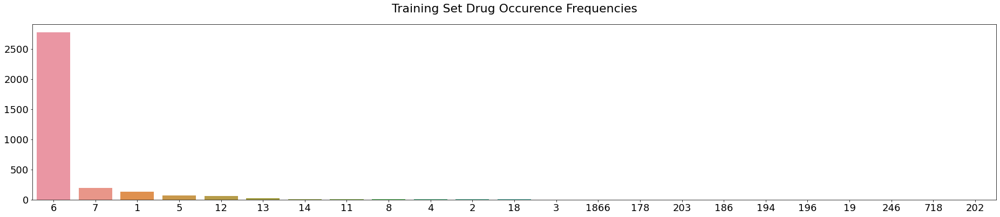

In [34]:
df_drug_occurences = df_train['drug_id'].value_counts().value_counts()
df_drug_occurences.sort_values(ascending=False, inplace=True)

fig = plt.figure(figsize=(32, 6))

sns.barplot(x=df_drug_occurences.index,
            y=df_drug_occurences.values,
            order=df_drug_occurences.index)

plt.tick_params(axis='x', labelsize=18)
plt.tick_params(axis='y', labelsize=18)
plt.xlabel('')
plt.ylabel('')
plt.title('Training Set Drug Occurence Frequencies', size=22, pad=22)

plt.show()

del df_drug_occurences

Duration counts are consistent between different drugs just like they were between different targets. Same behavior is expected in test set because some level of stratification is applied while splitting train/test sets.

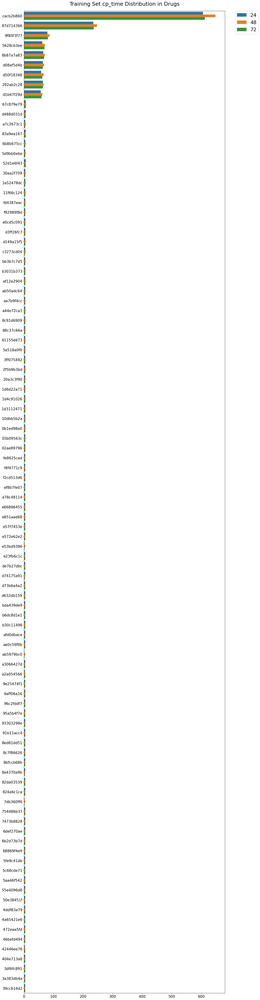

In [35]:
df_drug_counts_by_cp_time = pd.DataFrame(df_train.groupby(['drug_id', 'cp_time'])['drug_id'].count())
df_drug_counts_by_cp_time.rename(columns={'drug_id': 'count'},inplace=True)
df_drug_counts_by_cp_time.reset_index(inplace=True)
df_drug_counts_by_cp_time['count_max'] = df_drug_counts_by_cp_time.groupby('drug_id')['count'].transform('max')
df_drug_counts_by_cp_time.sort_values(by=['count_max', 'drug_id'], ascending=False, inplace=True)

fig = plt.figure(figsize=(15, 75), dpi=100)

sns.barplot(x=df_drug_counts_by_cp_time['count'].values[:300],
            y=df_drug_counts_by_cp_time['drug_id'].values[:300],
            hue=df_drug_counts_by_cp_time['cp_time'].values[:300])

plt.xlabel('')
plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, prop={'size': 20})
plt.title('Training Set cp_time Distribution in Drugs', size=22, pad=22)

plt.show()

del df_drug_counts_by_cp_time

Dose counts are also consistent between different drugs just like they were between different targets. Same behavior is expected in test set because some level of stratification is applied while splitting train/test sets.

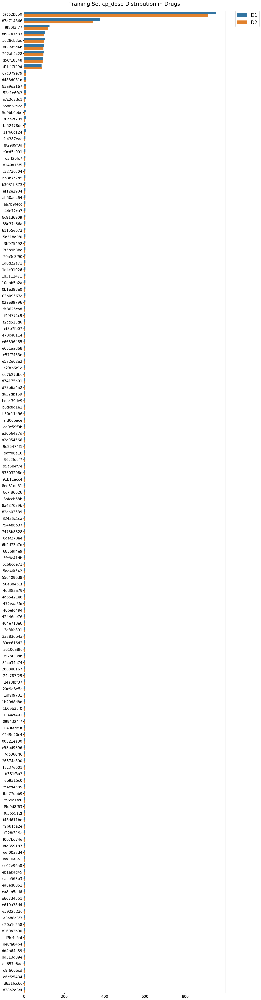

In [36]:
df_drug_counts_by_cp_dose = pd.DataFrame(df_train.groupby(['drug_id', 'cp_dose'])['drug_id'].count())
df_drug_counts_by_cp_dose.rename(columns={'drug_id': 'count'},inplace=True)
df_drug_counts_by_cp_dose.reset_index(inplace=True)
df_drug_counts_by_cp_dose['count_max'] = df_drug_counts_by_cp_dose.groupby('drug_id')['count'].transform('max')
df_drug_counts_by_cp_dose.sort_values(by=['count_max', 'drug_id'], ascending=False, inplace=True)

fig = plt.figure(figsize=(15, 75), dpi=100)

sns.barplot(x=df_drug_counts_by_cp_dose['count'].values[:300],
            y=df_drug_counts_by_cp_dose['drug_id'].values[:300],
            hue=df_drug_counts_by_cp_dose['cp_dose'].values[:300])

plt.xlabel('')
plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0, prop={'size': 20})
plt.title('Training Set cp_dose Distribution in Drugs', size=22, pad=22)

plt.show()

del df_drug_counts_by_cp_dose

## **11. Signatures**

Finally, different samples (signatures) should be analyzed individually for finding feature engineering ideas and detecting outliers. Even though gene expression and cell viability features are independent, signatures can be visualized as a sequence. For this analysis, 14 random signatures are selected. 7 of them are classified to 0, 1, 2, 3, 4, 5 or 7 scored targets, and the other 7 of them are classified to same number of not scored targets. 

In [37]:
def plot_signature(sig_id):
    
    if sig_id in df_train['sig_id'].values:
        g = df_train.loc[df_train['sig_id'] == sig_id, g_features].T
        c = df_train.loc[df_train['sig_id'] == sig_id, c_features].T
        t_scored = df_train.loc[df_train['sig_id'] == sig_id, target_features_scored].T
        t_notscored = df_train.loc[df_train['sig_id'] == sig_id, target_features_nonscored].T
        
        print(f'{sig_id}\n{"-" * (len(sig_id))}')
        print(f'Gene Expression Mean: {np.mean(g.values):.4} - Median: {np.median(g.values):.4} - Std: {np.std(g.values):.4} - Min: {np.min(g.values):.4} - Max: {np.max(g.values):.4} - Skew {skew(g.values)[0]:.4} - Kurt {kurtosis(g.values)[0]:.4} - Var {np.var(g.values):.4}')
        print(f'Cell Viability Mean: {np.mean(c.values):.4} - Median: {np.median(c.values):.4} - Std: {np.std(c.values):.4} - Min: {np.min(c.values):.4} - Max: {np.max(c.values):.4} - Skew {skew(c.values)[0]:.4} - Kurt {kurtosis(c.values)[0]:.4} - Var {np.var(c.values):.4}')
        print(f'Target Features Scored Mean {np.mean(t_scored.values):.4} - Target Features Not Scored Mean {np.mean(t_notscored.values):.4}')

        fig, axes = plt.subplots(nrows=2, figsize=(32, 12), dpi=100)
        plt.subplots_adjust(left=None, bottom=None, right=None, top=1.50, wspace=None, hspace=None)
        
        axes[0].plot(g, label='Gene Expression')
        axes[0].plot(c, label='Cell Viability')
        axes[1].plot(t_scored, label='Target Features Scored')
        axes[1].plot(t_notscored, label='Target Features Not Scored')
        
        axes[0].tick_params(axis='x', labelsize=20, rotation=0, pad=15, length=0)
        axes[1].tick_params(axis='x', labelsize=20, rotation=90, pad=15, length=0)
        for i in range(2):            
            axes[i].tick_params(axis='y', labelsize=20, rotation=0, pad=15, length=0)
            axes[i].legend(prop={'size': 20})

        for idx, label in enumerate(axes[0].get_xticklabels()):
            if idx % 50 == 0:
                label.set_visible(True)
            else:
                label.set_visible(False)
                
        for idx, label in enumerate(axes[1].get_xticklabels()):
            if df_train.loc[df_train['sig_id'] == sig_id, (target_features_scored + target_features_nonscored)[idx]].values[0] == 1:
                label.set_visible(True)
            else:
                label.set_visible(False)
                
        axes[0].set_title(f'Signature {sig_id} Gene Expression and Cell Viability Sequence', size=25, pad=15)
        axes[1].set_title(f'Signature {sig_id} Target Features Sequence', size=25, pad=15)
    else:
        g = df_test.loc[df_test['sig_id'] == sig_id, g_features].T
        c = df_test.loc[df_test['sig_id'] == sig_id, c_features].T
        
        fig = plt.figure(figsize=(32, 8), dpi=100)
        
        plt.plot(g, label='Gene Expression')
        plt.plot(c, label='Cell Viability')
            
    plt.show()


### **11.1 Signatures with 7 Targets**

There are 6 unique signatures that are classified to **7** scored targets. All of them belong to drug `91dc8bab8`. Those 6 signatures are classified to 3 not scored targets. Most unusual thing about this drug is, cell viability and gene expression values are on completely different scales. Gene expression features have extremely high standard deviation and variance. Those two statistical measures can be used for outlier detection because ideally cell viability and gene expression values should on same scale.

id_344ef5019
------------
Gene Expression Mean: -0.03642 - Median: -0.07725 - Std: 4.656 - Min: -10.0 - Max: 10.0 - Skew 0.009231 - Kurt -0.3672 - Var 21.68
Cell Viability Mean: -9.659 - Median: -9.98 - Std: 0.9365 - Min: -10.0 - Max: -4.981 - Skew 3.547 - Kurt 12.13 - Var 0.877
Target Features Scored Mean 0.03398 - Target Features Not Scored Mean 0.007463


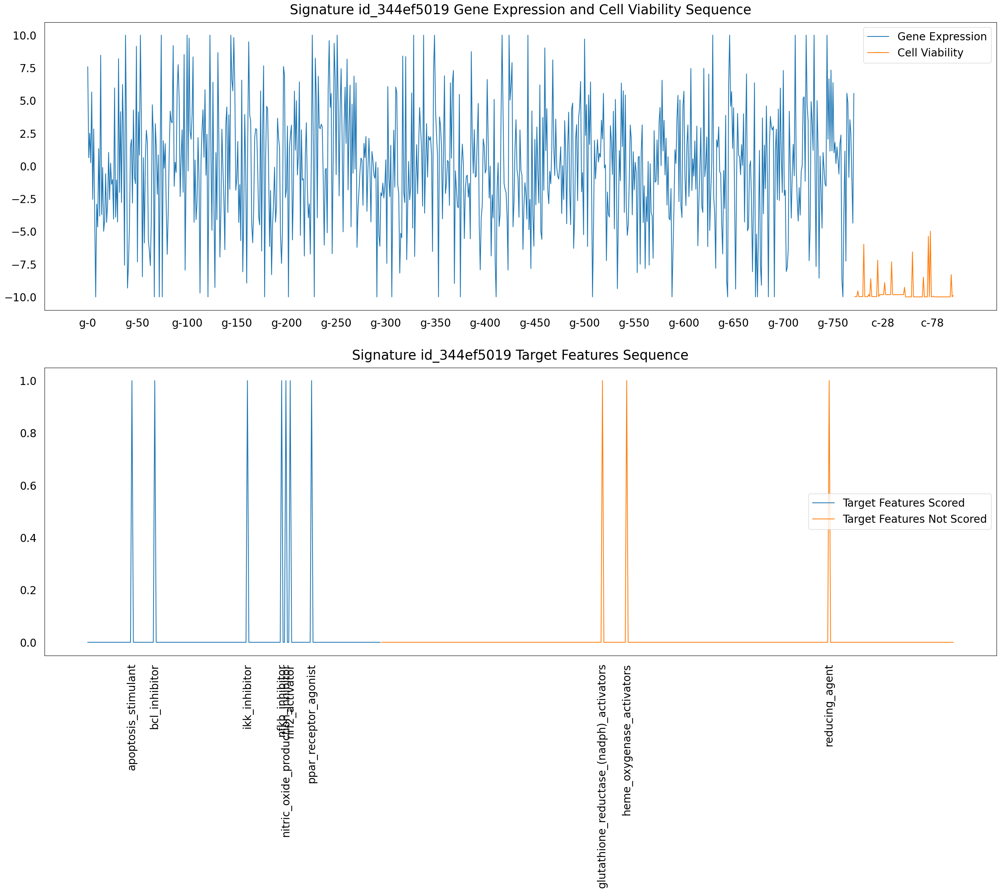

In [38]:
plot_signature('id_344ef5019')

There are 6 unique signatures that are classified to **7** not scored targets. All of them belong to drug `838575b1d`. Those 6 signatures are classified to 4 scored targets. Unlike the previous signature, this one doesn't have any anomalies.

id_063e8e7d6
------------
Gene Expression Mean: -0.009806 - Median: -0.0079 - Std: 0.6692 - Min: -3.119 - Max: 3.342 - Skew 0.2016 - Kurt 2.718 - Var 0.4479
Cell Viability Mean: -0.2436 - Median: -0.2345 - Std: 0.5609 - Min: -1.564 - Max: 1.321 - Skew -0.02208 - Kurt 0.1085 - Var 0.3146
Target Features Scored Mean 0.01942 - Target Features Not Scored Mean 0.01741


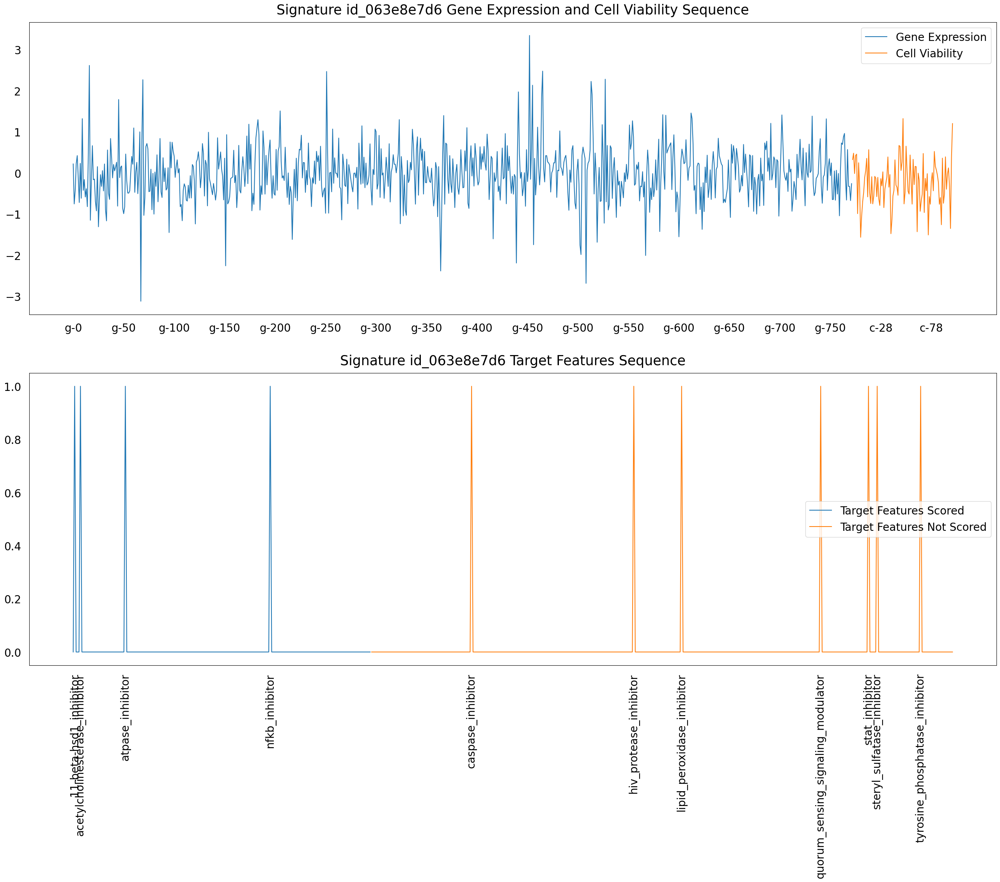

In [39]:
plot_signature('id_063e8e7d6')

### **11.2 Signatures with 5 Targets**

There are 13 unique signatures that are classified to **5** scored targets, and they are very similar groups which are mainly inhibitors. They belong to drugs `3f9dd627f`, `228f08c3d`, and `809527b9d`, and this signature belongs to drug `3f9dd627f`. Those 13 signatures are classified to 1 not scored target. In addition to that, there is nothing unusual about the sequence.

id_8c4b726ff
------------
Gene Expression Mean: 0.05838 - Median: 0.1119 - Std: 1.473 - Min: -6.832 - Max: 4.915 - Skew -0.3739 - Kurt 1.362 - Var 2.17
Cell Viability Mean: -0.4181 - Median: -0.3412 - Std: 0.8742 - Min: -3.256 - Max: 1.231 - Skew -0.7373 - Kurt 0.6215 - Var 0.7643
Target Features Scored Mean 0.02427 - Target Features Not Scored Mean 0.002488


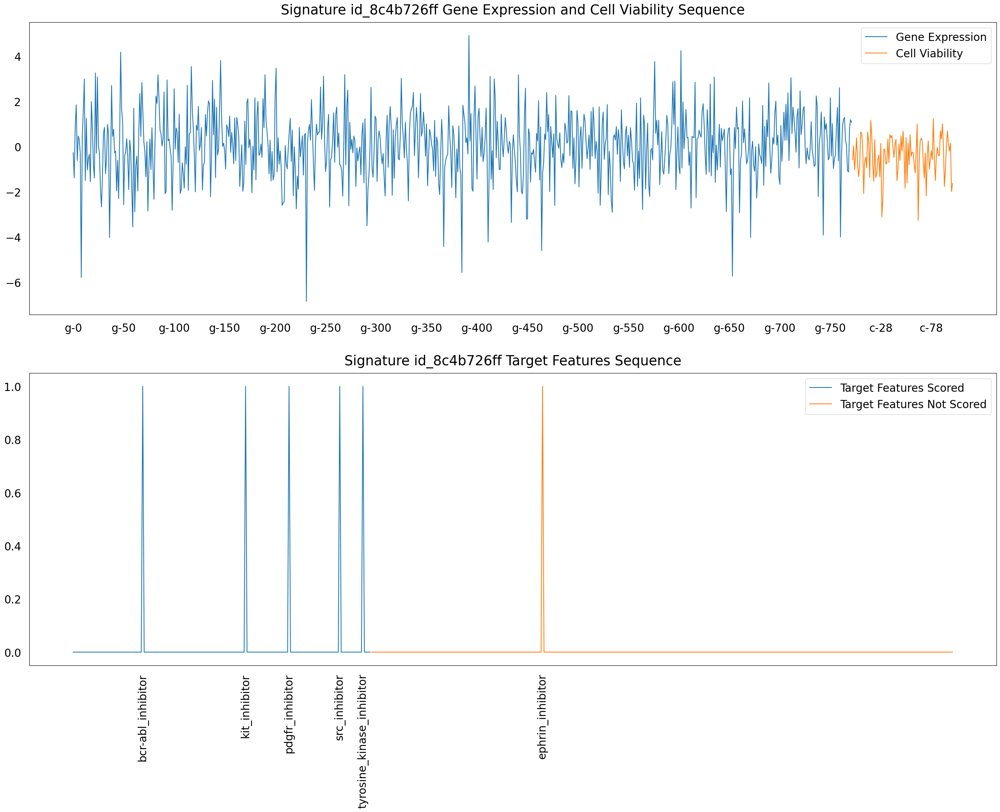

In [40]:
plot_signature('id_8c4b726ff')

There are 6 unique signatures that are classified to **5** not scored targets, and it is a different target group compared to previous signature. All of them belong to drug `91dc8bab8`, and those 6 signatures are classified to 2 scored targets.

id_0c830d384
------------
Gene Expression Mean: 0.03974 - Median: 0.0775 - Std: 0.9344 - Min: -4.793 - Max: 5.355 - Skew 0.2104 - Kurt 4.374 - Var 0.873
Cell Viability Mean: 0.06085 - Median: 0.1138 - Std: 0.8078 - Min: -1.92 - Max: 1.973 - Skew -0.2178 - Kurt -0.2689 - Var 0.6526
Target Features Scored Mean 0.009709 - Target Features Not Scored Mean 0.01244


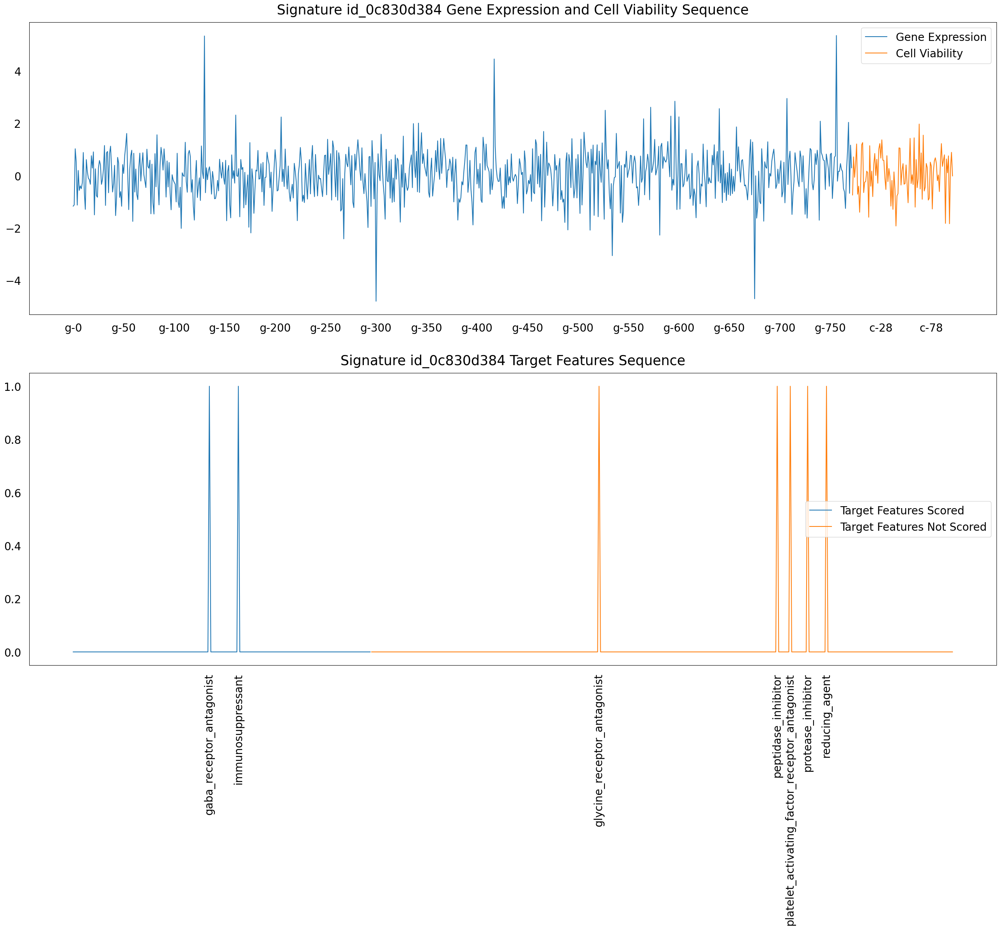

In [41]:
plot_signature('id_0c830d384')

### **11.3 Signatures with 4 Targets**

There are 55 unique signatures that are classified to **4** scored targets. They belong to 8 unique drugs, and this signature belongs to drug `3cda750b5`. There is no clear anomaly in this signature, and it is very clean.

id_003603254
------------
Gene Expression Mean: -0.08765 - Median: -0.0871 - Std: 0.9223 - Min: -3.707 - Max: 3.38 - Skew 0.05382 - Kurt 1.2 - Var 0.8507
Cell Viability Mean: -0.6714 - Median: -0.5684 - Std: 0.8709 - Min: -2.707 - Max: 1.083 - Skew -0.135 - Kurt -0.5519 - Var 0.7584
Target Features Scored Mean 0.01942 - Target Features Not Scored Mean 0.0


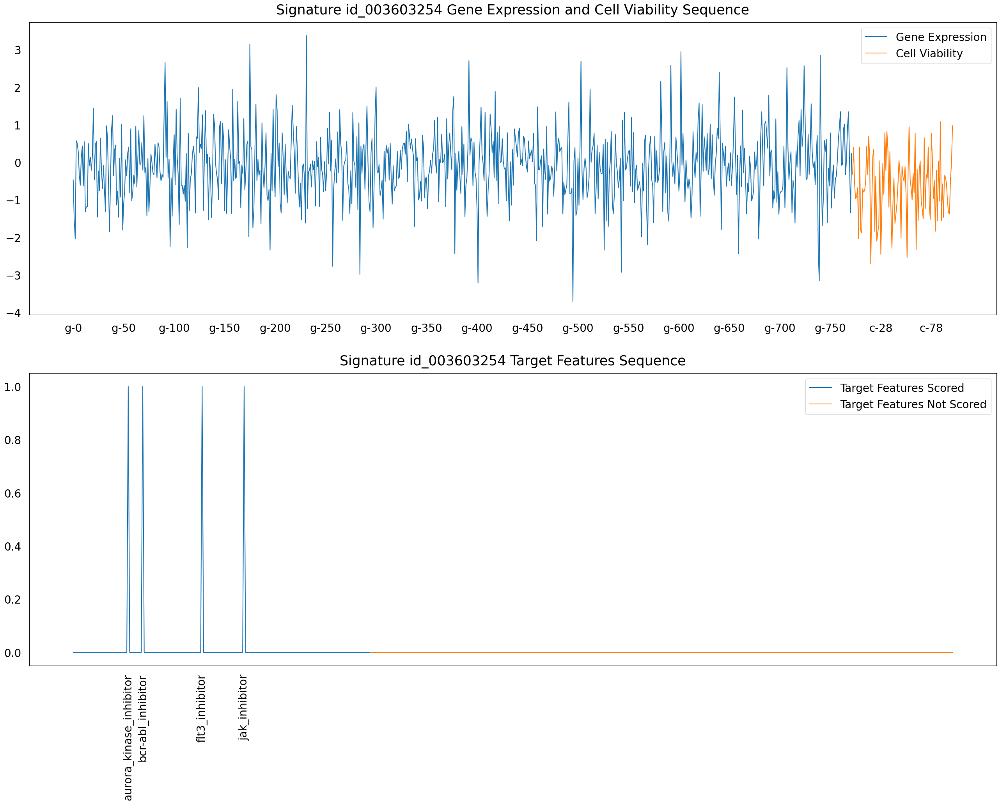

In [42]:
plot_signature('id_003603254')

There are 13 unique signatures that are classified to **4** not scored targets. They belong to 3 unique drugs, and this signature belongs to drug `7cf4a548c`. There is no clear anomaly in this signature, and it is very clean.

id_0da23653d
------------
Gene Expression Mean: -0.01711 - Median: -0.0071 - Std: 0.7996 - Min: -5.557 - Max: 5.394 - Skew -0.3256 - Kurt 9.079 - Var 0.6394
Cell Viability Mean: -0.4359 - Median: -0.4035 - Std: 0.6987 - Min: -3.789 - Max: 1.175 - Skew -1.209 - Kurt 4.585 - Var 0.4881
Target Features Scored Mean 0.009709 - Target Features Not Scored Mean 0.00995


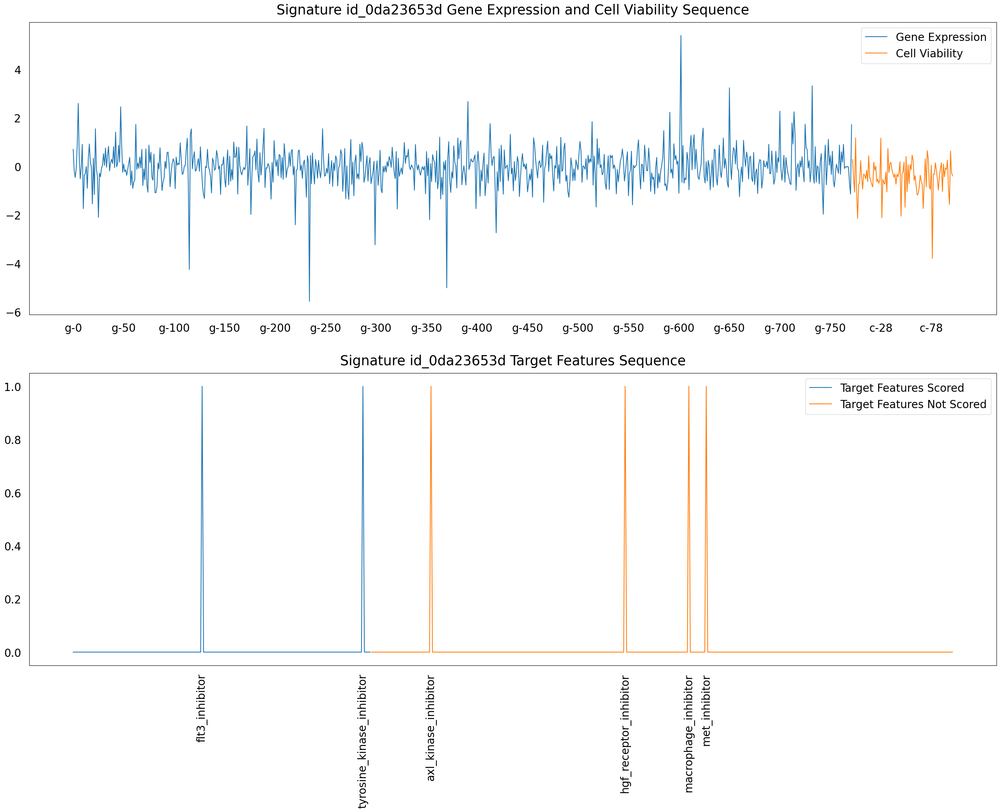

In [43]:
plot_signature('id_0da23653d')

### **11.4 Signatures with 3 Targets**

There are 303 unique signatures that are classified to **3** scored targets. They belong to 21 unique drugs, and this signature belongs to drug `18bb41b2c`. There is no clear anomaly in this signature, but cell viability variance and standard deviation are lesser than gene expression variance and standard deviation.

id_000a6266a
------------
Gene Expression Mean: -0.0154 - Median: -0.0297 - Std: 0.9996 - Min: -5.164 - Max: 5.447 - Skew -0.05249 - Kurt 6.199 - Var 0.9992
Cell Viability Mean: -0.2016 - Median: -0.0886 - Std: 0.5939 - Min: -2.364 - Max: 1.174 - Skew -0.6459 - Kurt 0.9945 - Var 0.3527
Target Features Scored Mean 0.01456 - Target Features Not Scored Mean 0.0


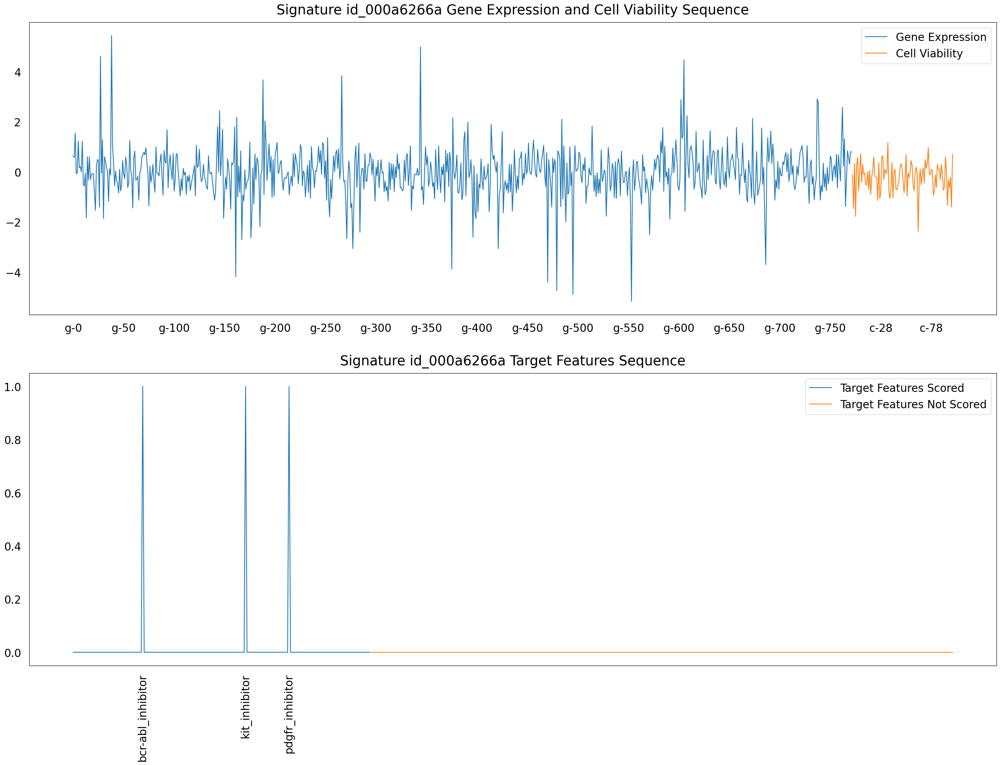

In [44]:
plot_signature('id_000a6266a')

There are 36 unique signatures that are classified to **3** not scored targets. They belong to 5 unique drugs, and this signature belongs to drug `fe8625cad`. There is no clear anomaly in this signature, but cell viability variance and standard deviation are lesser than gene expression variance and standard deviation just like the previous signature.

id_163bd7f3e
------------
Gene Expression Mean: 0.0493 - Median: 0.00725 - Std: 0.7178 - Min: -5.337 - Max: 5.525 - Skew 0.2969 - Kurt 8.485 - Var 0.5152
Cell Viability Mean: 0.253 - Median: 0.3173 - Std: 0.5121 - Min: -1.38 - Max: 1.778 - Skew -0.4867 - Kurt 0.7973 - Var 0.2622
Target Features Scored Mean 0.01942 - Target Features Not Scored Mean 0.007463


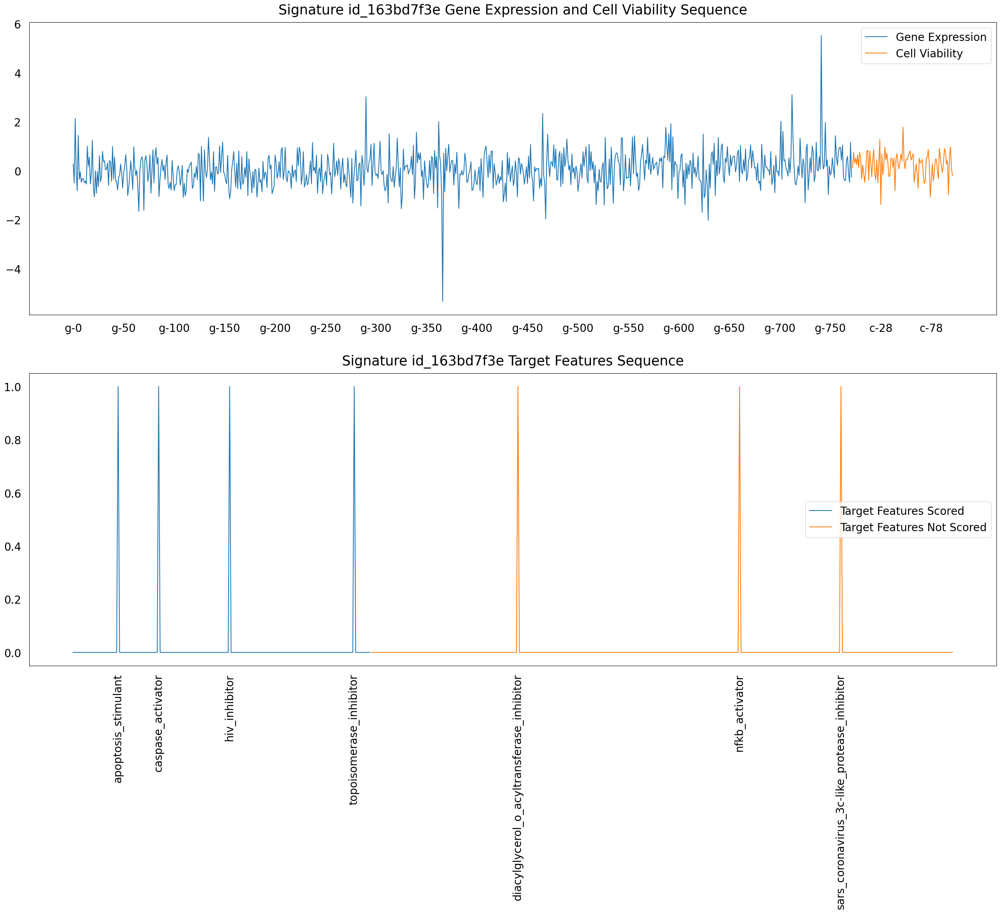

In [45]:
plot_signature('id_163bd7f3e')

### **11.5 Signatures with 2 Targets**

There are 1538 unique signatures that are classified to **2** scored targets. They belong to 139 unique drugs, and this signature belongs to drug `b877aa048`. There is no clear anomaly in this signature, and it is very clean.

id_0024bcd70
------------
Gene Expression Mean: 0.01104 - Median: -0.01135 - Std: 0.6261 - Min: -4.663 - Max: 3.147 - Skew -0.2209 - Kurt 6.13 - Var 0.3921
Cell Viability Mean: 0.1374 - Median: 0.1703 - Std: 0.4933 - Min: -1.361 - Max: 1.228 - Skew -0.4379 - Kurt 0.1479 - Var 0.2433
Target Features Scored Mean 0.009709 - Target Features Not Scored Mean 0.0


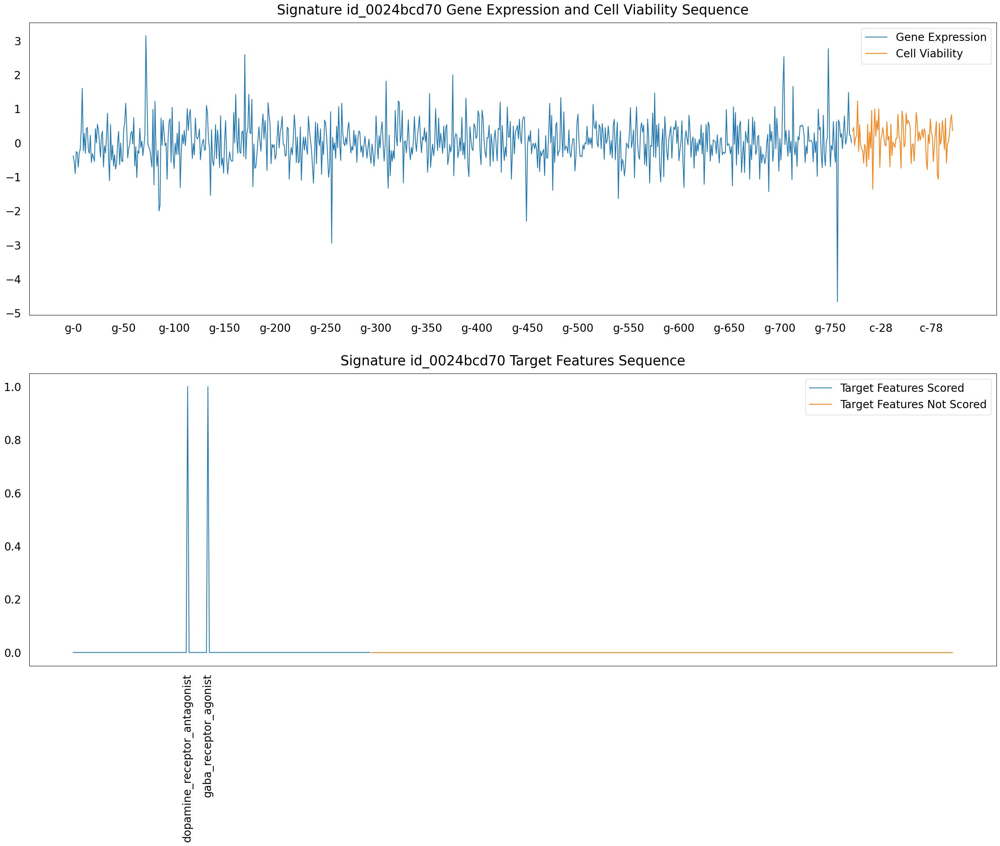

In [46]:
plot_signature('id_0024bcd70')

There are 247 unique signatures that are classified to **2** not scored targets. They belong to 41 unique drugs, and this signature belongs to drug `746ca1f5a`. Cell viability/gene expression variance and standard deviation mismatch exists in this signature as well, and the gap is huge.

id_001bd861f
------------
Gene Expression Mean: 0.7508 - Median: 1.45 - Std: 3.537 - Min: -8.481 - Max: 10.0 - Skew -0.3357 - Kurt -1.079 - Var 12.51
Cell Viability Mean: 0.5724 - Median: 0.605 - Std: 0.7649 - Min: -1.103 - Max: 2.467 - Skew 0.0835 - Kurt -0.1432 - Var 0.5851
Target Features Scored Mean 0.0 - Target Features Not Scored Mean 0.004975


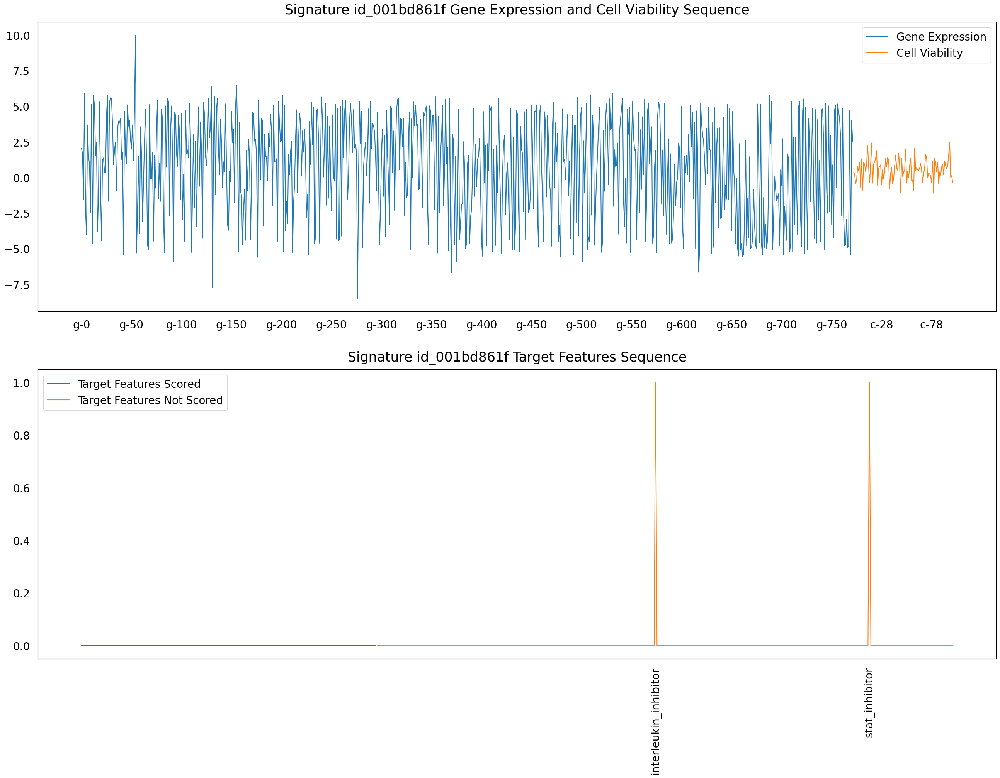

In [47]:
plot_signature('id_001bd861f')

### **11.6 Signatures with 1 Target**

1 target signatures are the most common group for scored targets in training set. There are 12532 unique signatures that are classified to **1** scored target. They belong to 1904 unique drugs, and this signature belongs to drug `b68db1d53`. There is no clear anomaly in this signature, and it is very clean.

id_001626bd3
------------
Gene Expression Mean: -0.02467 - Median: 0.0 - Std: 0.9994 - Min: -10.0 - Max: 4.155 - Skew -1.396 - Kurt 12.88 - Var 0.9988
Cell Viability Mean: 0.2069 - Median: 0.1686 - Std: 0.4892 - Min: -1.495 - Max: 1.108 - Skew -0.4115 - Kurt 0.199 - Var 0.2393
Target Features Scored Mean 0.004854 - Target Features Not Scored Mean 0.0


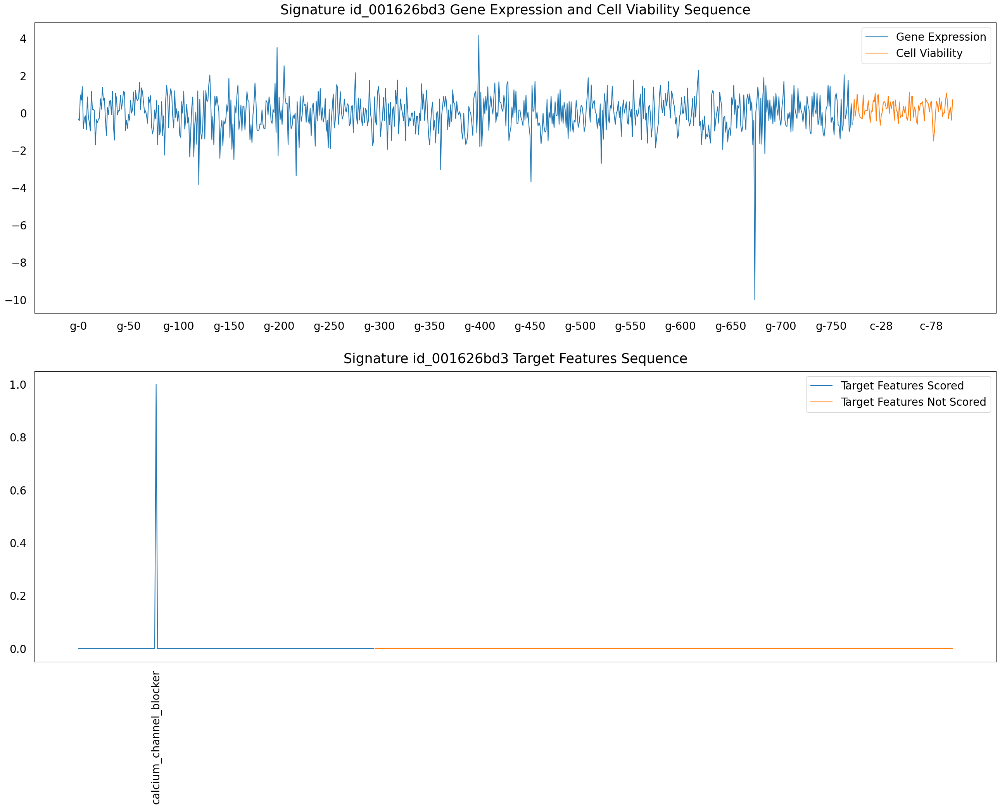

In [48]:
plot_signature('id_001626bd3')

There are 4282 unique signatures that are classified to **1** not scored target. They belong to 704 unique drugs, and this signature belongs to drug `e0cd5c091`. In this case, cell viability values have higher standard deviation and variance, and they are on different scales.

id_002d31e2c
------------
Gene Expression Mean: 0.1127 - Median: 0.03815 - Std: 1.802 - Min: -6.133 - Max: 10.0 - Skew 0.349 - Kurt 2.082 - Var 3.247
Cell Viability Mean: -4.181 - Median: -4.624 - Std: 3.009 - Min: -9.97 - Max: 1.383 - Skew -0.1484 - Kurt -0.9457 - Var 9.052
Target Features Scored Mean 0.0 - Target Features Not Scored Mean 0.002488


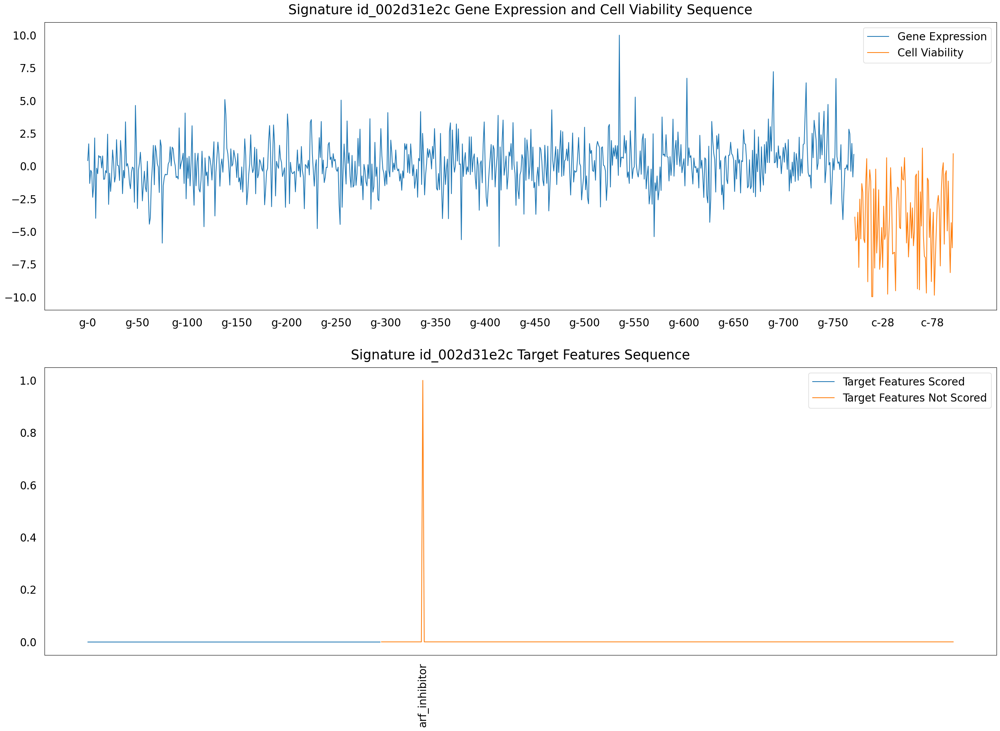

In [49]:
plot_signature('id_002d31e2c')

### **11.7 Signatures with 0 Targets**

There are 9367 unique signatures that are classified to **0** scored targets. They belong to 1213 unique drugs, and this signature belongs to drug `df89a8e5a`. There is no clear anomaly in this signature, but cell viability variance and standard deviation are lesser than gene expression variance and standard deviation.

id_000779bfc
------------
Gene Expression Mean: 0.005305 - Median: 0.0178 - Std: 0.7696 - Min: -5.237 - Max: 5.566 - Skew 0.004806 - Kurt 8.135 - Var 0.5924
Cell Viability Mean: 0.3158 - Median: 0.3618 - Std: 0.4273 - Min: -1.278 - Max: 1.408 - Skew -0.6083 - Kurt 1.124 - Var 0.1825
Target Features Scored Mean 0.0 - Target Features Not Scored Mean 0.0


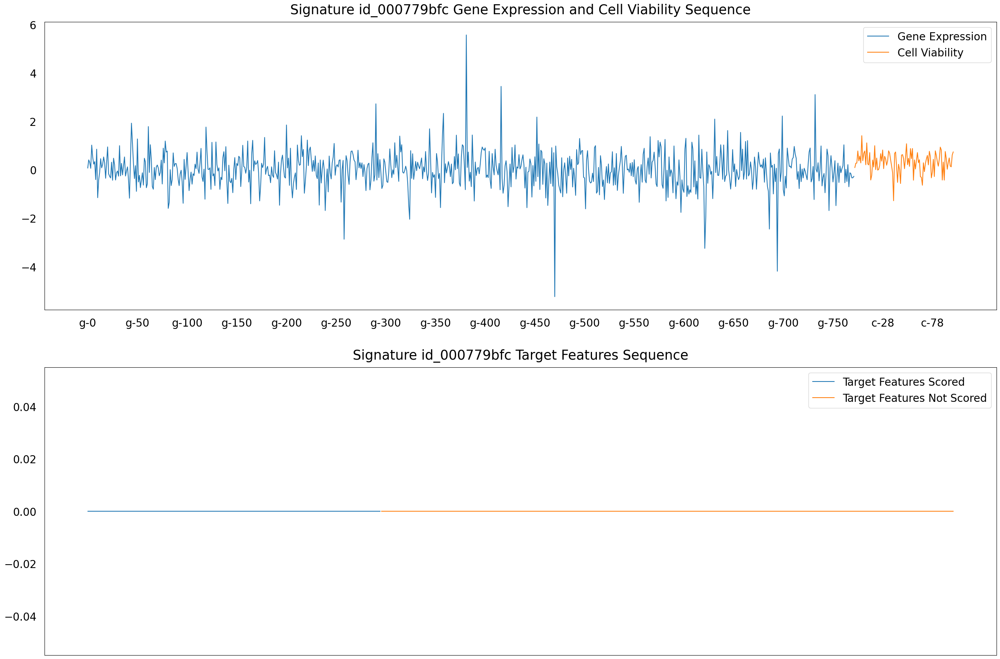

In [50]:
plot_signature('id_000779bfc')

0 target signatures are the most common group for not scored targets in training set. There are 19224 unique signatures that are classified to **0** scored targets. They belong to 2534 unique drugs, and this signature belongs to drug `b68db1d53`. There is no clear anomaly in this signature, but cell viability variance and standard deviation are lesser than gene expression variance and standard deviation just like the previous signature.

id_000644bb2
------------
Gene Expression Mean: -0.008019 - Median: -0.0239 - Std: 0.7737 - Min: -5.691 - Max: 3.394 - Skew -0.7098 - Kurt 6.305 - Var 0.5987
Cell Viability Mean: 0.2997 - Median: 0.3597 - Std: 0.5134 - Min: -1.023 - Max: 1.484 - Skew -0.2948 - Kurt -0.007451 - Var 0.2636
Target Features Scored Mean 0.004854 - Target Features Not Scored Mean 0.0


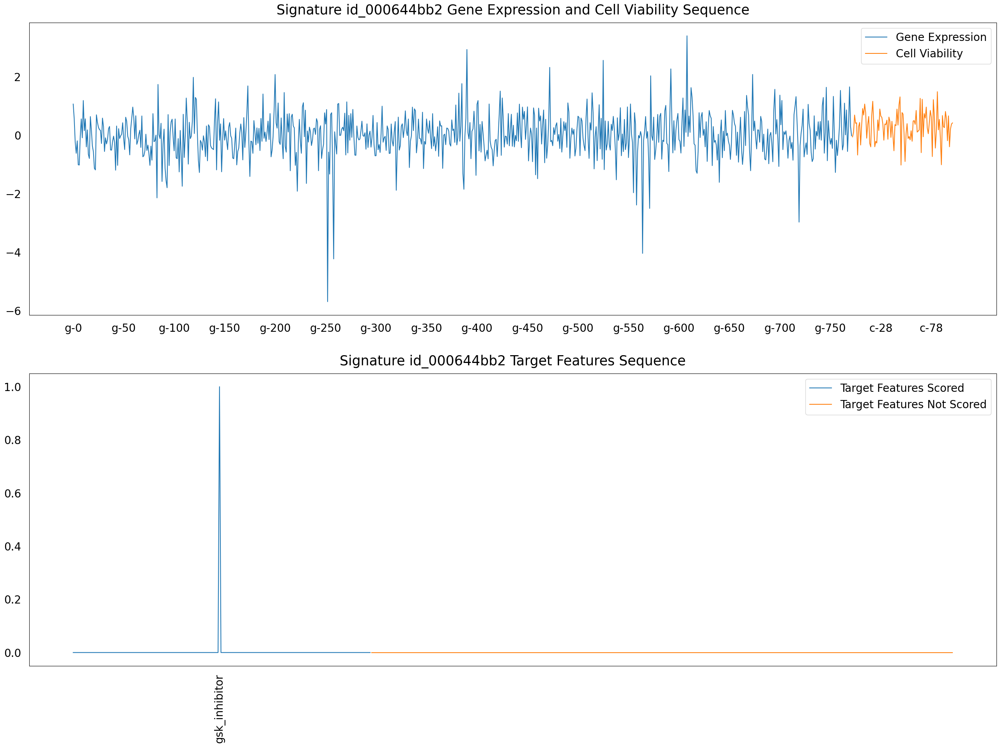

In [51]:
plot_signature('id_000644bb2')

To sum up, statistical features calculated on signature sequences may yield hidden information about targets. There might be connections between cell viability/gene expression difference and number of classified targets. Those types of engineered features are definitely worth trying.